# Explaining ANN (Classification) to identify depression

## Import all necessary libraries

Of the following imports, the most important libraries are: sklearn.neural_network and sklearn.metrics.

In [1]:
import joblib
import dice_ml
import shap
import lime
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from operator import itemgetter
from sklearn.model_selection import train_test_split, cross_val_score
from explainerdashboard import ClassifierExplainer
from sklearn.metrics import ConfusionMatrixDisplay, precision_recall_fscore_support, classification_report
from sklearn.metrics import confusion_matrix, accuracy_score, mean_squared_error
from sklearn.neural_network import MLPClassifier
from imblearn.over_sampling import SMOTE
from alibi.explainers.ale import ALE, plot_ale

## Defining global variables

The following variables defined below can be modified according to the given approach.

In [2]:
## The dataset is defined with the model to explain.
path_dataset = "Dataset_MO_ENG.csv"

## The dataset with the expected responses is defined.
path_dataset_qa = "Dataset_QA_ENG.csv"

## The column, shape and grouping name of the dataset to be explained are defined.
grouping_name = 'Target' # *
class_dic = {1: 0 , 2: 0, 3:1, 4:2, 5:2}

## * If this data is None or empty string then class_dic will be ignored.

## The class names present in the dataset to be explained are defined.
target_names = ["Low", "Medium", "High"] # *

## * If grouping_name is None or empty, then a class name must exist.
##   If not, then the total class name must agree with the total groupings defined in class_dic.

## The class names present in the dataset to be plotted are defined.
name_class = ["Class Low", "Class Medium", "Class High"] # *

## * If grouping_name is None or empty, then a class name must exist.
##   If not, then the total class name must agree with the total groupings defined in class_dic.

## The questions to exclude from the dataset are defined.
unrelated_questions = [102, -1] # *

## * If this data is an empty list then this data will be ignored.

## The list of questions eliminated at the start of the first iteration is defined.
list_contr = [3, 4, 5, 14, 21, 24, 25, 26, 27, 29, 30, 32, 48, 49, 51, 54, 55,
              58, 59, 60, 62, 63, 66, 68, 70, 75, 78, 83, 85, 86, 87, 89, 90,
              91, 94, 95, 96, 98, 100, 101]

## The regular and alpha parameters of the training are defined.
regul_param_normal = 10.0 ** - np.arange(-2, 7)
regul_param_alpha = 10.0 ** - np.arange(0, 7)

## The alpha, ramdon state and learning rate init training parameters are defined for each iteration.
learning_rate_init = 0.1
random_state_model = 42
alpha = 0.001

## Positive and negative threshold values are defined for the slope qualification process.
positive_threshold = 0.01
negative_threshold = -0.01

## The qualification mode of each answer obtained is defined.
selection_mode = 1 # *

## * The following modes are available for the qualification the answers present in the dataset:
##
##     1. Selection of a single class.
##     2. Selection of multiple classes with OR type condition.
##     3. Selection of multiple classes with AND type condition.
##     4. Selection of multiple classes with AND type condition when they are inside the.

## The position of the class to qualify is defined.
select_class_mode = 2 # *

## * Position is related to the number of classes present in target_names and is required only when
##   selection_mode is set to 1.

## The positions of the classes to qualify are defined.
selection_class = [0, 2] # *

## * Positions are related to the number of classes present in target_names and is required only when
##   selection_mode is set to 2, 3 and 4.

## The map of expected responses is defined.
expected_response_map = [[0, 1, 0, 1], [1, 0, 1, 0]] # *
## * A two-dimensional list is defined, where each element of is a list of 4 numerical elements limited
##   to 0 and 1. The number of elements of this is given by the number of classes to qualify.
## 
##   The 4 numerical elements must meet the following conditions:
##
##       Element 1. Rating is 1 and expected response is 0.
##       Element 2. Score is 1 and expected response is 1.
##       Element 3. Rating is 0 and expected response is 1.
##       Element 4. Rating is 0 and expected response 0.

## Defining private variables

The following variables defined below cannot be modified since they are an integral part of its operation.

In [3]:
## The datasets for storing the auxiliary data are defined.
path_dataset_qs = "Dataset_QS_ENG.csv"
path_dataset_qd= "Dataset_QD_ENG.csv"

## The oversample function used is defined.
random_state = 13
oversample = SMOTE(random_state = random_state)

## The seed used for training the neural network is defined.
seed = 1

## The number of iterations performed in the explanation is defined.
iteration = 0

## The names of the explanation methods used are defined.
name_methods = ["Importance", "LIME", "SHAP", "ALE"]

## Preparing the data for the neural network

The data is prepared in order to be processed by the neural network.

In [4]:
## Loading data from the dataset.
df = pd.read_csv(path_dataset)

## Elimination of unrelated questions from the dataset.
if len(unrelated_questions) != 0:
    df = df.drop(df.columns[unrelated_questions[0]:unrelated_questions[1]], axis=1)

## Grouping of the target according to the defined dictionary.
if grouping_name != None and grouping_name != '':
    df[grouping_name] = df[grouping_name].map(class_dic)

## Assignment of local variables according to the data necessary for the neural network.
train_cols = df.columns [0:-1]
label = df.columns [-1]
X = df [train_cols]
y = df [label]

## Generation of the question status list automatically.
question = list(range(1, df.shape[1]))
status = ['In use' for _ in range(1, df.shape[1])]
ds = pd.DataFrame({'Question': question, 'Status': status})

## Save the changed statuses in the dataset.
ds.to_csv(path_dataset_qs, index = False)

## Generation of the data structure by iteration automatically.
dd = pd.DataFrame(columns = ['Question', 'Acurracy global',
                             'Precision_0', 'Recall_0', 'F1_score_0',
                             'Support_0', 'Precision_1', 'Recall_1',
                             'F1_score_1', 'Support_1', 'Precision_2',
                             'Recall_2', 'F1_score_2', 'Support_2'])

## Save the changed dates in the dataset.
dd.to_csv(path_dataset_qd, index = False)

## The prepared data of the dataset is printed.
df

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,3. My friends or family have told me that I look different,4. When I think about the future it is difficult for me to imagine it clearly,5. People around me often ask me how I feel,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,"9. If I had the chance, I would spend all day in my bed",10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,...,94. I lose control easily,95. Neighbors must put up with each other's noises without complaining,96. Littering on public roads is wrong,97. People who commit crimes have their reasons for doing it,98. It is normal to change jobs several times a year,99. It is important to respect turns,100. I could pretend to be someone else to achieve what I want,101. I consider it important that all people have the same rights,"102. I have a hard time taking ""no"" for an answer",Target
0,1,1,0,1,0,1,1,1,0,0,...,1,1,0,0,1,0,1,0,1,0
1,1,0,1,1,0,1,1,1,0,0,...,0,1,0,0,1,0,1,1,0,0
2,0,0,0,0,1,1,1,0,0,1,...,0,1,0,0,1,0,1,0,1,1
3,0,0,0,1,0,1,1,1,1,0,...,0,1,0,1,1,0,1,0,1,2
4,1,1,0,1,0,1,0,1,1,1,...,0,1,0,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,1,1,1,0,0,1,1,1,0,1,...,0,1,1,1,1,1,1,0,1,2
100,1,1,0,0,1,1,1,0,0,0,...,0,1,0,1,1,0,0,0,0,1
101,0,0,1,1,1,1,1,0,1,1,...,0,1,0,0,1,1,1,1,1,0
102,1,0,0,0,1,1,1,1,1,1,...,0,1,1,0,1,0,1,1,0,2


## Oversample application

An oversample process is applied to level the amount of existing data given by the grouping.

In [5]:
## The number of elements present in the grouped target is printed.
y.value_counts()

0    39
1    35
2    30
Name: Target, dtype: int64

Oversample application.

In [6]:
## Application of the oversample to the prepared data.
X, y = oversample.fit_resample(X, y)

Printing of the data after the application of the oversample.

In [7]:
## The results obtained after applying the oversample are printed.
y.value_counts()

0    39
1    39
2    39
Name: Target, dtype: int64

## Preparation of the parameters of the neural network

We proceed to define the parameters necessary for the training of the neural network.

In [8]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=seed)

## Neural network training

The alpha parameters and the initial learning rate are adjusted to obtain the best performance with the model
using cross validation.

In [9]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_normal

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = regul_param, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.16659498207885304,
  0.16659498207885304,
  0.4763355552829237,
  0.4513935101705999,
  0.46248242125951106,
  0.4691799342728135,
  0.4691799342728135,
  0.4691799342728135,
  0.4691799342728135],
 [0.006020651927912844,
  0.006020651927912844,
  0.09918844066715299,
  0.08068804784278276,
  0.09270871998125078,
  0.08309589200633044,
  0.08309589200633044,
  0.08309589200633044,
  0.08309589200633044])

We proceed to draw the learning curve graph according to the data obtained by the training.

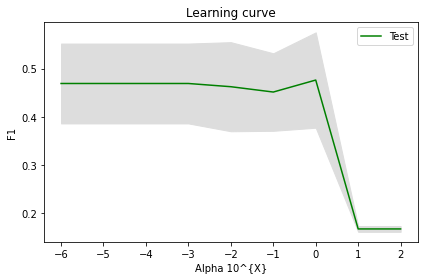

In [10]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Alpha 10^{X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

The training is performed again keeping the same parameters except for the alpha value that changes to 1.

In [11]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_alpha

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = regul_param, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.16659498207885304,
  0.46703181808444966,
  0.45220030972352954,
  0.4405739461776614,
  0.4763355552829237,
  0.16659498207885304,
  0.16659498207885304],
 [0.006020651927912844,
  0.0700006268704352,
  0.09521251410308869,
  0.0887293445552907,
  0.09918844066715299,
  0.006020651927912844,
  0.006020651927912844])

We proceed to draw the learning curve graph according to the data obtained by the training.

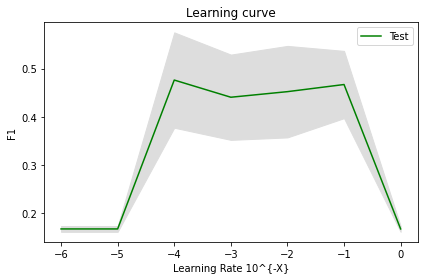

In [12]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Learning Rate 10^{-X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

## Generation of the neural network model

The parameters of the final model are modified according to the data obtained in the training of the neural network.

In [13]:
## The value of the alpha parameter is kept at 1 as well as the value of the seed of random_state at 77.
mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = 77)

## We print the data of the final generated model.
mlp.fit(X_train, y_train)

MLPClassifier(activation='logistic', alpha=1, hidden_layer_sizes=(10,),
              learning_rate_init=0.0001, max_iter=100000, random_state=77)

We safeguard the final generated model

In [14]:
joblib.dump(mlp,"model_depression.pkl")

['model_depression.pkl']

## Generation of the confusion matrix of the model

We obtain the statistics of the final model to generate its confusion matrix.

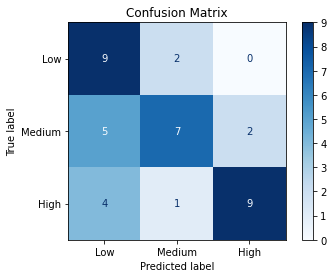

In [15]:
## The data for the generation of the confession matrix are defined.
confusion_matrix = ConfusionMatrixDisplay.from_estimator(mlp, X_test, y_test, display_labels = target_names,
                                                         cmap = plt.cm.Blues)
confusion_matrix.ax_.set_title("Confusion Matrix")
plt.show()

We get the detailed statistics of the final model.

In [16]:
## The necessary detailed prediction is generated.
y_pred = mlp.predict(X_test)

## The detailed statistics of the model are printed.
print('Classification accuracy =',accuracy_score(y_test,y_pred) * 100,'%\n')
print(classification_report(y_test,y_pred))

Classification accuracy = 64.1025641025641 %

              precision    recall  f1-score   support

           0       0.50      0.82      0.62        11
           1       0.70      0.50      0.58        14
           2       0.82      0.64      0.72        14

    accuracy                           0.64        39
   macro avg       0.67      0.65      0.64        39
weighted avg       0.69      0.64      0.64        39



## Model explainability process

The data used for the test of the neural network model is shown.

In [17]:
X_test

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,3. My friends or family have told me that I look different,4. When I think about the future it is difficult for me to imagine it clearly,5. People around me often ask me how I feel,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,"9. If I had the chance, I would spend all day in my bed",10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,...,93. People steal because they have needs,94. I lose control easily,95. Neighbors must put up with each other's noises without complaining,96. Littering on public roads is wrong,97. People who commit crimes have their reasons for doing it,98. It is normal to change jobs several times a year,99. It is important to respect turns,100. I could pretend to be someone else to achieve what I want,101. I consider it important that all people have the same rights,"102. I have a hard time taking ""no"" for an answer"
69,1,0,1,1,0,1,1,0,0,0,...,0,0,1,0,0,1,0,1,0,1
46,1,0,0,0,0,1,1,1,0,1,...,0,0,1,1,0,1,0,1,0,1
58,0,0,0,0,0,1,1,1,0,0,...,0,0,1,0,0,1,0,1,0,1
114,1,0,1,0,0,0,1,0,0,1,...,0,0,1,0,0,1,0,1,1,1
73,0,0,1,0,0,1,1,1,0,1,...,0,0,1,1,0,1,1,1,1,1
98,1,0,1,1,1,0,1,1,0,1,...,0,0,1,0,0,1,0,1,1,1
31,0,0,0,1,1,1,1,0,0,0,...,0,1,1,1,0,1,0,1,0,1
53,1,0,1,1,1,1,1,1,0,1,...,0,0,1,0,0,1,0,1,1,1
65,0,0,0,1,1,1,1,1,1,0,...,0,0,1,1,0,1,0,1,0,1
96,0,0,1,0,0,1,1,1,1,1,...,0,0,1,0,0,1,0,1,1,1


## Explanation of the model using ALE

In analysis of the model through the results obtained by ALE, it is possible to identify the behavior of the neural network.

In [18]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

The graphs of all the data present in the dataset used are shown.

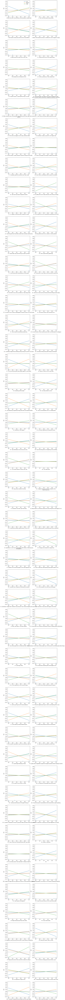

In [19]:
plot_ale(proba_exp_lr, n_cols=2, features=list(range(df.shape[1]-1)),fig_kw={'figwidth': 10, 'figheight': 180});

## Explanation of the model using LIME

We proceed to explain the improved model using LIME for the Low, Medium and High classes.

In [20]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                   feature_names=train_cols, class_names=target_names, 
                                                   discretize_continuous=True)

The first individual present in the test data is explained.

In [21]:
exp = explainer.explain_instance(X_test.to_numpy()[0], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The second individual present in the test data is explained.

In [22]:
exp = explainer.explain_instance(X_test.to_numpy()[1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The last individual present in the test data is explained.

In [23]:
exp = explainer.explain_instance(X_test.to_numpy()[-1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


## Explanation of the model using SHAP

SHAP explanatory values are displayed according to the class to which the selected individual belongs according to the prediction of the model.

The first individual present in the test data is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

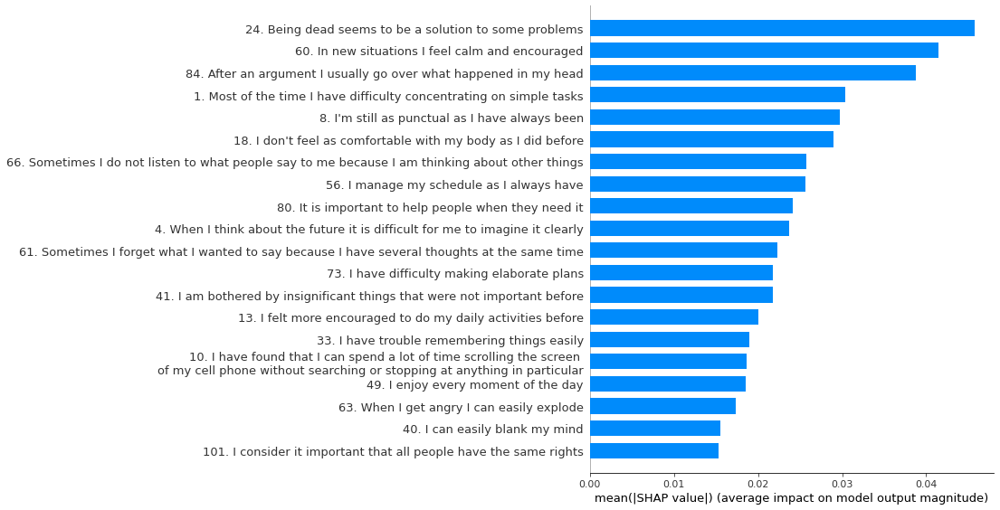

In [24]:
## Individual Selection.
individual = X_test.iloc[[0]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The second individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

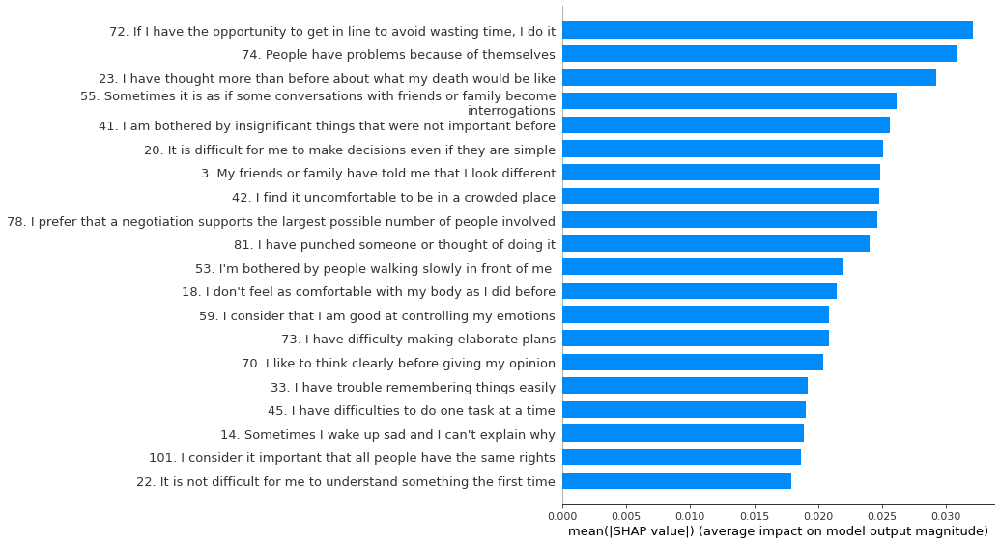

In [25]:
## Individual Selection.
individual = X_test.iloc[[1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The last individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

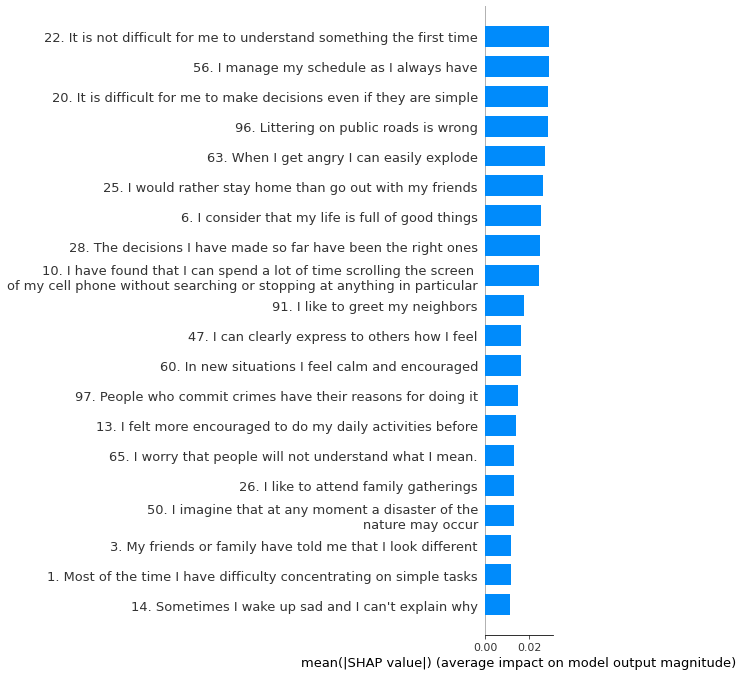

In [26]:
## Individual Selection.
individual = X_test.iloc[[-1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

## Explanation using heatmaps

The importance of the data present in the neural network is shown from explanation methods.

In [27]:
## The question status dataset is loaded.
ds = pd.read_csv(path_dataset_qs)

## Questions currently in use are retrieved.
ds_item = ds[ds.Status == "In use"].reset_index(drop=True)

## The data is prepared for the generation of heat maps.
column_Map = ds_item['Question'].tolist()
content_Map = [False for x in range(1, df.shape[1])]

## The next questions to be deleted will be marked.
for index in range(0, len(content_Map)):
    
    if iteration == 0:
        for delete in list_contr:
            if column_Map[index] == delete:
                content_Map [index] = True
    else:
        for delete in question_anomaly:
            if column_Map[index] == delete:
                content_Map [index] = True

## The dataframe is created with the prepared data.
df_mask = pd.DataFrame([content_Map], columns = column_Map)
df_mask_imp = pd.concat([df_mask, df_mask, df_mask], ignore_index = True, axis = 0)
df_mask_all = pd.concat([df_mask, df_mask, df_mask, df_mask], ignore_index = True, axis = 0)

df_mask

,1,2,3,4,5,6,7,8,9,10,...,93,94,95,96,97,98,99,100,101,102
0,False,False,True,True,True,False,False,False,False,False,...,False,True,True,True,False,True,False,True,True,False


### Identification of important variables

Identification of important variables from the randomness of the answers as questions of the data.

In [28]:
## Loading the data for explainability.
explainer = ClassifierExplainer(mlp, X_test, y_test)

## Class index local variable.
iterable_class = -1
map_class = []

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')


### Explainability of the data belonging to the first class, in this case the Low.

Calculating permutation importances (if slow, try setting n_jobs parameter)...


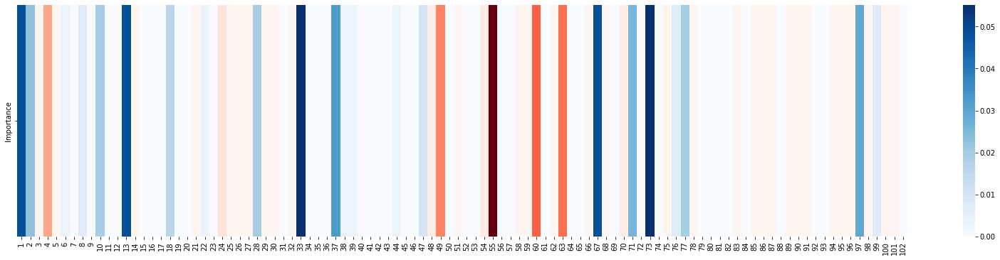

In [29]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

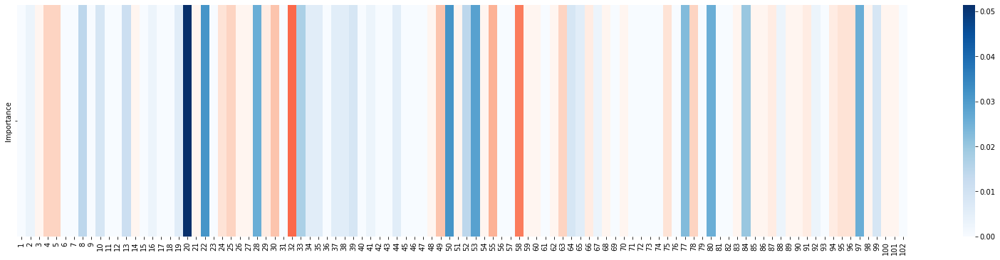

In [30]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

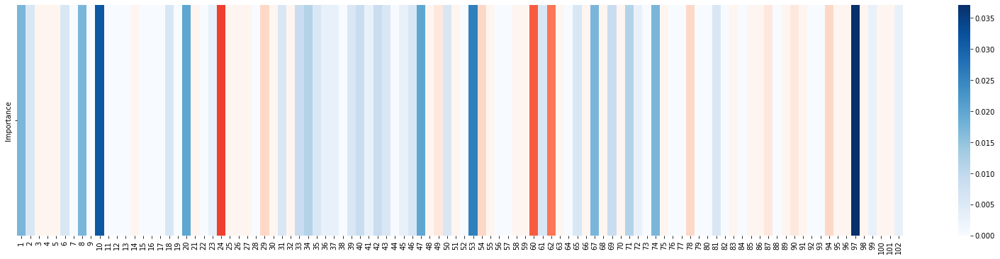

In [31]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

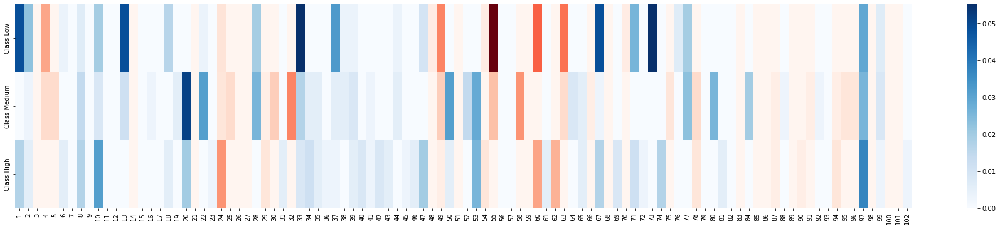

In [32]:
## Fusion of the previous heat maps.
df_importance = pd.concat(map_class, axis=1)
df_importance.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_importance.transpose(), cmap = "Reds", cbar = False)
sns.heatmap(df_importance.transpose(), cmap = "Blues",yticklabels = True, xticklabels = True ,mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using SHAP

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of SHAP.

In [33]:
## Class index local variable.
iterable_class = -1
map_class = []

### Individual explainability of the data belonging to the first class, in this case the Low.

Definition of explainability data.

In [34]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Calculating shap values...


  0%|          | 0/39 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

Generation of the heat map.

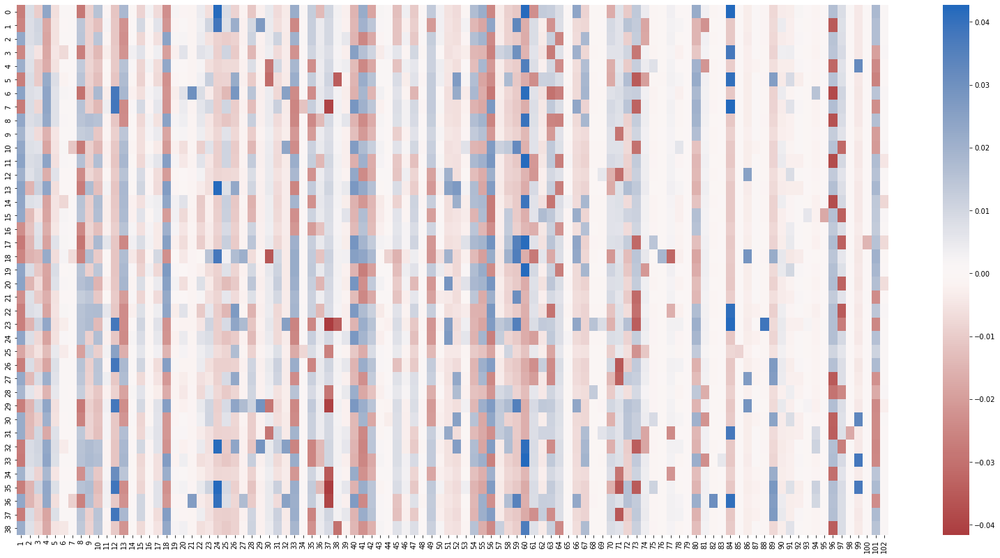

In [35]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [36]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

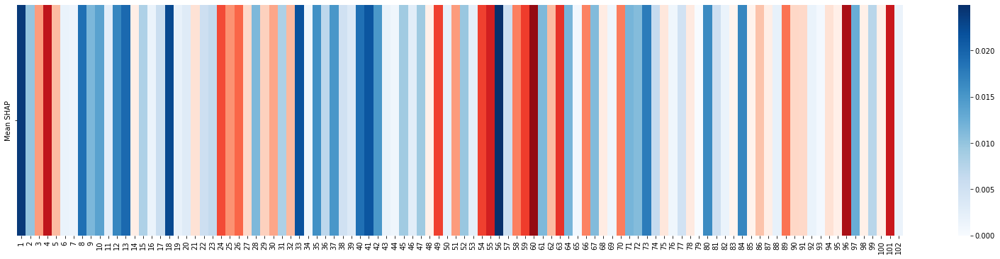

In [37]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Definition of explainability data.

In [38]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

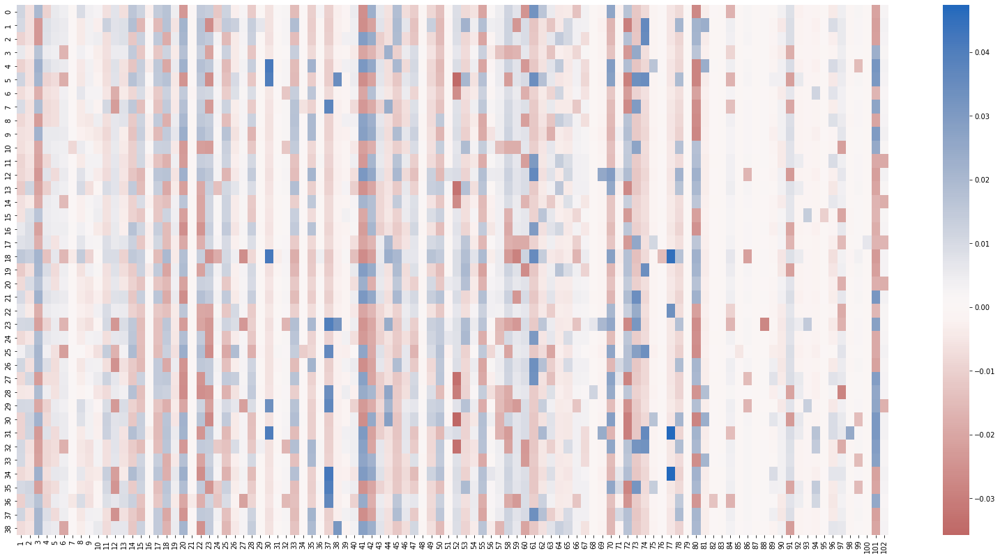

In [39]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [40]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

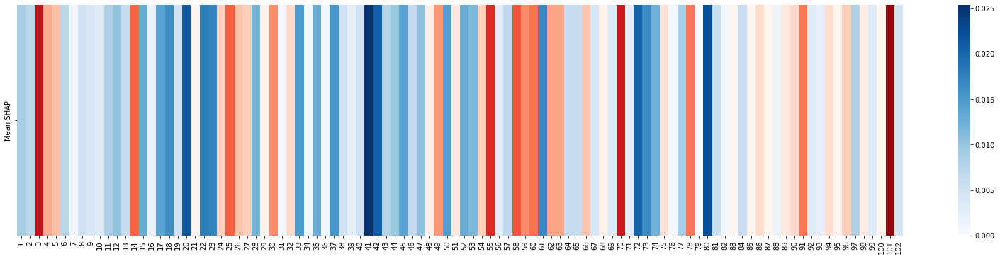

In [41]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Definition of explainability data.

In [42]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

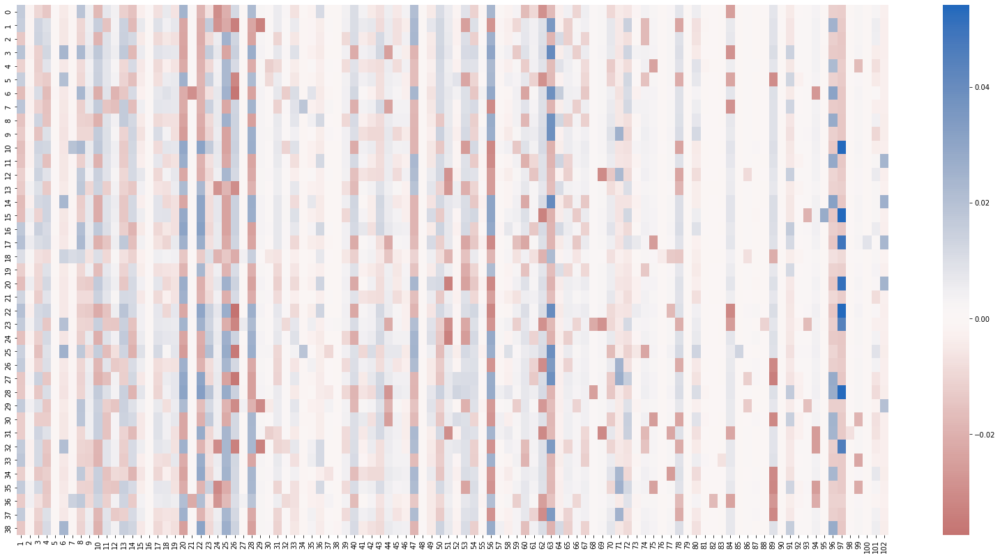

In [43]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [44]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

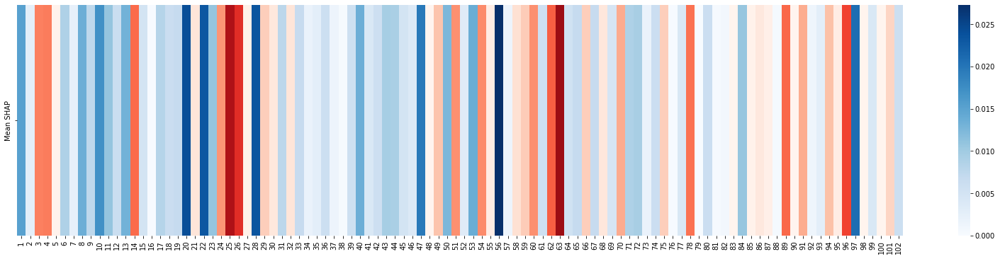

In [45]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

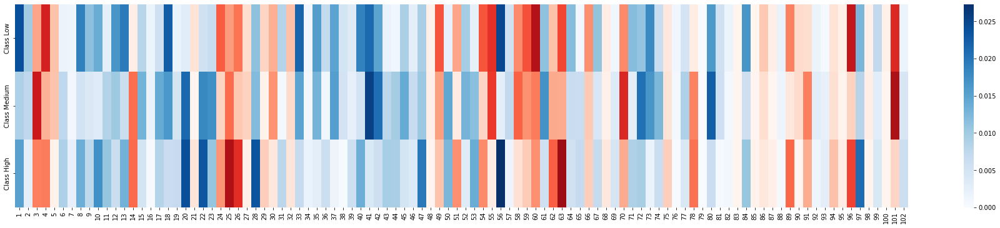

In [46]:
## Fusion of the previous heat maps.
df_shap = pd.concat(map_class, axis=1)
df_shap.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_shap.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_shap.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using LIME

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of LIME.

In [47]:
## Data preparation for explainability.
lime_exp = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                  feature_names=train_cols, class_names=target_names,
                                                  discretize_continuous=True)

## Class index local variable.
iterable_class = -1
map_class = []

Obtaining the data for the generation of the explanations by LIME about the Low, Medium and High classes.

In [48]:
## Local variables for LIME array data.
exp_matrix = [[] for _ in range(len(name_class))]

## Recovering the data needed for LIME.
for x in X_test.to_numpy():
    
    ## Auxiliary temporary variables.
    exp_list = [[] for _ in range(len(name_class))]
    
    ## Loading the data for explainability.
    exp = lime_exp.explain_instance(x, mlp.predict_proba, num_features = df.shape[1] - 1, top_labels = len(name_class))
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
        temp = exp.as_map()[elements]
        temp.sort(key=itemgetter(0))
        
        ## Saving data of the Low, Medium and High classes.
        for tup in temp:
            exp_list[elements].append(tup[1])
            
        exp_matrix[elements].append(exp_list[elements])

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

### Individual explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

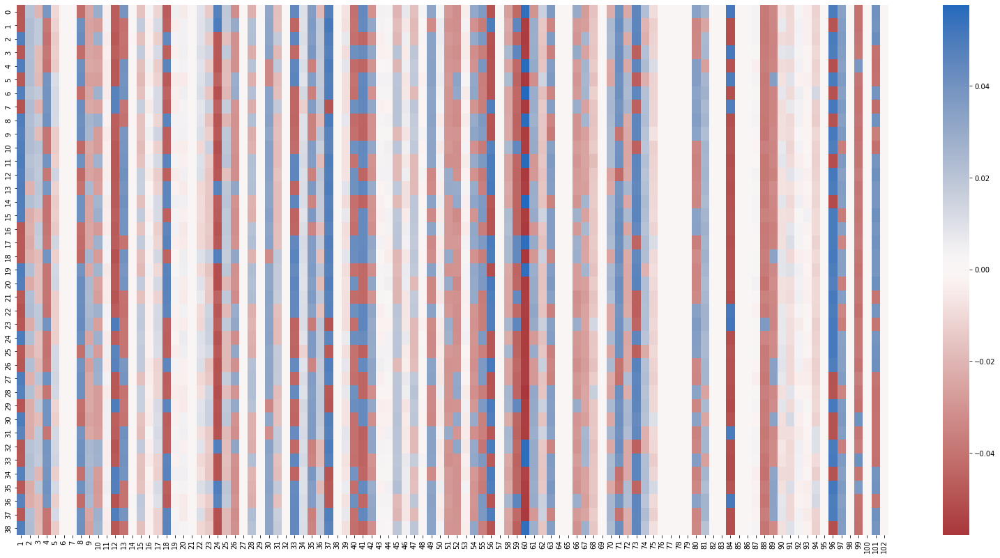

In [49]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

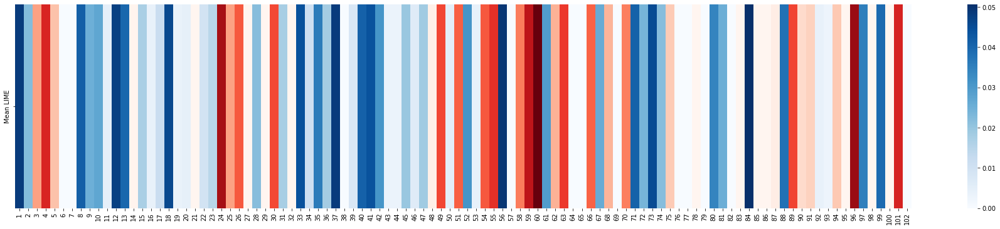

In [50]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

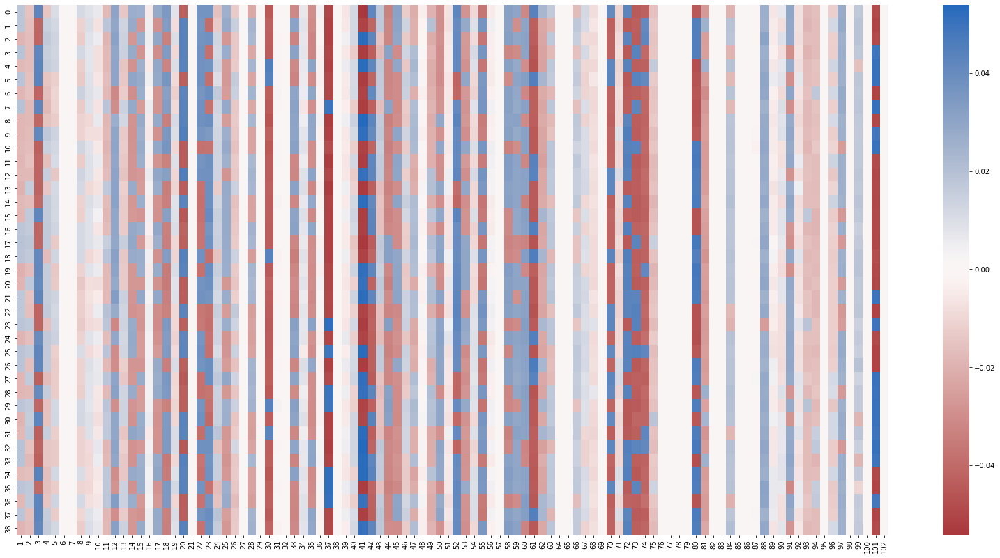

In [51]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

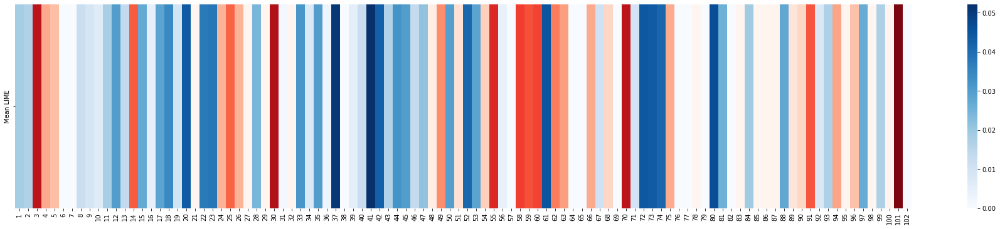

In [52]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Generation of the heat map.

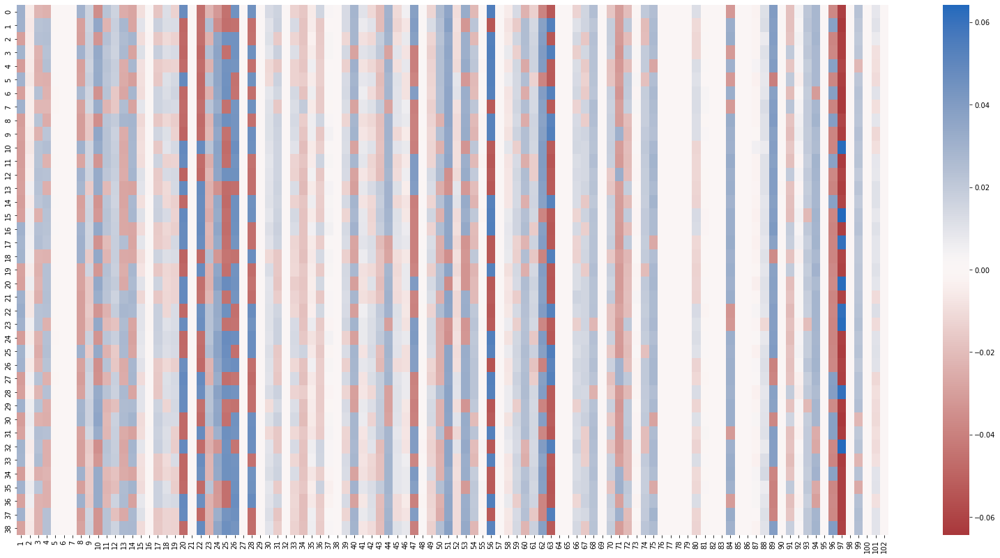

In [53]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

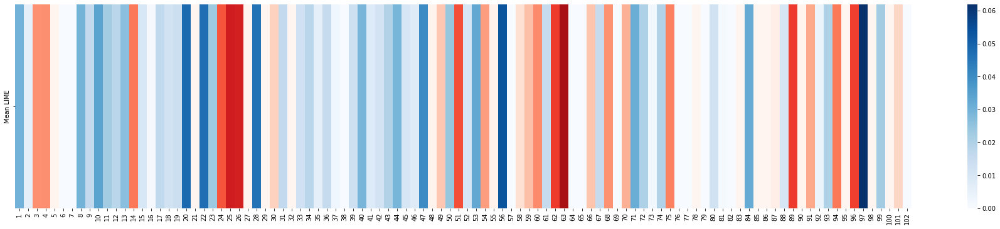

In [54]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

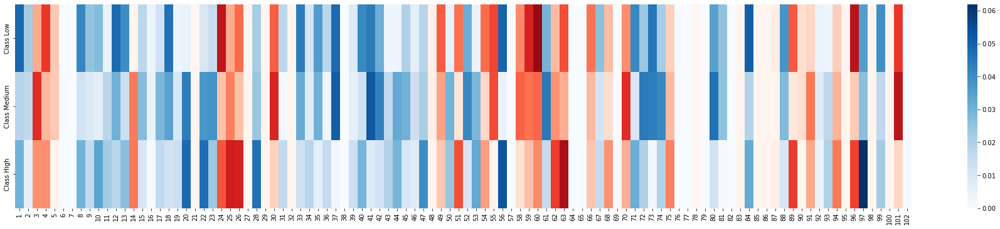

In [55]:
df_lime = pd.concat(map_class, axis=1)
df_lime.columns = name_class
plt.figure(figsize = (32,6))
sns.heatmap(df_lime.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_lime.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using ALE

It shows the main effect of each question compared to the probability that the model predicts in each class. This effect is shown for both responses. Since there are only 2 answers, the map is the same but with the colors reversed.

In [56]:
## Definition of explainability data.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names=train_cols, target_names= target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

## Class index local variable.
iterable_class = -1
map_class = []

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

Obtaining the data for the generation of the explanations by ALE about the all classes.

In [57]:
## Local variables for ALE array data.
ale_list = [[] for _ in range(len(name_class))]

## Recovering the data needed for ALE.
for array in proba_exp_lr.ale_values:
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
    
        ## Saving data of the all classes.
        ale_list[elements].append(array[0][elements])

Data processing for the explainability of ALE.

In [58]:
## Data processing of the Low, Medium and High classes.
for elements in range(0, len(name_class)):
    ale_df = pd.DataFrame([ale_list [elements]])
    ale_df = pd.concat([ale_df.multiply(-1), ale_df])
    ale_df.index = [name_class [elements] + " - False", name_class [elements] + " - True"]
    ale_df.columns = column_Map
    map_class.append(ale_df)

### Explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

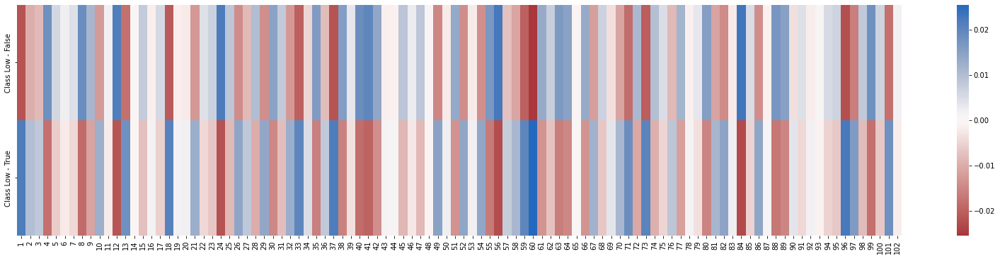

In [59]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

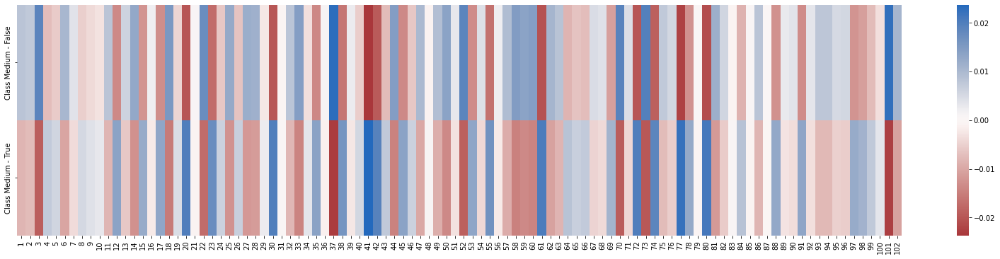

In [60]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

Generation of the heat map.

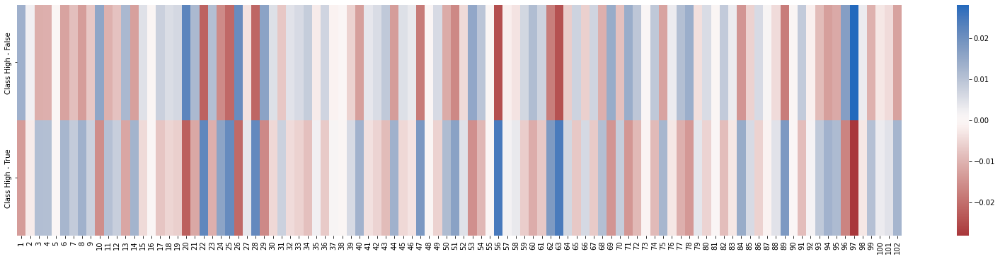

In [61]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used in all classes.

In [62]:
## Application of absolute value to data.
for index in range(0, len(map_class)):
    map_class [index] = map_class [index][0:1].abs()

## Union of the heat maps of the Low, Medium and High class.
ale_df = pd.concat(map_class)
ale_df.index = name_class
ale_df = ale_df.transpose()

Generation of the heat map.

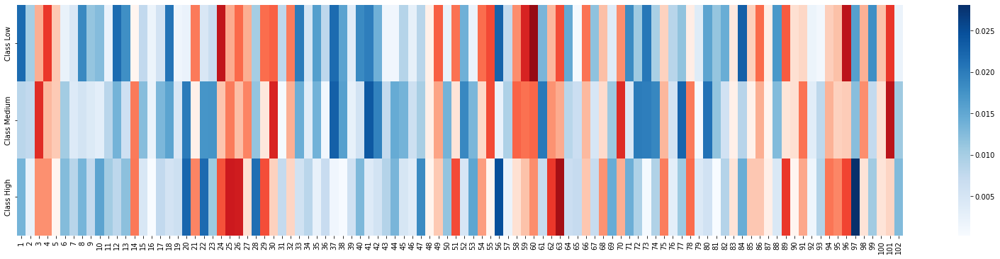

In [63]:
plt.figure(figsize = (28,6))
sns.heatmap(ale_df.transpose(), cmap="Reds", cbar = False)
sns.heatmap(ale_df.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask= df_mask_imp.to_numpy())
plt.show()

## Comparing of Important Variables Methods for Explainability

The global values of each of the methods used are taken, their maximums are obtained (the minimums are 0) and a percentage is calculated based on said maximum, which indicates how relevant the contribution is for each question.

In [64]:
## Class index local variable.
iterable_class = -1

### Comparison of the explanation methods of the first class, in this case the Low.

The highest data of each method used is obtained.

In [65]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [66]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,3,4,5,6,7,8,9,10,...,93,94,95,96,97,98,99,100,101,102
Importance,78.947368,36.842105,0.000000,31.578947,0.000000,5.263158,0.000000,10.526316,0.000000,31.578947,...,0.000000,0.000000,0.000000,0.000000,47.368421,0.000000,10.526316,0.000000,0.000000,0.000000
LIME,86.462690,39.746321,32.855242,70.549062,22.995408,0.000000,0.000000,73.981159,44.540806,48.751249,...,4.784843,20.315858,0.000000,89.612068,63.146212,0.000000,70.307140,0.000000,71.471305,0.000000
SHAP,96.147581,40.214100,35.008488,78.855064,24.948237,6.309069,5.445521,75.374298,45.811841,55.409444,...,2.076655,11.643024,3.554283,85.610304,50.686546,3.283259,28.987923,2.776013,75.414316,6.102751
ALE,85.462751,39.002701,32.360871,70.440617,22.668454,8.642175,17.874580,73.122299,44.364814,48.777919,...,4.182946,20.667385,25.683125,88.110950,62.575925,31.404278,70.372431,25.132478,70.961789,7.647776


Generation of the heat map.

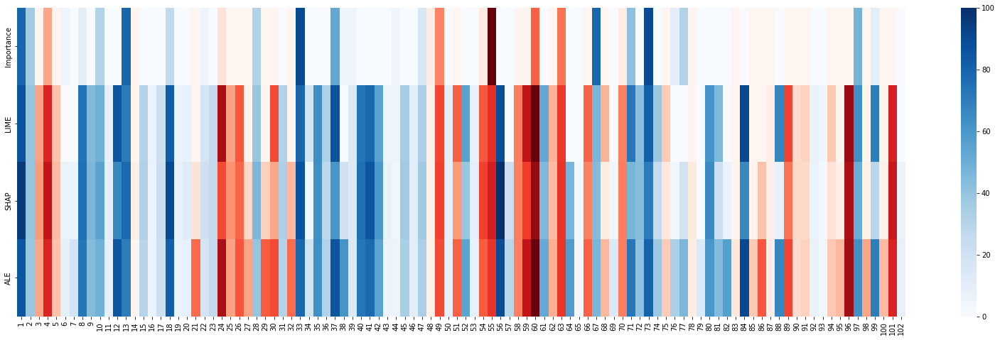

In [67]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the second class, in this case the Medium.

The highest data of each method used is obtained.

In [68]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [69]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,3,4,5,6,7,8,9,10,...,93,94,95,96,97,98,99,100,101,102
Importance,0.000000,5.555556,0.000000,16.666667,16.666667,2.158767e-13,0.000000,27.777778,0.000000,16.666667,...,0.000000,5.555556,11.111111,11.111111,50.000000,0.000000,16.666667,0.00000,0.000000,0.000000
LIME,35.520443,31.807144,80.322334,30.182146,24.163161,0.000000e+00,0.000000,22.745888,16.799549,12.309990,...,32.778340,32.286295,0.000000,23.339592,50.932638,0.000000,32.439528,0.00000,95.519523,0.000000
SHAP,34.733085,29.126592,80.820853,29.907777,23.777466,2.897104e+01,3.447942,20.416582,15.493949,12.772308,...,8.369423,13.666388,1.397220,18.839292,32.148232,4.913348,12.158313,0.91548,91.407169,18.003867
ALE,34.896942,31.896411,80.377192,30.559069,24.028051,4.357354e+01,16.379747,22.148943,16.847569,12.608223,...,33.254627,33.085206,21.400418,22.871133,51.566967,46.416204,31.512057,14.68013,95.638951,44.805218


Generation of the heat map.

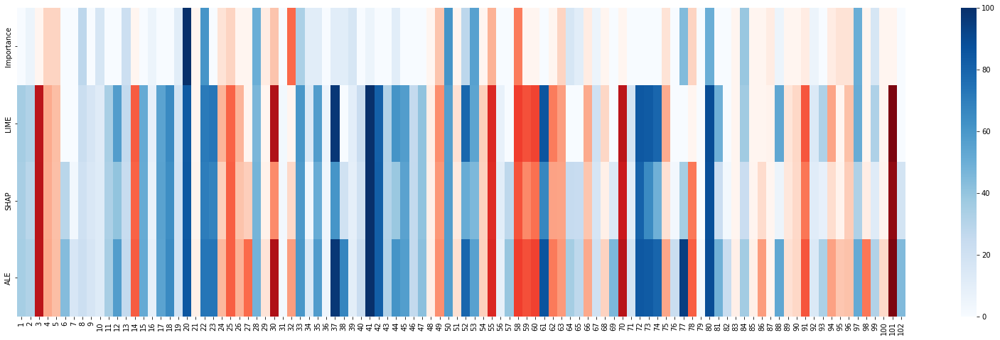

In [70]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the third class, in this case the High.

The highest data of each method used is obtained.

In [71]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [72]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,3,4,5,6,7,8,9,10,...,93,94,95,96,97,98,99,100,101,102
Importance,46.153846,15.384615,0.000000,0.000000,0.000000,15.384615,0.000000,46.153846,0.000000,84.615385,...,0.000000,15.384615,0.000000,0.000000,100.00000,0.000000,7.692308,0.000000,0.000000,7.692308
LIME,48.298815,9.170065,37.911397,38.399537,1.054413,0.000000,0.000000,47.765013,26.142682,54.460474,...,31.926369,45.559979,0.000000,61.403384,100.00000,0.000000,36.280065,0.000000,15.778539,0.000000
SHAP,55.510958,9.609112,43.209716,44.224031,1.852710,32.399540,8.322195,49.860925,27.387863,62.521628,...,9.893831,23.361094,5.218300,60.694496,76.19504,1.150085,15.176115,1.024627,16.140494,22.262852
ALE,47.983663,8.465188,38.323466,38.038633,0.302390,44.471190,29.952344,47.539284,25.975384,54.744850,...,31.756486,46.530962,41.241407,60.495255,100.00000,10.623676,37.175348,10.394883,16.230041,44.607341


Generation of the heat map.

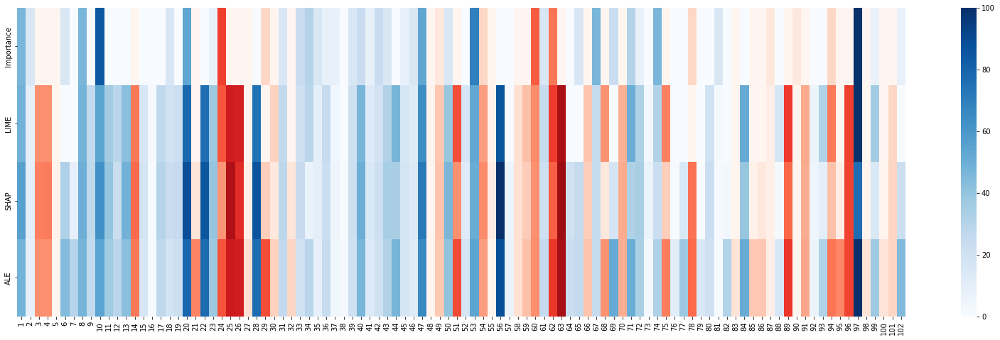

In [73]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

## Neural network model improvement iterative process

From this moment, we proceed to improve the performance of the neural network to predict high depression.

## Iteration 1

The first iteration of improvement of the model is carried out.

## Preparing the data for the neural network

The data is prepared in order to be processed by the neural network.

In [74]:
## The iteration number is increased.
iteration += 1

## Loading data from the dataset.
df = pd.read_csv(path_dataset)
ds = pd.read_csv(path_dataset_qs)

## Elimination of unrelated questions from the dataset.
if len(unrelated_questions) != 0:
    df = df.drop(df.columns[unrelated_questions[0]:unrelated_questions[1]], axis=1)

i = 0
if iteration == 1:
    ## Elimination of list of conflicting questions declared in global variables.
    for x in list_contr:
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1
        ## Status change of the deleted question in the respective auxiliary dataset.
        ds.loc[x - 1,'Status'] = 'Delete'
    
else:    
    ## Elimination of the list of anomadic questions defined in the improvement process.
    ds_delete = ds[ds.Status == "Delete"].reset_index(drop=True)
    for x in ds_delete['Question'].tolist():
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1

## Grouping of the target according to the defined dictionary.
if grouping_name != None and grouping_name != '':
    df[grouping_name] = df[grouping_name].map(class_dic)

## Assignment of local variables according to the data necessary for the neural network.
train_cols = df.columns [0:-1]
label = df.columns [-1]
X = df [train_cols]
y = df [label]

## The prepared data of the dataset is printed.
df

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,"9. If I had the chance, I would spend all day in my bed",10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,"11. When someone asks me something, I have noticed that I take longer than normal to\nrespond",12. I have noticed my body shaken without any cause,13. I felt more encouraged to do my daily activities before,...,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,88,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns,"102. I have a hard time taking ""no"" for an answer",Target
0,1,1,1,1,1,0,0,1,0,0,...,0,1,0,1,0,0,0,0,1,0
1,1,0,1,1,1,0,0,0,0,1,...,0,1,1,0,0,0,0,0,0,0
2,0,0,1,1,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,1,1
3,0,0,1,1,1,1,0,0,0,1,...,0,1,0,0,1,0,1,0,1,2
4,1,1,1,0,1,1,1,1,1,0,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,1,1,1,1,1,0,1,1,1,1,...,1,1,0,1,1,0,1,1,1,2
100,1,1,1,1,0,0,0,1,0,1,...,0,1,0,0,0,0,1,0,0,1
101,0,0,1,1,0,1,1,0,0,1,...,0,1,1,0,1,0,0,1,1,0
102,1,0,1,1,1,1,1,1,0,0,...,0,1,1,0,1,0,0,0,0,2


## Oversample application

An oversample process is applied to level the amount of existing data given by the grouping.

In [75]:
## The number of elements present in the grouped target is printed.
y.value_counts()

0    39
1    35
2    30
Name: Target, dtype: int64

Oversample application.

In [76]:
## Application of the oversample to the prepared data.
X, y = oversample.fit_resample(X, y)

Printing of the data after the application of the oversample.

In [77]:
## The results obtained after applying the oversample are printed.
y.value_counts()

0    39
1    39
2    39
Name: Target, dtype: int64

## Preparation of the parameters of the neural network

We proceed to define the parameters necessary for the training of the neural network.

In [78]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=seed)

## Neural network training

The alpha parameters and the initial learning rate are adjusted to obtain the best performance with the model
using cross validation.

In [79]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_normal

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = regul_param, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.16659498207885304,
  0.19322610764736,
  0.33584807349513235,
  0.4624614446441072,
  0.4712849740558719,
  0.48138800942206517,
  0.48138800942206517,
  0.48138800942206517,
  0.48138800942206517],
 [0.006020651927912844,
  0.06190163786344686,
  0.04574358771581292,
  0.08331624906294144,
  0.07035317262431248,
  0.086614802288128,
  0.086614802288128,
  0.086614802288128,
  0.086614802288128])

We proceed to draw the learning curve graph according to the data obtained by the training.

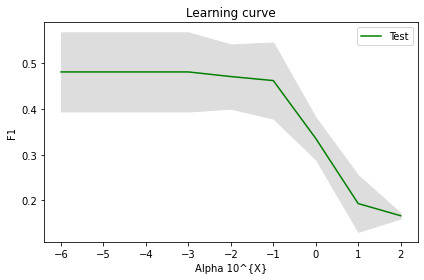

In [80]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Alpha 10^{X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

The training is performed again keeping the same parameters except for the alpha value that changes to 1.

In [81]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_alpha

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = regul_param, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.1632974910394265,
  0.4740513614352624,
  0.4483093256932267,
  0.4577127585177121,
  0.33584807349513235,
  0.16659498207885304,
  0.16659498207885304],
 [0.006619092595549127,
  0.14126534835534385,
  0.1542276089835744,
  0.11392529450516314,
  0.04574358771581292,
  0.006020651927912844,
  0.006020651927912844])

We proceed to draw the learning curve graph according to the data obtained by the training.

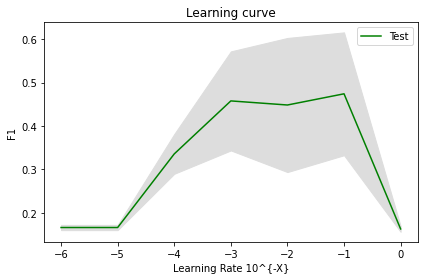

In [82]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Learning Rate 10^{-X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

## Generation of the neural network model

The parameters of the final model are modified according to the data obtained in the training of the neural network.

In [83]:
## The value of the alpha parameter, learning_rate_init and random_state are changed according
## to the data in the global variables.
mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = alpha,
                            learning_rate = 'constant', learning_rate_init = learning_rate_init, max_iter = 100000,
                            random_state = random_state_model)

## We print the data of the final generated model.
mlp.fit(X_train, y_train)

MLPClassifier(activation='logistic', alpha=0.001, hidden_layer_sizes=(10,),
              learning_rate_init=0.1, max_iter=100000, random_state=42)

We safeguard the final generated model

In [84]:
joblib.dump(mlp,"model_depression_i" + str(iteration) + ".pkl")

['model_depression_i1.pkl']

## Generation of the confusion matrix of the model

We obtain the statistics of the final model to generate its confusion matrix.

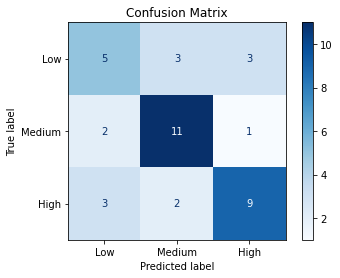

In [85]:
## The data for the generation of the confession matrix are defined.
confusion_matrix = ConfusionMatrixDisplay.from_estimator(mlp, X_test, y_test, display_labels = target_names,
                                                         cmap = plt.cm.Blues)
confusion_matrix.ax_.set_title("Confusion Matrix")
plt.show()

We get the detailed statistics of the final model.

In [86]:
## The necessary detailed prediction is generated.
y_pred = mlp.predict(X_test)

## The detailed statistics of the model are printed.
print('Classification accuracy =',accuracy_score(y_test,y_pred) * 100,'%\n')
print(classification_report(y_test,y_pred))

Classification accuracy = 64.1025641025641 %

              precision    recall  f1-score   support

           0       0.50      0.45      0.48        11
           1       0.69      0.79      0.73        14
           2       0.69      0.64      0.67        14

    accuracy                           0.64        39
   macro avg       0.63      0.63      0.63        39
weighted avg       0.64      0.64      0.64        39



The data obtained is saved for later graphing.

In [87]:
accuracy = accuracy_score(y_test,y_pred) * 100
clf_rep = precision_recall_fscore_support(y_test,y_pred)

## The number of questions used in the iteration is retrieved.
ds_delete = ds[ds.Status == "Delete"]
ds_delete.reset_index(inplace=True, drop=True)

## All the metrics of the confusion matrix are obtained.
metrics = [",".join(map(str, ds_delete['Question'].tolist())), accuracy, clf_rep[0][0], clf_rep[1][0],
           clf_rep[2][0], clf_rep[3][0],clf_rep[0][1], clf_rep[1][1], clf_rep[2][1], clf_rep[3][1],
           clf_rep[0][2], clf_rep[1][2], clf_rep[2][2], clf_rep[3][2]]

## The names of the columns of the dataset are defined.
columns = ['Question','Acurracy global','Precision_0','Recall_0','F1_score_0', 'Support_0',
           'Precision_1','Recall_1','F1_score_1', 'Support_1','Precision_2','Recall_2','F1_score_2','Support_2']

## A new row of the dataset is generated with all the data.
data = pd.DataFrame([metrics], columns = columns)

## The data is saved to the dataset.
data.to_csv(path_dataset_qd, mode = 'a', header = False, index = False)

## The data added to the dataset is printed.
data

,Question,Acurracy global,Precision_0,Recall_0,F1_score_0,Support_0,Precision_1,Recall_1,F1_score_1,Support_1,Precision_2,Recall_2,F1_score_2,Support_2
0,"3,4,5,14,21,24,25,26,27,29,30,32,48,49,51,54,5...",64.102564,0.5,0.454545,0.47619,11,0.6875,0.785714,0.733333,14,0.692308,0.642857,0.666667,14


## Improvement process of the neural network model.

The application of the explanation method by ALE allows to determine the behavior of the neural network and thereby improve it by discarding non-significant data for it.

## Slope Analysis of ALE Plots

In [88]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

We proceed to obtain the graphs to obtain the slopes of the selected classes.

In [89]:
## The question metrics dataset is loaded.
dm = pd.DataFrame()

## The number of questions used in the iteration is retrieved.
ds_item = ds[ds.Status == "In use"]
ds_item.reset_index(inplace=True, drop=True)

## We get the slopes from the ALE data.
for i in range(df.shape[1]-1):
    structure_data = {'Question': ds_item.loc[i, "Question"]}
    
    for index in selection_class:
        slope = proba_exp_lr.ale_values [i][1][index] - proba_exp_lr.ale_values [i][0][index]
        structure_data['Slope ' + str(target_names[index])] = slope
        structure_data['Threshold ' + str(target_names[index])] = 'NA'
        structure_data['Anomaly ' + str(target_names[index])] = 'NA'
        
    dm = dm.append(structure_data, ignore_index=True)
    
## The current rating data dataset is printed.
dm

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be remove

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.188073,NA,NA,0.180665,NA,NA
1,2,-0.017648,NA,NA,0.009065,NA,NA
2,6,-0.001497,NA,NA,-0.011459,NA,NA
3,7,-0.007423,NA,NA,0.002598,NA,NA
4,8,0.023104,NA,NA,-0.026986,NA,NA
...,...,...,...,...,...,...,...
57,92,0.006494,NA,NA,-0.007989,NA,NA
58,93,-0.008606,NA,NA,0.011228,NA,NA
59,97,-0.247825,NA,NA,0.294782,NA,NA
60,99,0.196822,NA,NA,-0.146336,NA,NA


## Slope analysis and threshold application

The slope obtained is analyzed and those that are above or below the positive and negative threshold are selected.

In [90]:
for i in range(df.shape[1]-1):
    for index in selection_class:
        
        ## The slopes are selected according to the values of the thresholds of the defined classes.
        if dm.loc[i, "Slope " + str(target_names[index])] >= positive_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 1
        elif dm.loc[i, "Slope " + str(target_names[index])] <= negative_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 0
            
## The current rating data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.188073,0,NA,0.180665,1,NA
1,2,-0.017648,0,NA,0.009065,NA,NA
2,6,-0.001497,NA,NA,-0.011459,0,NA
3,7,-0.007423,NA,NA,0.002598,NA,NA
4,8,0.023104,1,NA,-0.026986,0,NA
...,...,...,...,...,...,...,...
57,92,0.006494,NA,NA,-0.007989,NA,NA
58,93,-0.008606,NA,NA,0.011228,1,NA
59,97,-0.247825,0,NA,0.294782,1,NA
60,99,0.196822,1,NA,-0.146336,0,NA


## Analysis and determination of anomalous questions

The anomalous questions present in the model are determined based on their slope and expected response from the expert.

In [91]:
## The dataset of expected responses is loaded.
da = pd.read_csv(path_dataset_qa)

## Delete list of questions deleted in this iteration.
i = 0
for x in ds_delete['Question']:
    da.drop(da.index[x - (i + 1)], axis = 0, inplace = True)
    i += 1

## Indexes are restored for later use.
da.reset_index(inplace=True, drop=True)

## The dataset of expected responses is printed.
da

,Numero,Pregunta,RE
0,1,La mayor parte del tiempo tengo dificultad par...,1
1,2,No siento ganas de hacer mis deberes cotidianos,1
2,6,Considero que mi vida está llena de cosas buenas,0
3,7,Mis aficiones siguen siendo importante,0
4,8,Sigo siendo tan puntual como siempre he sido,0
...,...,...,...
57,92,No me parece grave tener algunas deudas,1
58,93,La gente roba porque tiene necesidades,1
59,97,La gente que comete crímenes tiene sus razones...,1
60,99,Es importante respetar los turnos,0


We proceed to identify the anomadic questions present in the model present in this iteration.

In [92]:
for i in range(df.shape[1]-1):
    
    ## Local variable to indicate the index of the selected classes.
    i_index = 0
    
    for index in selection_class:
        
        ## Determine if it fails based on the expected response parameters of the defined classes.
        if dm.loc[i, "Threshold "  + str(target_names[index])] == 1 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][0]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 1 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][1]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][2]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly "  + str(target_names[index])] = expected_response_map[i_index][3]
        
        ## Increase of the index of the selected classes.
        i_index += 1

## The final grade data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.188073,0,0,0.180665,1,0
1,2,-0.017648,0,0,0.009065,NA,NA
2,6,-0.001497,NA,NA,-0.011459,0,0
3,7,-0.007423,NA,NA,0.002598,NA,NA
4,8,0.023104,1,0,-0.026986,0,0
...,...,...,...,...,...,...,...
57,92,0.006494,NA,NA,-0.007989,NA,NA
58,93,-0.008606,NA,NA,0.011228,1,0
59,97,-0.247825,0,0,0.294782,1,0
60,99,0.196822,1,0,-0.146336,0,0


## Removing identified anomadic questions from the model

We proceed to eliminate the identified anomadic questions so as not to use them in the next iteration.

In [93]:
## Local variable for the elimination of the anomaly questions.
instructions = ''
init = False
question_anomaly = []

if selection_mode == 1:
    
    ## Questions that fail in the defined class are retrieved.
    dm_delete = dm[dm['Anomaly ' + str(target_names[select_class_mode])] == 1]
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 2:
    
    ## Questions that fail in classes defined with the or condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " or `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 3:
    
    ## Questions that fail in classes defined with the and condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 4:
    
    ## Out-of-threshold questions are retrieved in classes defined with the condition type and.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 'NA'"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 'NA'"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()

## The selected blank questions are printed according to the selection_mode.
question_anomaly

[9, 11, 12, 15, 23, 38, 44, 45, 46, 72, 102]

## Model explainability process

The data used for the test of the neural network model is shown.

In [94]:
X_test

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,"9. If I had the chance, I would spend all day in my bed",10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,"11. When someone asks me something, I have noticed that I take longer than normal to\nrespond",12. I have noticed my body shaken without any cause,13. I felt more encouraged to do my daily activities before,...,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,88,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns,"102. I have a hard time taking ""no"" for an answer"
69,1,0,1,1,0,0,0,0,0,0,...,1,0,1,1,0,0,0,0,0,1
46,1,0,1,1,1,0,1,1,0,1,...,0,1,1,0,0,0,0,0,0,1
58,0,0,1,1,1,0,0,0,0,1,...,0,0,1,0,0,0,0,0,0,1
114,1,0,1,1,1,0,1,1,0,0,...,0,0,1,1,0,0,0,0,0,0
73,0,0,1,1,1,0,1,0,0,0,...,1,1,1,0,0,0,0,0,1,1
98,1,0,0,1,1,0,1,0,0,0,...,1,0,1,1,0,1,0,0,0,1
31,0,0,1,1,0,0,0,0,1,0,...,1,0,1,0,0,0,0,0,0,1
53,1,0,1,1,1,0,1,1,1,1,...,1,0,1,1,0,0,0,0,0,1
65,0,0,1,1,1,1,0,0,0,1,...,1,0,1,0,0,0,0,0,0,1
96,0,0,1,1,1,1,1,0,0,0,...,1,0,1,0,0,0,0,0,0,1


## Explanation of the model using ALE

In analysis of the model through the results obtained by ALE, it is possible to identify the behavior of the neural network.

In [95]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

The graphs of all the data present in the dataset used are shown.

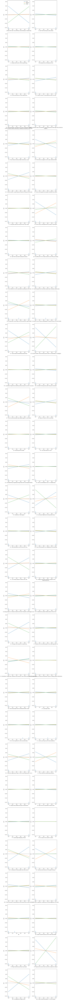

In [96]:
plot_ale(proba_exp_lr, n_cols=2, features=list(range(df.shape[1]-1)),fig_kw={'figwidth': 10, 'figheight': 180});

## Explanation of the model using LIME

We proceed to explain the improved model using LIME for the Low, Medium and High classes.

In [97]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                   feature_names=train_cols, class_names=target_names, 
                                                   discretize_continuous=True)

The first individual present in the test data is explained.

In [98]:
exp = explainer.explain_instance(X_test.to_numpy()[0], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The second individual present in the test data is explained.

In [99]:
exp = explainer.explain_instance(X_test.to_numpy()[1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The last individual present in the test data is explained.

In [100]:
exp = explainer.explain_instance(X_test.to_numpy()[-1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


## Explanation of the model using SHAP

SHAP explanatory values are displayed according to the class to which the selected individual belongs according to the prediction of the model.

The first individual present in the test data is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

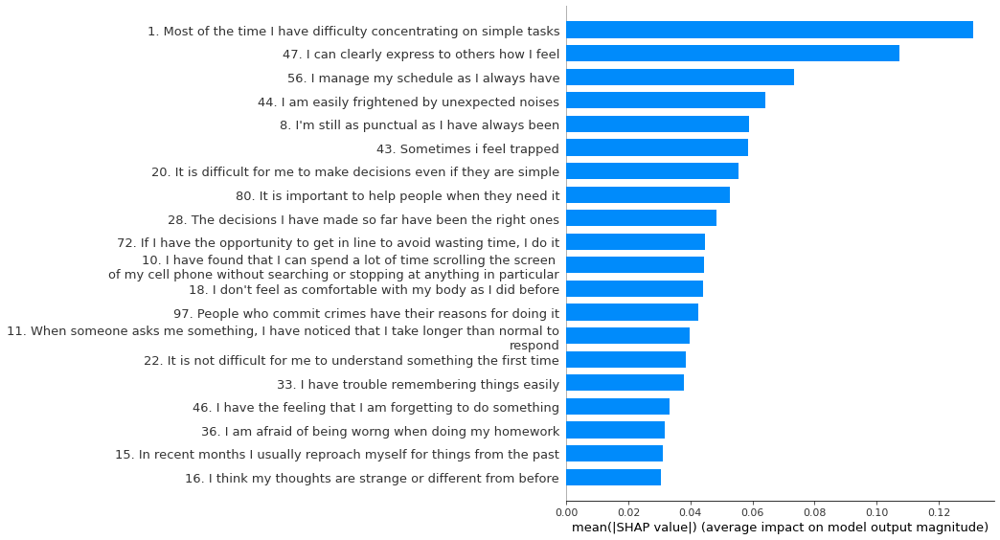

In [101]:
## Individual Selection.
individual = X_test.iloc[[0]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The second individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

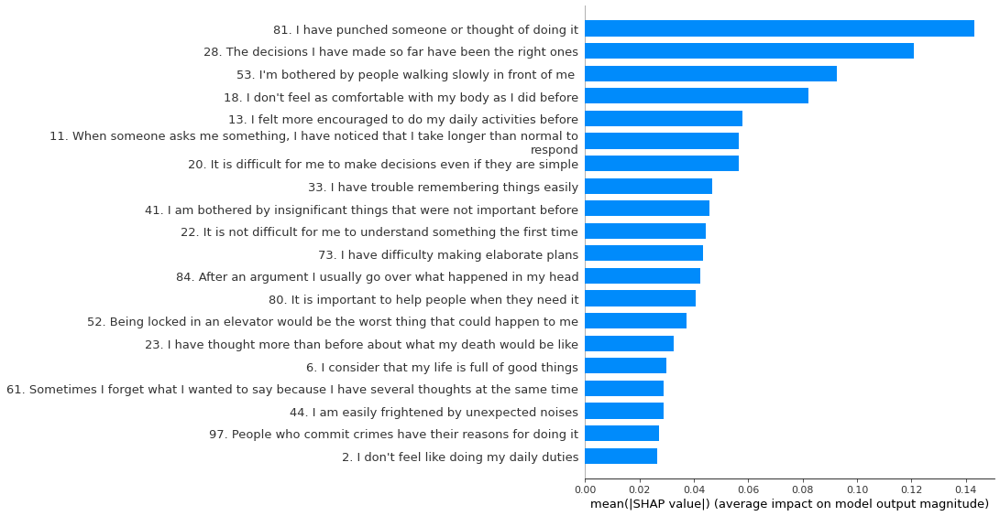

In [102]:
## Individual Selection.
individual = X_test.iloc[[1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The last individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

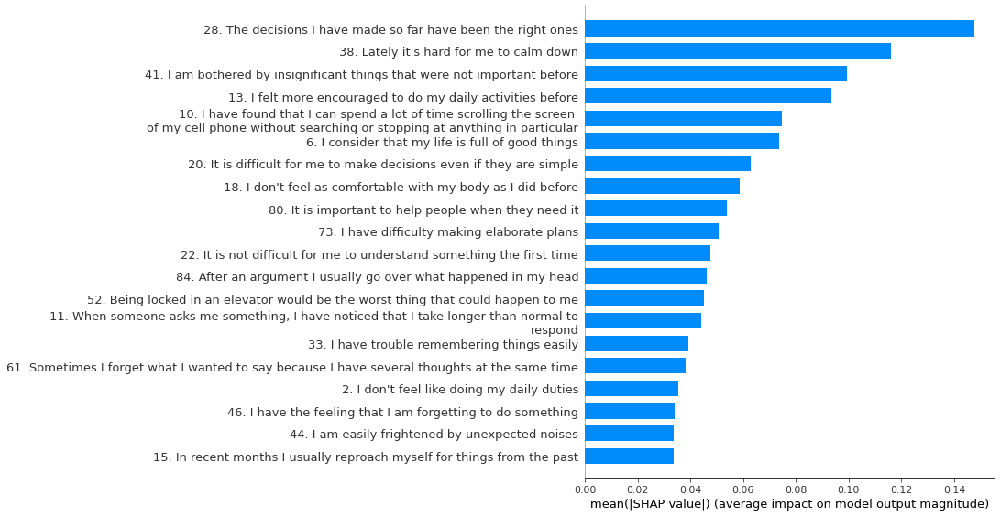

In [103]:
## Individual Selection.
individual = X_test.iloc[[-1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

## Explanation using heatmaps

The importance of the data present in the neural network is shown from explanation methods.

In [104]:
## Questions currently in use are retrieved.
ds_item = ds[ds.Status == "In use"].reset_index(drop=True)

## The data is prepared for the generation of heat maps.
column_Map = ds_item['Question'].tolist()
content_Map = [False for x in range(1, df.shape[1])]

## The next questions to be deleted will be marked.
for index in range(0, len(content_Map)):
    
    if iteration == 0:
        for delete in list_contr:
            if column_Map[index] == delete:
                content_Map [index] = True
    else:
        for delete in question_anomaly:
            if column_Map[index] == delete:
                content_Map [index] = True

## The dataframe is created with the prepared data.
df_mask = pd.DataFrame([content_Map], columns = column_Map)
df_mask_imp = pd.concat([df_mask, df_mask, df_mask], ignore_index = True, axis = 0)
df_mask_all = pd.concat([df_mask, df_mask, df_mask, df_mask], ignore_index = True, axis = 0)

df_mask

,1,2,6,7,8,9,10,11,12,13,...,80,81,82,84,88,92,93,97,99,102
0,False,False,False,False,False,True,False,True,True,False,...,False,False,False,False,False,False,False,False,False,True


### Identification of important variables

Identification of important variables from the randomness of the answers as questions of the data.

In [105]:
## Loading the data for explainability.
explainer = ClassifierExplainer(mlp, X_test, y_test)

## Class index local variable.
iterable_class = -1
map_class = []

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')


### Explainability of the data belonging to the first class, in this case the Low.

Calculating permutation importances (if slow, try setting n_jobs parameter)...


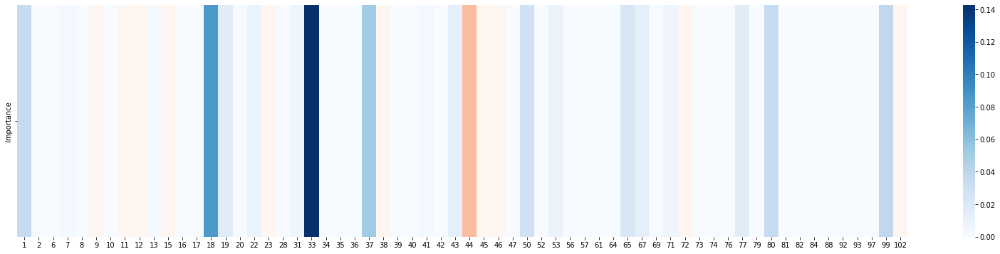

In [106]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

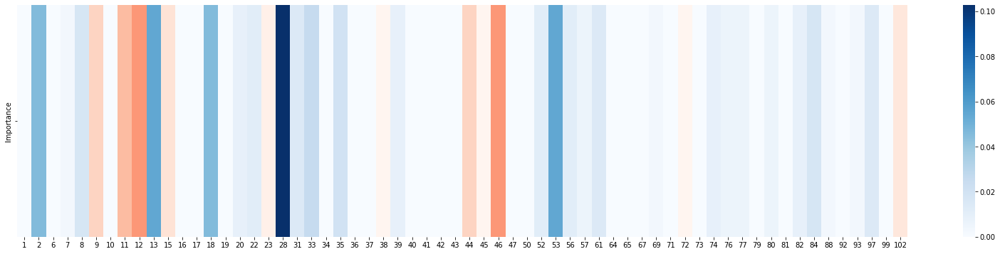

In [107]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

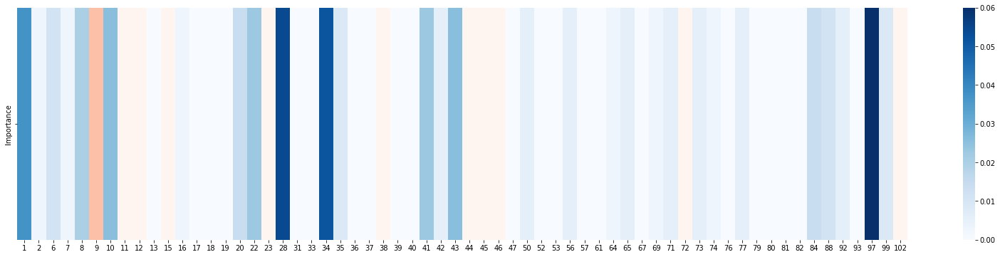

In [108]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

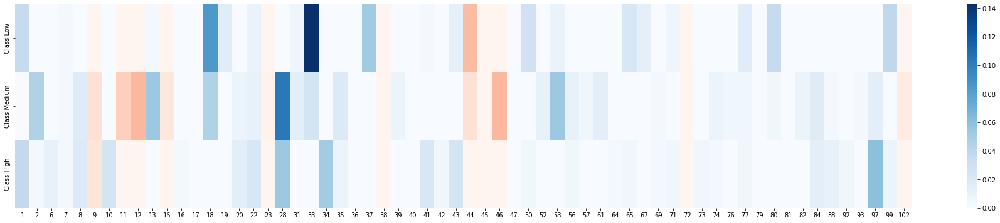

In [109]:
## Fusion of the previous heat maps.
df_importance = pd.concat(map_class, axis=1)
df_importance.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_importance.transpose(), cmap = "Reds", cbar = False)
sns.heatmap(df_importance.transpose(), cmap = "Blues",yticklabels = True, xticklabels = True ,mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using SHAP

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of SHAP.

In [110]:
## Class index local variable.
iterable_class = -1
map_class = []

### Individual explainability of the data belonging to the first class, in this case the Low.

Definition of explainability data.

In [111]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Calculating shap values...


  0%|          | 0/39 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

Generation of the heat map.

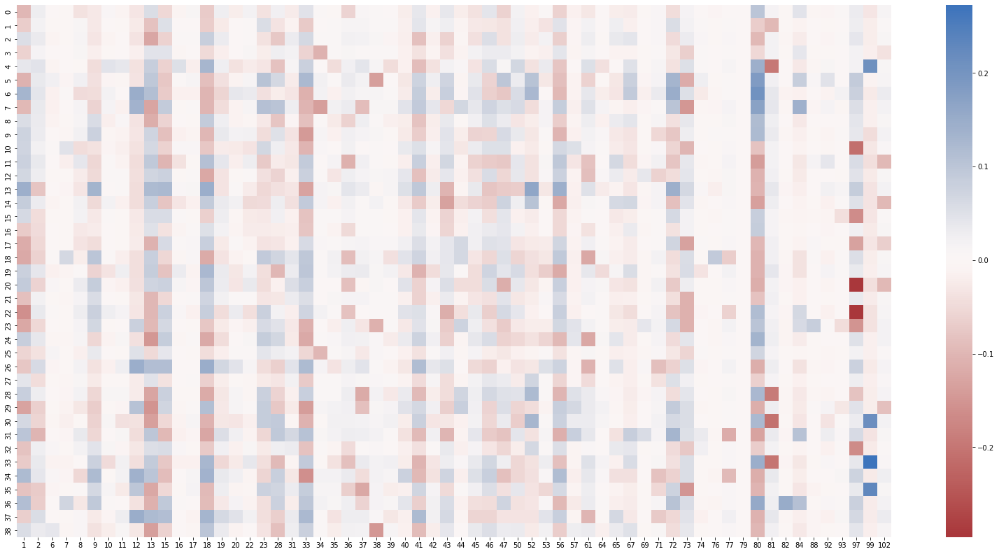

In [112]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [113]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

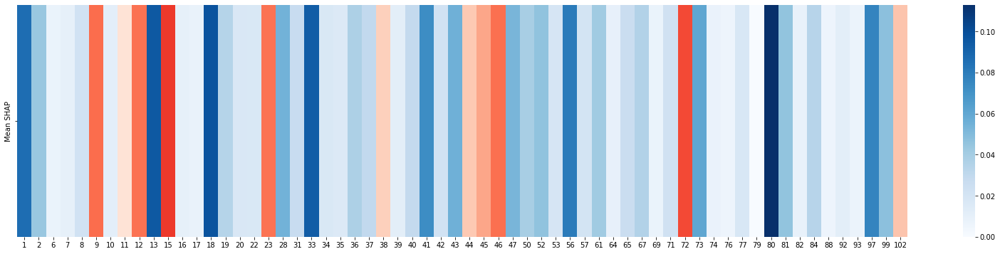

In [114]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Definition of explainability data.

In [115]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

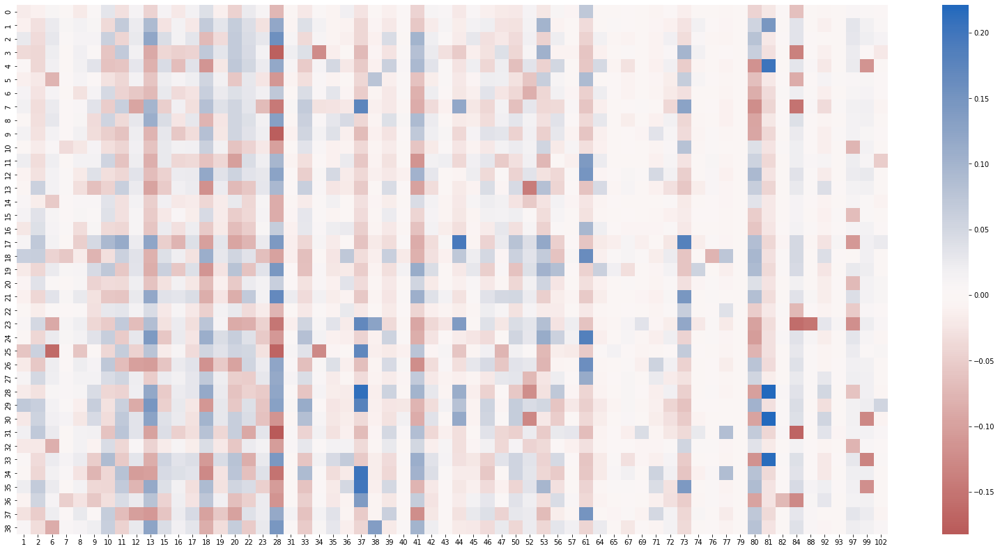

In [116]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [117]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

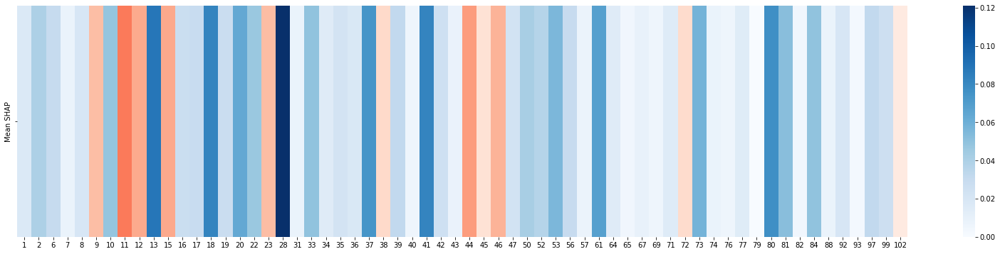

In [118]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Definition of explainability data.

In [119]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

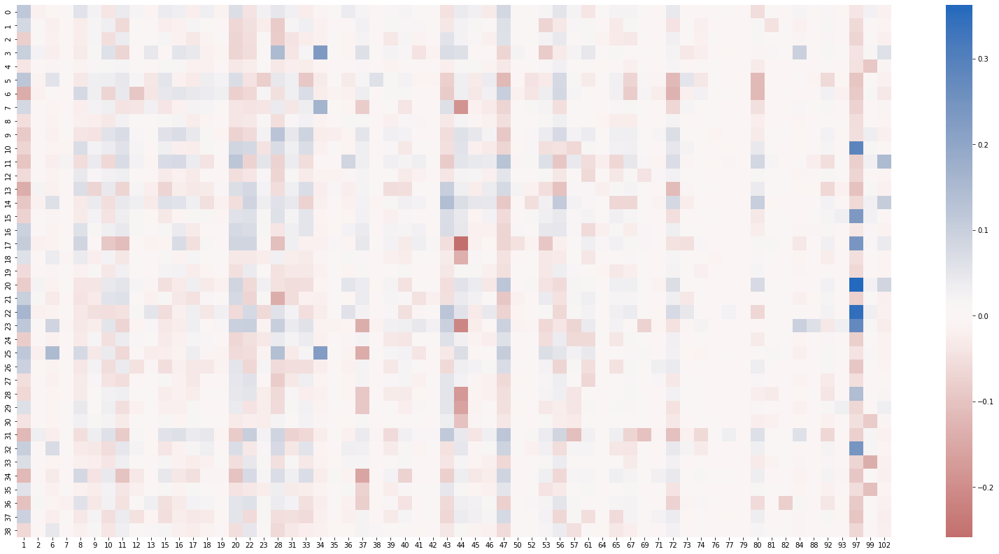

In [120]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [121]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

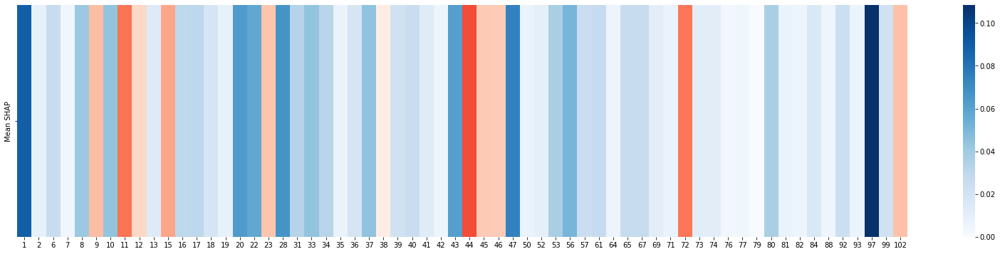

In [122]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

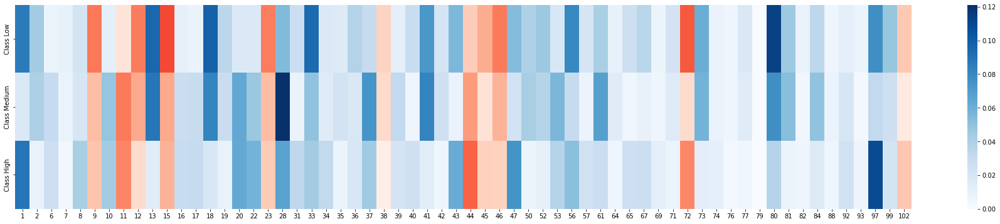

In [123]:
## Fusion of the previous heat maps.
df_shap = pd.concat(map_class, axis=1)
df_shap.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_shap.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_shap.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using LIME

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of LIME.

In [124]:
## Data preparation for explainability.
lime_exp = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                  feature_names=train_cols, class_names=target_names,
                                                  discretize_continuous=True)

## Class index local variable.
iterable_class = -1
map_class = []

Obtaining the data for the generation of the explanations by LIME about the Low, Medium and High classes.

In [125]:
## Local variables for LIME array data.
exp_matrix = [[] for _ in range(len(name_class))]

## Recovering the data needed for LIME.
for x in X_test.to_numpy():
    
    ## Auxiliary temporary variables.
    exp_list = [[] for _ in range(len(name_class))]
    
    ## Loading the data for explainability.
    exp = lime_exp.explain_instance(x, mlp.predict_proba, num_features = df.shape[1] - 1, top_labels = len(name_class))
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
        temp = exp.as_map()[elements]
        temp.sort(key=itemgetter(0))
        
        ## Saving data of the Low, Medium and High classes.
        for tup in temp:
            exp_list[elements].append(tup[1])
            
        exp_matrix[elements].append(exp_list[elements])

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

### Individual explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

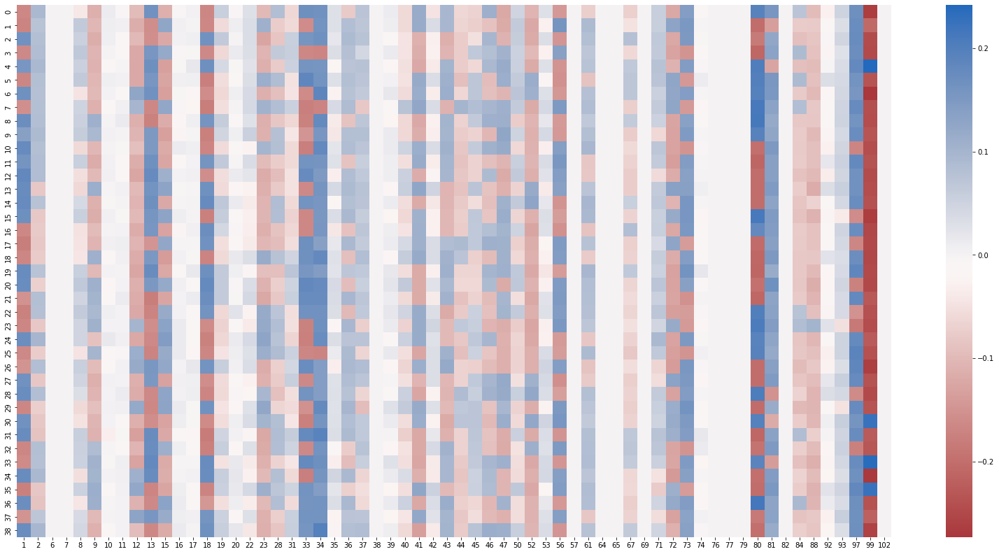

In [126]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

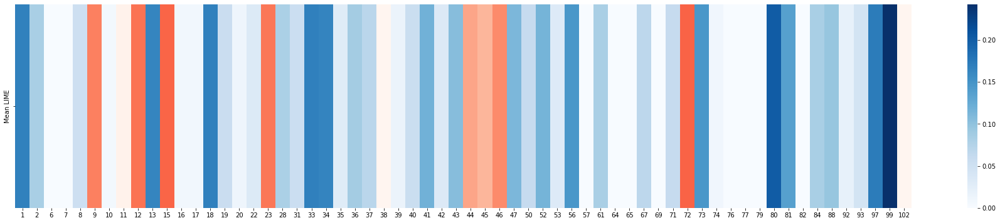

In [127]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

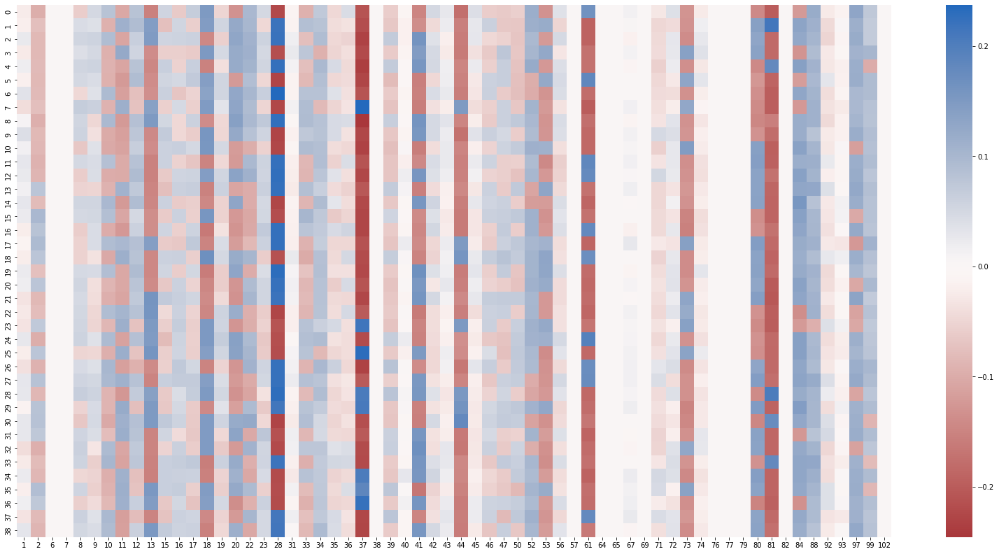

In [128]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

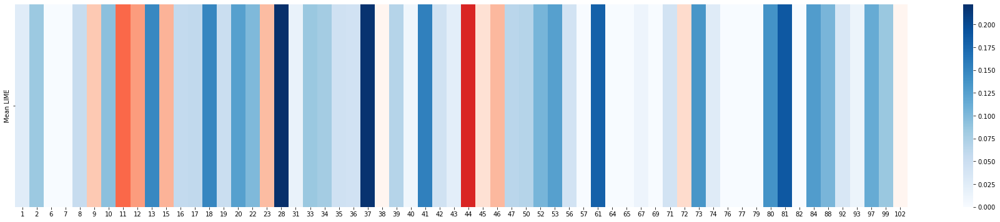

In [129]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Generation of the heat map.

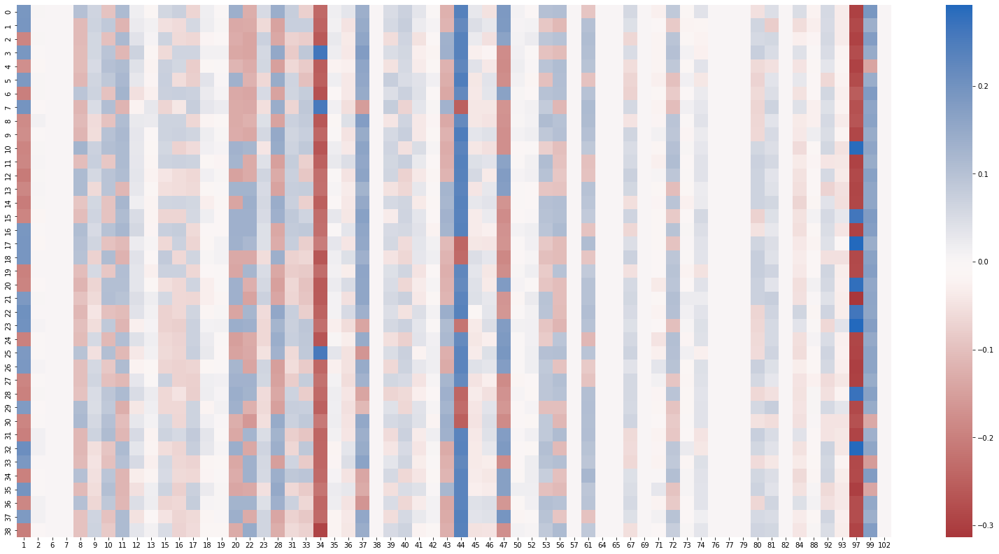

In [130]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

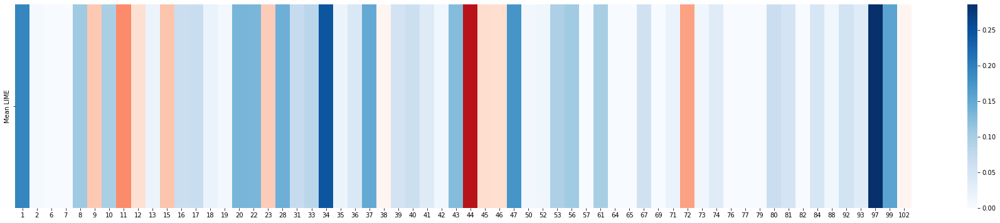

In [131]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

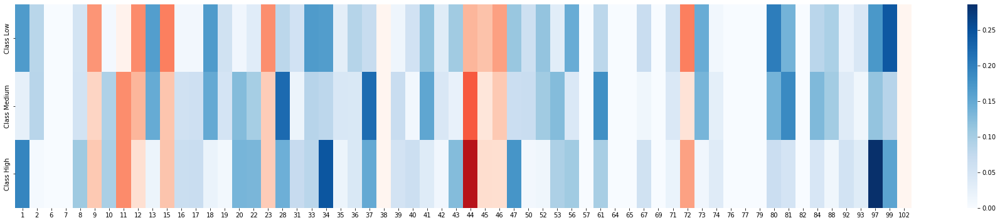

In [132]:
df_lime = pd.concat(map_class, axis=1)
df_lime.columns = name_class
plt.figure(figsize = (32,6))
sns.heatmap(df_lime.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_lime.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using ALE

It shows the main effect of each question compared to the probability that the model predicts in each class. This effect is shown for both responses. Since there are only 2 answers, the map is the same but with the colors reversed.

In [133]:
## Definition of explainability data.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names=train_cols, target_names= target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

## Class index local variable.
iterable_class = -1
map_class = []

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

Obtaining the data for the generation of the explanations by ALE about the all classes.

In [134]:
## Local variables for ALE array data.
ale_list = [[] for _ in range(len(name_class))]

## Recovering the data needed for ALE.
for array in proba_exp_lr.ale_values:
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
    
        ## Saving data of the all classes.
        ale_list[elements].append(array[0][elements])

Data processing for the explainability of ALE.

In [135]:
## Data processing of the Low, Medium and High classes.
for elements in range(0, len(name_class)):
    ale_df = pd.DataFrame([ale_list [elements]])
    ale_df = pd.concat([ale_df.multiply(-1), ale_df])
    ale_df.index = [name_class [elements] + " - False", name_class [elements] + " - True"]
    ale_df.columns = column_Map
    map_class.append(ale_df)

### Explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

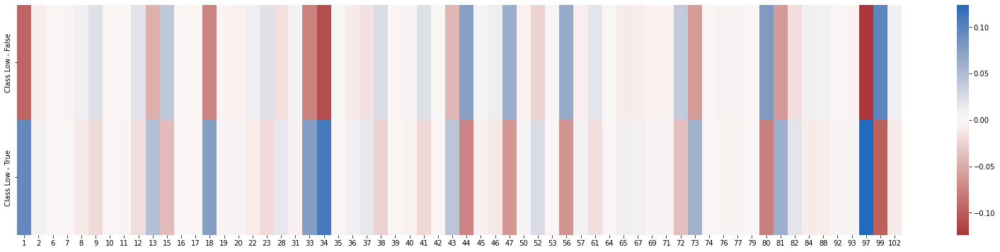

In [136]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

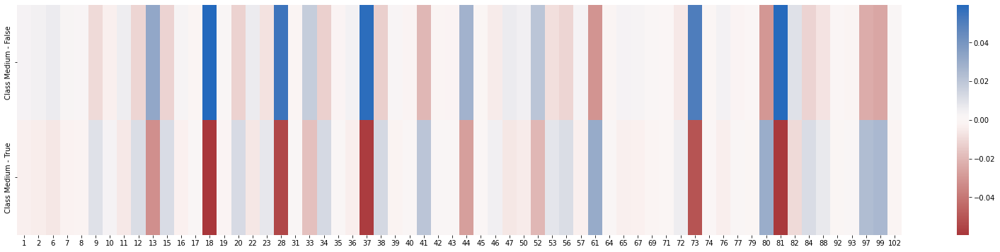

In [137]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

Generation of the heat map.

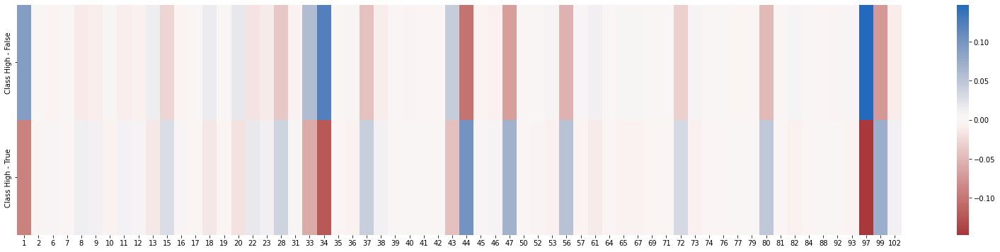

In [138]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used in all classes.

In [139]:
## Application of absolute value to data.
for index in range(0, len(map_class)):
    map_class [index] = map_class [index][0:1].abs()

## Union of the heat maps of the Low, Medium and High class.
ale_df = pd.concat(map_class)
ale_df.index = name_class
ale_df = ale_df.transpose()

Generation of the heat map.

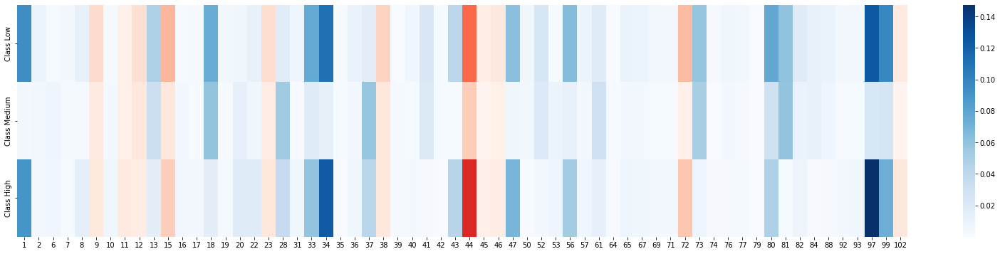

In [140]:
plt.figure(figsize = (28,6))
sns.heatmap(ale_df.transpose(), cmap="Reds", cbar = False)
sns.heatmap(ale_df.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask= df_mask_imp.to_numpy())
plt.show()

## Comparing of Important Variables Methods for Explainability

The global values of each of the methods used are taken, their maximums are obtained (the minimums are 0) and a percentage is calculated based on said maximum, which indicates how relevant the contribution is for each question.

In [141]:
## Class index local variable.
iterable_class = -1

### Comparison of the explanation methods of the first class, in this case the Low.

The highest data of each method used is obtained.

In [142]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [143]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,9,10,11,12,13,...,80,81,82,84,88,92,93,97,99,102
Importance,25.000000,0.000000,0.000000,2.272727,0.000000,0.000000,0.000000,0.000000,0.000000,2.272727,...,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,27.272727,0.000000
LIME,68.957292,34.177685,0.000000,0.000000,21.536471,43.301320,2.720055,2.258402,46.904001,67.421970,...,83.114928,56.619808,0.000000,34.027454,39.273244,7.849573,18.117599,71.016590,100.000000,0.000000
SHAP,76.558285,38.778529,6.547853,8.676388,19.431871,48.908689,10.142224,11.079799,47.454612,84.213619,...,100.000000,40.320912,7.679355,30.061070,5.328183,10.390921,6.154967,67.881991,42.128194,22.082399
ALE,75.889461,7.120971,0.604150,2.995356,9.322719,16.744014,1.987798,2.881302,15.108554,38.131508,...,62.602001,48.645777,14.689376,8.605199,7.498833,2.620477,3.472653,100.000000,79.419514,8.404651


Generation of the heat map.

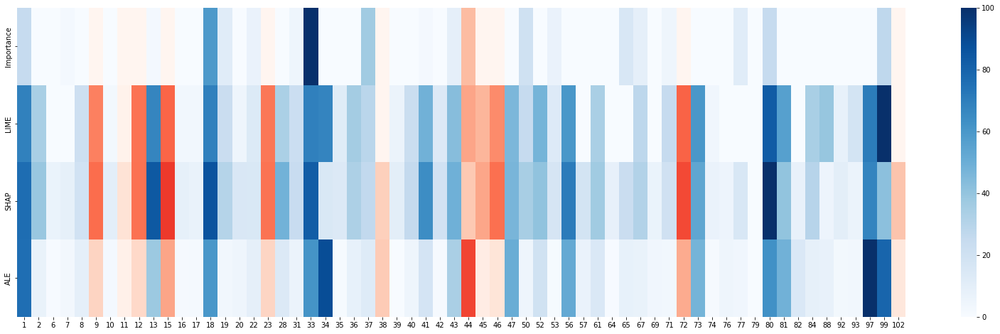

In [144]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the second class, in this case the Medium.

The highest data of each method used is obtained.

In [145]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [146]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,9,10,11,12,13,...,80,81,82,84,88,92,93,97,99,102
Importance,0.000000,44.444444,0.000000,2.777778,16.666667,16.666667,0.000000,25.000000,36.111111,52.777778,...,5.555556,0.000000,8.333333,16.666667,2.777778,0.000000,2.777778,13.888889,0.000000,8.333333
LIME,11.438285,37.904766,0.000000,0.000000,24.430571,20.683228,42.155258,50.505409,34.609679,66.193907,...,61.852178,84.420291,0.000000,57.956520,46.562155,15.766768,5.497733,51.349762,38.308183,0.000000
SHAP,14.143923,32.928012,25.016077,6.294407,16.140520,24.000509,39.539531,44.949943,30.351754,72.739554,...,63.623033,42.840083,3.671512,40.999910,6.516302,16.035228,2.062961,26.434202,21.524408,6.564502
ALE,6.229263,7.216456,10.893000,4.057098,3.263553,16.908867,6.154425,9.739768,18.939424,54.461686,...,50.310492,98.835782,17.171741,19.939974,12.424484,1.256545,2.204652,39.480424,42.448055,1.783416


Generation of the heat map.

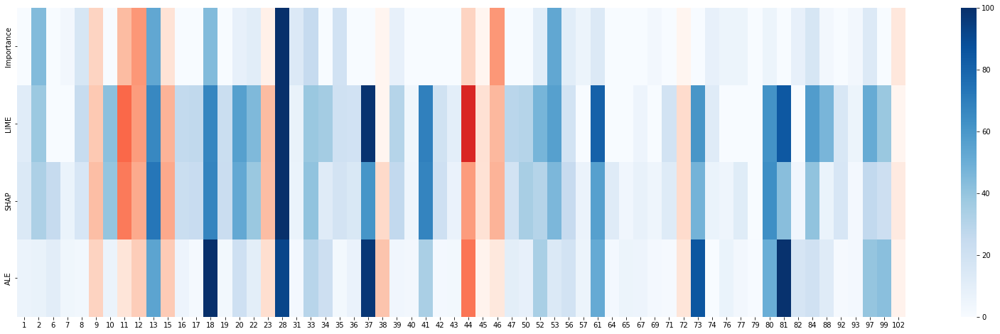

In [147]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the third class, in this case the High.

The highest data of each method used is obtained.

In [148]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [149]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,9,10,11,12,13,...,80,81,82,84,88,92,93,97,99,102
Importance,61.904762,4.761905,19.047619,4.761905,33.333333,23.809524,42.857143,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.850372e-13,23.809524,19.047619,9.523810,0.000000,100.0,14.285714,0.000000
LIME,67.261690,1.929856,0.000000,0.000000,37.205220,20.596203,33.830260,39.506139,12.831044,5.673379,...,22.330690,17.626122,0.000000e+00,16.201122,4.259770,18.866532,11.902120,100.0,54.909558,0.000000
SHAP,81.790333,7.909130,24.095364,3.821409,38.073446,24.287101,40.503619,46.536212,15.499134,12.888690,...,33.934313,6.857993,5.167073e+00,14.935972,5.016252,22.104367,6.086405,100.0,20.070966,23.435831
ALE,61.287501,3.075014,3.887109,0.881292,9.154433,7.254560,4.154296,6.352058,5.060342,10.083666,...,32.331084,1.019376,5.421148e+00,0.810771,1.291391,2.710035,3.809001,100.0,49.641967,7.785411


Generation of the heat map.

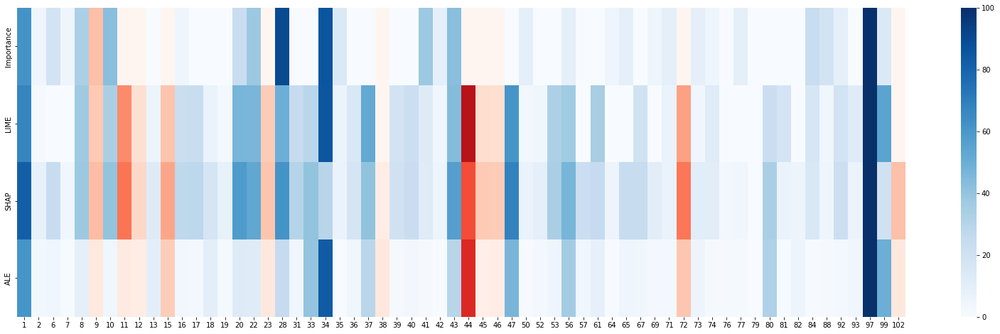

In [150]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

Safeguarding the questions eliminated during this iteration.

In [151]:
## Removal of anomalous questions selected by selection_mode.
for x in question_anomaly:

    ## Status change of the deleted question in the respective auxiliary dataset.
    ds.loc[x - 1,'Status'] = 'Delete'

## Save the changed statuses in the dataset.
ds.to_csv(path_dataset_qs, index = False)

## Iteration 2

The first iteration of improvement of the model is carried out.

## Preparing the data for the neural network

The data is prepared in order to be processed by the neural network.

In [152]:
## The iteration number is increased.
iteration += 1

## Loading data from the dataset.
df = pd.read_csv(path_dataset)
ds = pd.read_csv(path_dataset_qs)

## Elimination of unrelated questions from the dataset.
if len(unrelated_questions) != 0:
    df = df.drop(df.columns[unrelated_questions[0]:unrelated_questions[1]], axis=1)

i = 0
if iteration == 1:
    ## Elimination of list of conflicting questions declared in global variables.
    for x in list_contr:
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1
        ## Status change of the deleted question in the respective auxiliary dataset.
        ds.loc[x - 1,'Status'] = 'Delete'
    
else:    
    ## Elimination of the list of anomadic questions defined in the improvement process.
    ds_delete = ds[ds.Status == "Delete"].reset_index(drop=True)
    for x in ds_delete['Question'].tolist():
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1

## Grouping of the target according to the defined dictionary.
if grouping_name != None and grouping_name != '':
    df[grouping_name] = df[grouping_name].map(class_dic)

## Assignment of local variables according to the data necessary for the neural network.
train_cols = df.columns [0:-1]
label = df.columns [-1]
X = df [train_cols]
y = df [label]

## The prepared data of the dataset is printed.
df

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,18. I don't feel as comfortable with my body as I did before,...,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,88,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns,Target
0,1,1,1,1,1,0,0,0,0,0,...,1,0,1,0,1,0,0,0,0,0
1,1,0,1,1,1,0,1,1,1,0,...,1,0,1,1,0,0,0,0,0,0
2,0,0,1,1,0,1,0,1,0,1,...,0,0,1,0,0,0,0,0,0,1
3,0,0,1,1,1,0,1,0,0,1,...,0,0,1,0,0,1,0,1,0,2
4,1,1,1,0,1,1,0,1,1,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,1,1,1,1,1,1,1,0,0,1,...,1,1,1,0,1,1,0,1,1,2
100,1,1,1,1,0,0,1,0,0,0,...,0,0,1,0,0,0,0,1,0,1
101,0,0,1,1,0,1,1,1,0,1,...,0,0,1,1,0,1,0,0,1,0
102,1,0,1,1,1,1,0,0,1,1,...,0,0,1,1,0,1,0,0,0,2


## Oversample application

An oversample process is applied to level the amount of existing data given by the grouping.

In [153]:
## The number of elements present in the grouped target is printed.
y.value_counts()

0    39
1    35
2    30
Name: Target, dtype: int64

Oversample application.

In [154]:
## Application of the oversample to the prepared data.
X, y = oversample.fit_resample(X, y)

Printing of the data after the application of the oversample.

In [155]:
## The results obtained after applying the oversample are printed.
y.value_counts()

0    39
1    39
2    39
Name: Target, dtype: int64

## Preparation of the parameters of the neural network

We proceed to define the parameters necessary for the training of the neural network.

In [156]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=seed)

## Neural network training

The alpha parameters and the initial learning rate are adjusted to obtain the best performance with the model
using cross validation.

In [157]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_normal

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = regul_param, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.15999999999999998,
  0.24206284943127052,
  0.30571779236432206,
  0.28391696838958497,
  0.2849352225812138,
  0.2849352225812138,
  0.2849352225812138,
  0.2849352225812138,
  0.2849352225812138],
 [0.005443310539518168,
  0.05412997390137115,
  0.07837114850112376,
  0.0760679130846169,
  0.07647789235276374,
  0.07647789235276374,
  0.07647789235276374,
  0.07647789235276374,
  0.07647789235276374])

We proceed to draw the learning curve graph according to the data obtained by the training.

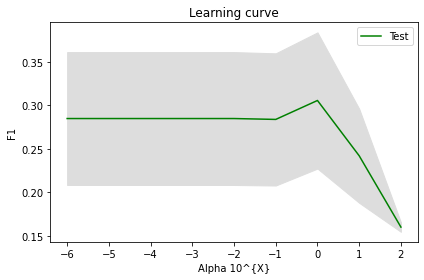

In [158]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Alpha 10^{X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

The training is performed again keeping the same parameters except for the alpha value that changes to 1.

In [159]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_alpha

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = regul_param, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.20002265570686623,
  0.4314402264402264,
  0.4498720090825354,
  0.4378194102652307,
  0.30571779236432206,
  0.16659498207885304,
  0.16659498207885304],
 [0.03854518308236841,
  0.13062146376380732,
  0.13455453846003146,
  0.1275674740375547,
  0.07837114850112376,
  0.006020651927912844,
  0.006020651927912844])

We proceed to draw the learning curve graph according to the data obtained by the training.

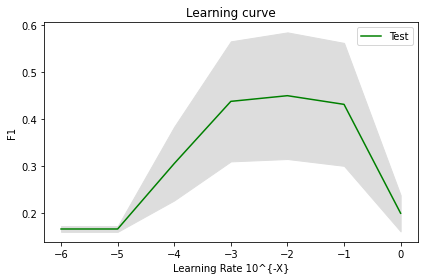

In [160]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Learning Rate 10^{-X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

## Generation of the neural network model

The parameters of the final model are modified according to the data obtained in the training of the neural network.

In [161]:
## The value of the alpha parameter, learning_rate_init and random_state are changed according
## to the data in the global variables.
mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = alpha,
                            learning_rate = 'constant', learning_rate_init = learning_rate_init, max_iter = 100000,
                            random_state = random_state_model)

## We print the data of the final generated model.
mlp.fit(X_train, y_train)

MLPClassifier(activation='logistic', alpha=0.001, hidden_layer_sizes=(10,),
              learning_rate_init=0.1, max_iter=100000, random_state=42)

We safeguard the final generated model

In [162]:
joblib.dump(mlp,"model_depression_i" + str(iteration) + ".pkl")

['model_depression_i2.pkl']

## Generation of the confusion matrix of the model

We obtain the statistics of the final model to generate its confusion matrix.

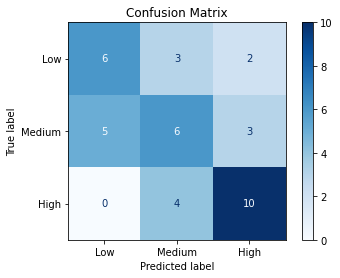

In [163]:
## The data for the generation of the confession matrix are defined.
confusion_matrix = ConfusionMatrixDisplay.from_estimator(mlp, X_test, y_test, display_labels = target_names,
                                                         cmap = plt.cm.Blues)
confusion_matrix.ax_.set_title("Confusion Matrix")
plt.show()

We get the detailed statistics of the final model.

In [164]:
## The necessary detailed prediction is generated.
y_pred = mlp.predict(X_test)

## The detailed statistics of the model are printed.
print('Classification accuracy =',accuracy_score(y_test,y_pred) * 100,'%\n')
print(classification_report(y_test,y_pred))

Classification accuracy = 56.41025641025641 %

              precision    recall  f1-score   support

           0       0.55      0.55      0.55        11
           1       0.46      0.43      0.44        14
           2       0.67      0.71      0.69        14

    accuracy                           0.56        39
   macro avg       0.56      0.56      0.56        39
weighted avg       0.56      0.56      0.56        39



The data obtained is saved for later graphing.

In [165]:
accuracy = accuracy_score(y_test,y_pred) * 100
clf_rep = precision_recall_fscore_support(y_test,y_pred)

## The number of questions used in the iteration is retrieved.
ds_delete = ds[ds.Status == "Delete"]
ds_delete.reset_index(inplace=True, drop=True)

## All the metrics of the confusion matrix are obtained.
metrics = [",".join(map(str, ds_delete['Question'].tolist())), accuracy, clf_rep[0][0], clf_rep[1][0],
           clf_rep[2][0], clf_rep[3][0],clf_rep[0][1], clf_rep[1][1], clf_rep[2][1], clf_rep[3][1],
           clf_rep[0][2], clf_rep[1][2], clf_rep[2][2], clf_rep[3][2]]

## The names of the columns of the dataset are defined.
columns = ['Question','Acurracy global','Precision_0','Recall_0','F1_score_0', 'Support_0',
           'Precision_1','Recall_1','F1_score_1', 'Support_1','Precision_2','Recall_2','F1_score_2','Support_2']

## A new row of the dataset is generated with all the data.
data = pd.DataFrame([metrics], columns = columns)

## The data is saved to the dataset.
data.to_csv(path_dataset_qd, mode = 'a', header = False, index = False)

## The data added to the dataset is printed.
data

,Question,Acurracy global,Precision_0,Recall_0,F1_score_0,Support_0,Precision_1,Recall_1,F1_score_1,Support_1,Precision_2,Recall_2,F1_score_2,Support_2
0,"3,4,5,9,11,12,14,15,21,23,24,25,26,27,29,30,32...",56.410256,0.545455,0.545455,0.545455,11,0.461538,0.428571,0.444444,14,0.666667,0.714286,0.689655,14


## Improvement process of the neural network model.

The application of the explanation method by ALE allows to determine the behavior of the neural network and thereby improve it by discarding non-significant data for it.

## Slope Analysis of ALE Plots

In [166]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

We proceed to obtain the graphs to obtain the slopes of the selected classes.

In [167]:
## The question metrics dataset is loaded.
dm = pd.DataFrame()

## The number of questions used in the iteration is retrieved.
ds_item = ds[ds.Status == "In use"]
ds_item.reset_index(inplace=True, drop=True)

## We get the slopes from the ALE data.
for i in range(df.shape[1]-1):
    structure_data = {'Question': ds_item.loc[i, "Question"]}
    
    for index in selection_class:
        slope = proba_exp_lr.ale_values [i][1][index] - proba_exp_lr.ale_values [i][0][index]
        structure_data['Slope ' + str(target_names[index])] = slope
        structure_data['Threshold ' + str(target_names[index])] = 'NA'
        structure_data['Anomaly ' + str(target_names[index])] = 'NA'
        
    dm = dm.append(structure_data, ignore_index=True)
    
## The current rating data dataset is printed.
dm

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be remove

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.078007,NA,NA,0.060910,NA,NA
1,2,-0.009548,NA,NA,-0.002863,NA,NA
2,6,0.004662,NA,NA,-0.006732,NA,NA
3,7,-0.002550,NA,NA,0.002728,NA,NA
4,8,0.056086,NA,NA,-0.069883,NA,NA
5,10,-0.011161,NA,NA,0.009315,NA,NA
6,13,-0.060551,NA,NA,0.004189,NA,NA
7,16,-0.000957,NA,NA,0.002491,NA,NA
8,17,0.006024,NA,NA,0.021221,NA,NA
9,18,-0.013840,NA,NA,0.001035,NA,NA


## Slope analysis and threshold application

The slope obtained is analyzed and those that are above or below the positive and negative threshold are selected.

In [168]:
for i in range(df.shape[1]-1):
    for index in selection_class:
        
        ## The slopes are selected according to the values of the thresholds of the defined classes.
        if dm.loc[i, "Slope " + str(target_names[index])] >= positive_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 1
        elif dm.loc[i, "Slope " + str(target_names[index])] <= negative_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 0
            
## The current rating data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.078007,0,NA,0.060910,1,NA
1,2,-0.009548,NA,NA,-0.002863,NA,NA
2,6,0.004662,NA,NA,-0.006732,NA,NA
3,7,-0.002550,NA,NA,0.002728,NA,NA
4,8,0.056086,1,NA,-0.069883,0,NA
5,10,-0.011161,0,NA,0.009315,NA,NA
6,13,-0.060551,0,NA,0.004189,NA,NA
7,16,-0.000957,NA,NA,0.002491,NA,NA
8,17,0.006024,NA,NA,0.021221,1,NA
9,18,-0.013840,0,NA,0.001035,NA,NA


## Analysis and determination of anomalous questions

The anomalous questions present in the model are determined based on their slope and expected response from the expert.

In [169]:
## The dataset of expected responses is loaded.
da = pd.read_csv(path_dataset_qa)

## Delete list of questions deleted in this iteration.
i = 0
for x in ds_delete['Question']:
    da.drop(da.index[x - (i + 1)], axis = 0, inplace = True)
    i += 1

## Indexes are restored for later use.
da.reset_index(inplace=True, drop=True)

## The dataset of expected responses is printed.
da

,Numero,Pregunta,RE
0,1,La mayor parte del tiempo tengo dificultad par...,1
1,2,No siento ganas de hacer mis deberes cotidianos,1
2,6,Considero que mi vida está llena de cosas buenas,0
3,7,Mis aficiones siguen siendo importante,0
4,8,Sigo siendo tan puntual como siempre he sido,0
5,10,Me he dado cuenta de que puedo pasar mucho tie...,1
6,13,Antes me sentía más animado para hacer mis act...,1
7,16,Creo que mis pensamientos son extraños o disti...,1
8,17,Siento culpa sobre las decisiones que he tomado,1
9,18,No me siento tan cómodo con mi cuerpo como me ...,1


We proceed to identify the anomadic questions present in the model present in this iteration.

In [170]:
for i in range(df.shape[1]-1):
    
    ## Local variable to indicate the index of the selected classes.
    i_index = 0
    
    for index in selection_class:
        
        ## Determine if it fails based on the expected response parameters of the defined classes.
        if dm.loc[i, "Threshold "  + str(target_names[index])] == 1 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][0]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 1 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][1]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][2]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly "  + str(target_names[index])] = expected_response_map[i_index][3]
        
        ## Increase of the index of the selected classes.
        i_index += 1

## The final grade data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.078007,0,0,0.060910,1,0
1,2,-0.009548,NA,NA,-0.002863,NA,NA
2,6,0.004662,NA,NA,-0.006732,NA,NA
3,7,-0.002550,NA,NA,0.002728,NA,NA
4,8,0.056086,1,0,-0.069883,0,0
5,10,-0.011161,0,0,0.009315,NA,NA
6,13,-0.060551,0,0,0.004189,NA,NA
7,16,-0.000957,NA,NA,0.002491,NA,NA
8,17,0.006024,NA,NA,0.021221,1,0
9,18,-0.013840,0,0,0.001035,NA,NA


## Removing identified anomadic questions from the model

We proceed to eliminate the identified anomadic questions so as not to use them in the next iteration.

In [171]:
## Local variable for the elimination of the anomaly questions.
instructions = ''
init = False
question_anomaly = []

if selection_mode == 1:
    
    ## Questions that fail in the defined class are retrieved.
    dm_delete = dm[dm['Anomaly ' + str(target_names[select_class_mode])] == 1]
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 2:
    
    ## Questions that fail in classes defined with the or condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " or `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 3:
    
    ## Questions that fail in classes defined with the and condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 4:
    
    ## Out-of-threshold questions are retrieved in classes defined with the condition type and.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 'NA'"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 'NA'"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()

## The selected blank questions are printed according to the selection_mode.
question_anomaly

[19, 88]

## Model explainability process

The data used for the test of the neural network model is shown.

In [172]:
X_test

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,18. I don't feel as comfortable with my body as I did before,...,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,88,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns
69,1,0,1,1,0,0,0,0,0,1,...,1,1,0,1,1,0,0,0,0,0
46,1,0,1,1,1,1,1,1,1,1,...,1,0,1,1,0,0,0,0,0,0
58,0,0,1,1,1,0,1,1,0,0,...,1,0,0,1,0,0,0,0,0,0
114,1,0,1,1,1,1,0,0,1,1,...,1,0,0,1,1,0,0,0,0,0
73,0,0,1,1,1,1,0,0,0,0,...,1,1,1,1,0,0,0,0,0,1
98,1,0,0,1,1,1,0,1,0,1,...,1,1,0,1,1,0,1,0,0,0
31,0,0,1,1,0,0,0,0,1,1,...,1,1,0,1,0,0,0,0,0,0
53,1,0,1,1,1,1,1,1,1,1,...,1,1,0,1,1,0,0,0,0,0
65,0,0,1,1,1,0,1,0,0,0,...,1,1,0,1,0,0,0,0,0,0
96,0,0,1,1,1,1,0,0,1,1,...,1,1,0,1,0,0,0,0,0,0


## Explanation of the model using ALE

In analysis of the model through the results obtained by ALE, it is possible to identify the behavior of the neural network.

In [173]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

The graphs of all the data present in the dataset used are shown.

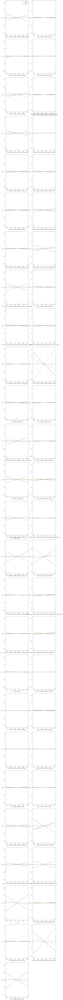

In [174]:
plot_ale(proba_exp_lr, n_cols=2, features=list(range(df.shape[1]-1)),fig_kw={'figwidth': 10, 'figheight': 180});

## Explanation of the model using LIME

We proceed to explain the improved model using LIME for the Low, Medium and High classes.

In [175]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                   feature_names=train_cols, class_names=target_names, 
                                                   discretize_continuous=True)

The first individual present in the test data is explained.

In [176]:
exp = explainer.explain_instance(X_test.to_numpy()[0], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The second individual present in the test data is explained.

In [177]:
exp = explainer.explain_instance(X_test.to_numpy()[1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The last individual present in the test data is explained.

In [178]:
exp = explainer.explain_instance(X_test.to_numpy()[-1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


## Explanation of the model using SHAP

SHAP explanatory values are displayed according to the class to which the selected individual belongs according to the prediction of the model.

The first individual present in the test data is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

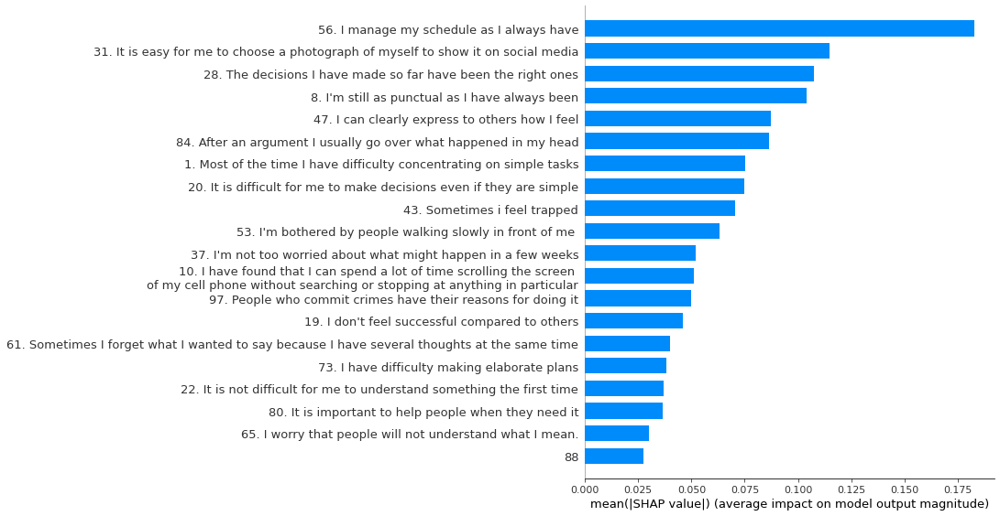

In [179]:
## Individual Selection.
individual = X_test.iloc[[0]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The second individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

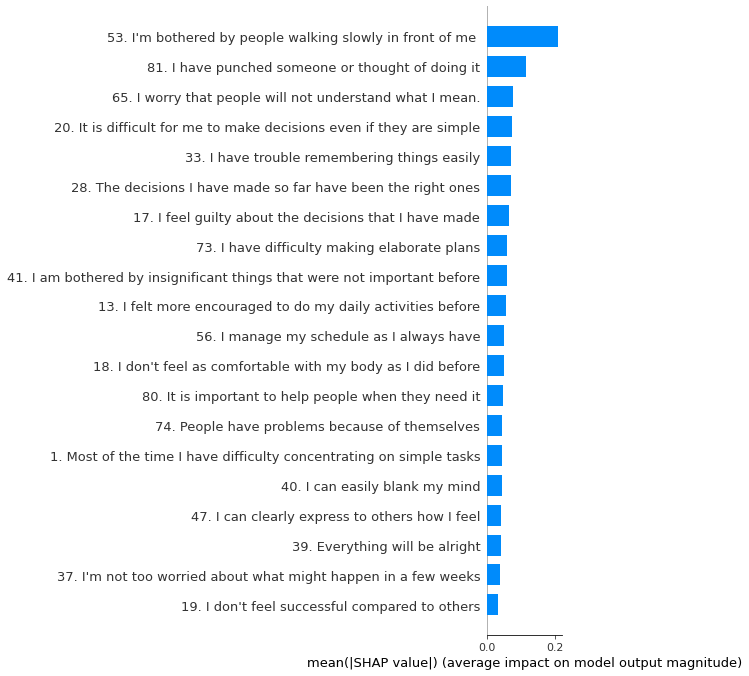

In [180]:
## Individual Selection.
individual = X_test.iloc[[1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The last individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

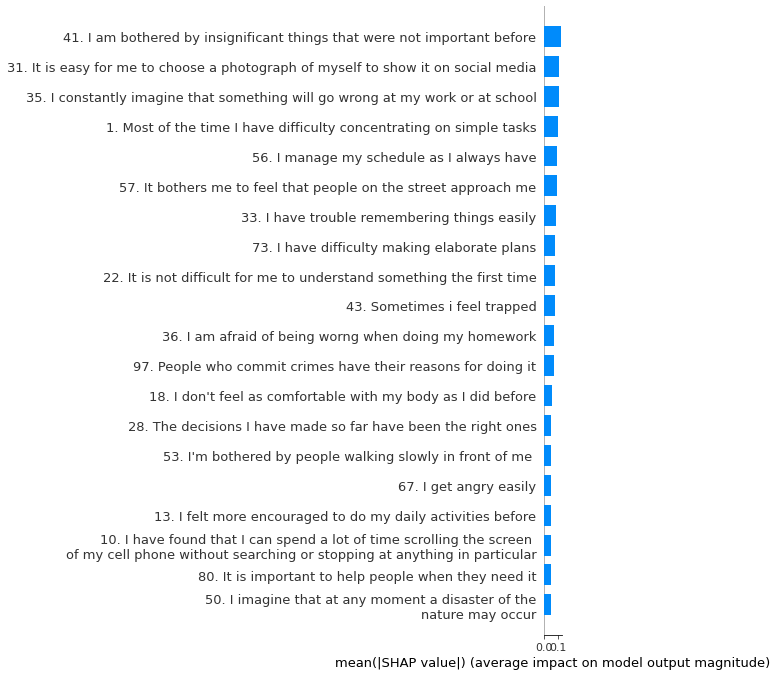

In [181]:
## Individual Selection.
individual = X_test.iloc[[-1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

## Explanation using heatmaps

The importance of the data present in the neural network is shown from explanation methods.

In [182]:
## Questions currently in use are retrieved.
ds_item = ds[ds.Status == "In use"].reset_index(drop=True)

## The data is prepared for the generation of heat maps.
column_Map = ds_item['Question'].tolist()
content_Map = [False for x in range(1, df.shape[1])]

## The next questions to be deleted will be marked.
for index in range(0, len(content_Map)):
    
    if iteration == 0:
        for delete in list_contr:
            if column_Map[index] == delete:
                content_Map [index] = True
    else:
        for delete in question_anomaly:
            if column_Map[index] == delete:
                content_Map [index] = True

## The dataframe is created with the prepared data.
df_mask = pd.DataFrame([content_Map], columns = column_Map)
df_mask_imp = pd.concat([df_mask, df_mask, df_mask], ignore_index = True, axis = 0)
df_mask_all = pd.concat([df_mask, df_mask, df_mask, df_mask], ignore_index = True, axis = 0)

df_mask

,1,2,6,7,8,10,13,16,17,18,...,79,80,81,82,84,88,92,93,97,99
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,False,False,False,False


### Identification of important variables

Identification of important variables from the randomness of the answers as questions of the data.

In [183]:
## Loading the data for explainability.
explainer = ClassifierExplainer(mlp, X_test, y_test)

## Class index local variable.
iterable_class = -1
map_class = []

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')


### Explainability of the data belonging to the first class, in this case the Low.

Calculating permutation importances (if slow, try setting n_jobs parameter)...


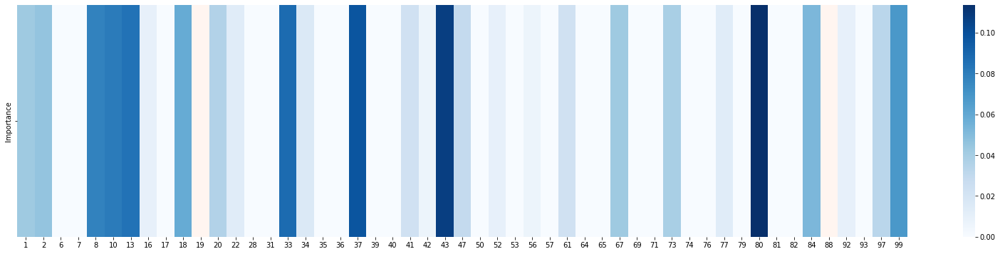

In [184]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

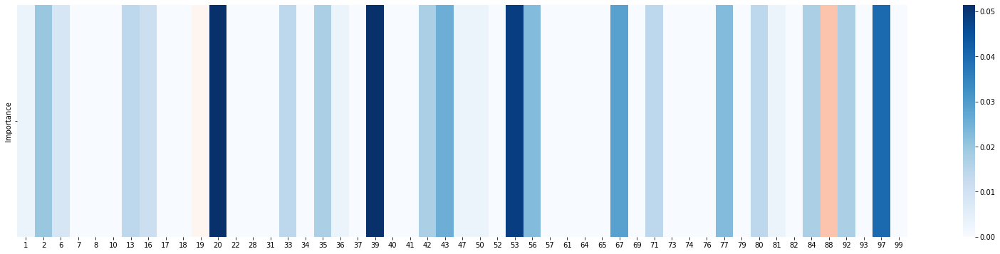

In [185]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

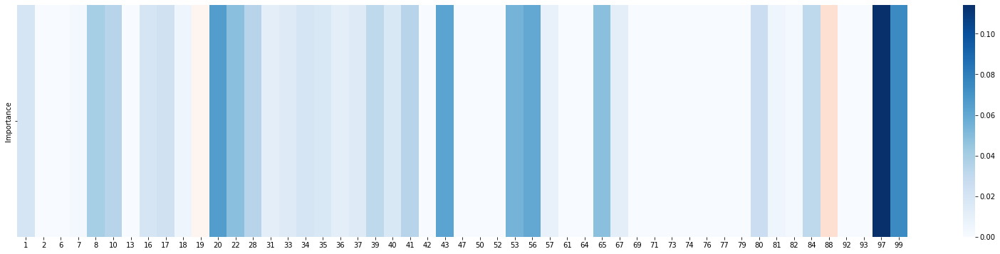

In [186]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

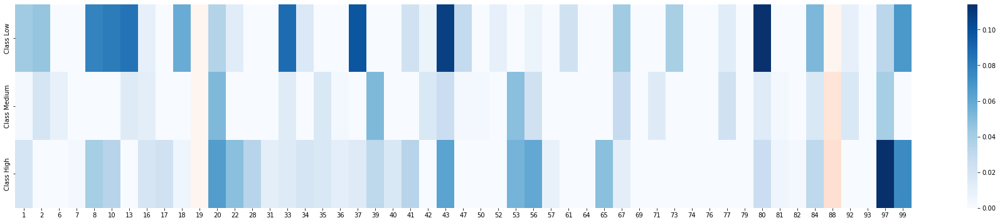

In [187]:
## Fusion of the previous heat maps.
df_importance = pd.concat(map_class, axis=1)
df_importance.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_importance.transpose(), cmap = "Reds", cbar = False)
sns.heatmap(df_importance.transpose(), cmap = "Blues",yticklabels = True, xticklabels = True ,mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using SHAP

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of SHAP.

In [188]:
## Class index local variable.
iterable_class = -1
map_class = []

### Individual explainability of the data belonging to the first class, in this case the Low.

Definition of explainability data.

In [189]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Calculating shap values...


  0%|          | 0/39 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

Generation of the heat map.

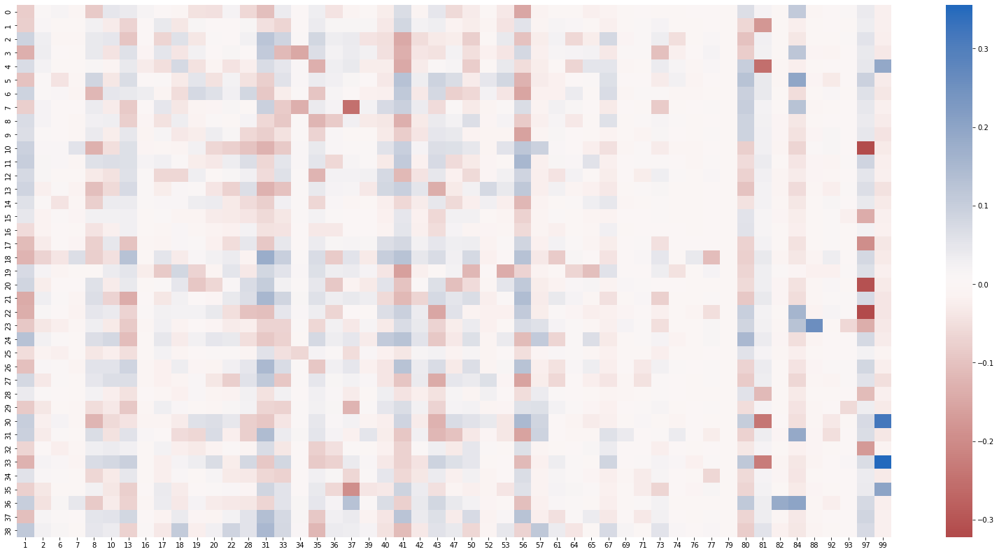

In [190]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [191]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

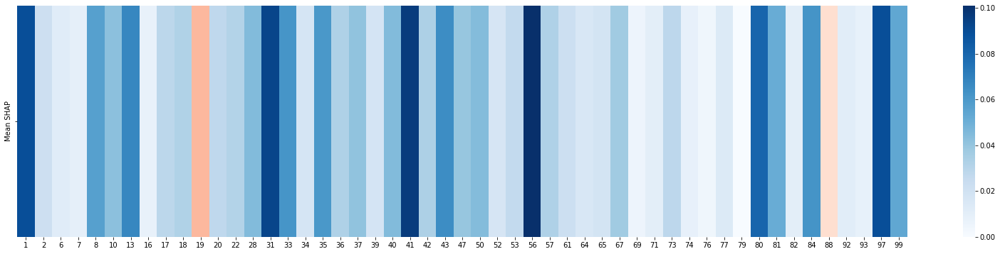

In [192]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Definition of explainability data.

In [193]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

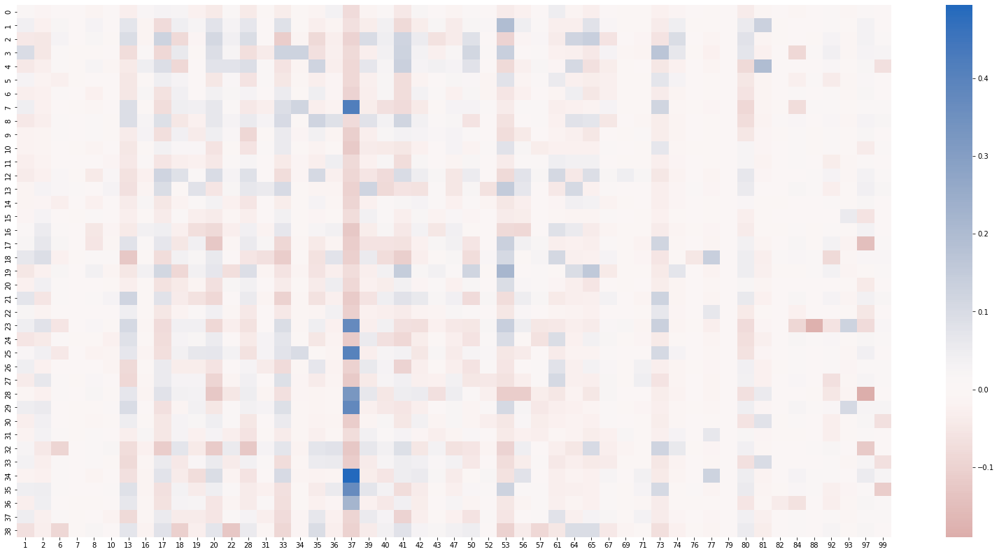

In [194]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [195]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

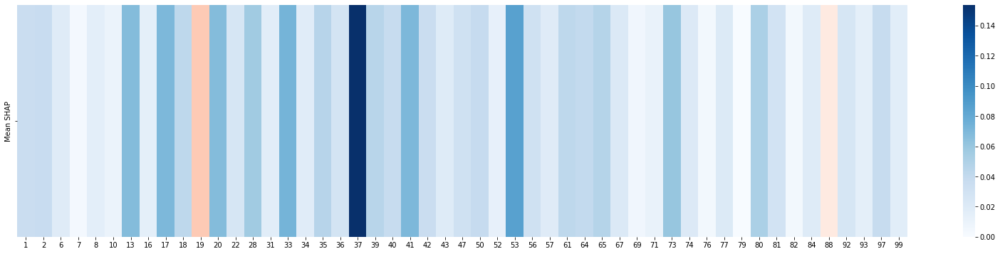

In [196]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Definition of explainability data.

In [197]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

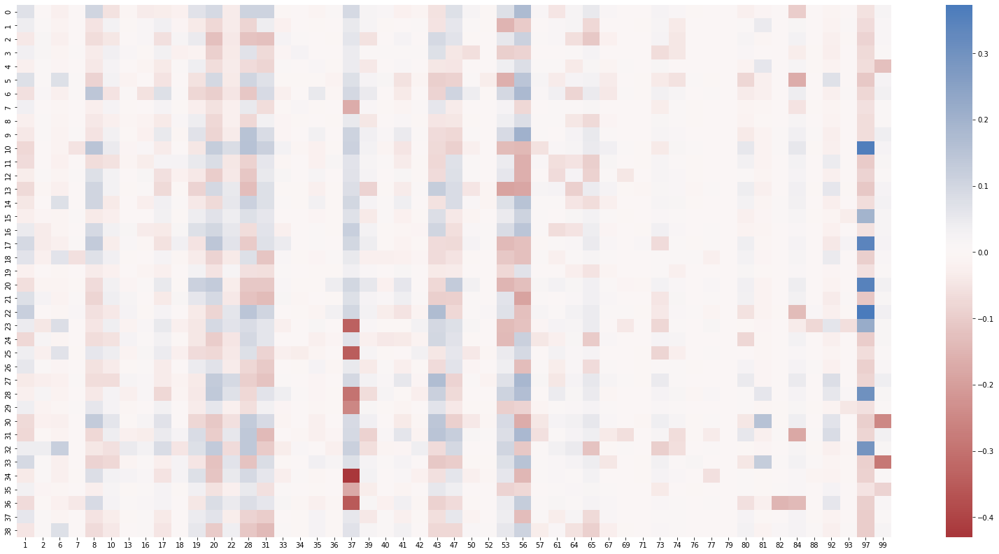

In [198]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [199]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

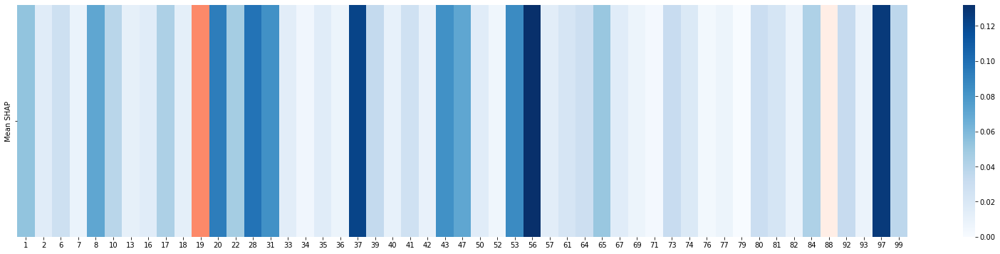

In [200]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

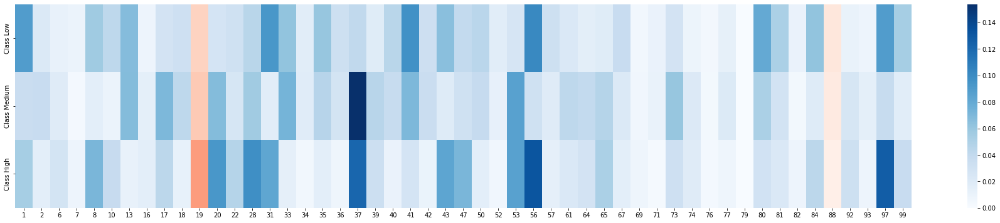

In [201]:
## Fusion of the previous heat maps.
df_shap = pd.concat(map_class, axis=1)
df_shap.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_shap.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_shap.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using LIME

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of LIME.

In [202]:
## Data preparation for explainability.
lime_exp = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                  feature_names=train_cols, class_names=target_names,
                                                  discretize_continuous=True)

## Class index local variable.
iterable_class = -1
map_class = []

Obtaining the data for the generation of the explanations by LIME about the Low, Medium and High classes.

In [203]:
## Local variables for LIME array data.
exp_matrix = [[] for _ in range(len(name_class))]

## Recovering the data needed for LIME.
for x in X_test.to_numpy():
    
    ## Auxiliary temporary variables.
    exp_list = [[] for _ in range(len(name_class))]
    
    ## Loading the data for explainability.
    exp = lime_exp.explain_instance(x, mlp.predict_proba, num_features = df.shape[1] - 1, top_labels = len(name_class))
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
        temp = exp.as_map()[elements]
        temp.sort(key=itemgetter(0))
        
        ## Saving data of the Low, Medium and High classes.
        for tup in temp:
            exp_list[elements].append(tup[1])
            
        exp_matrix[elements].append(exp_list[elements])

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

### Individual explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

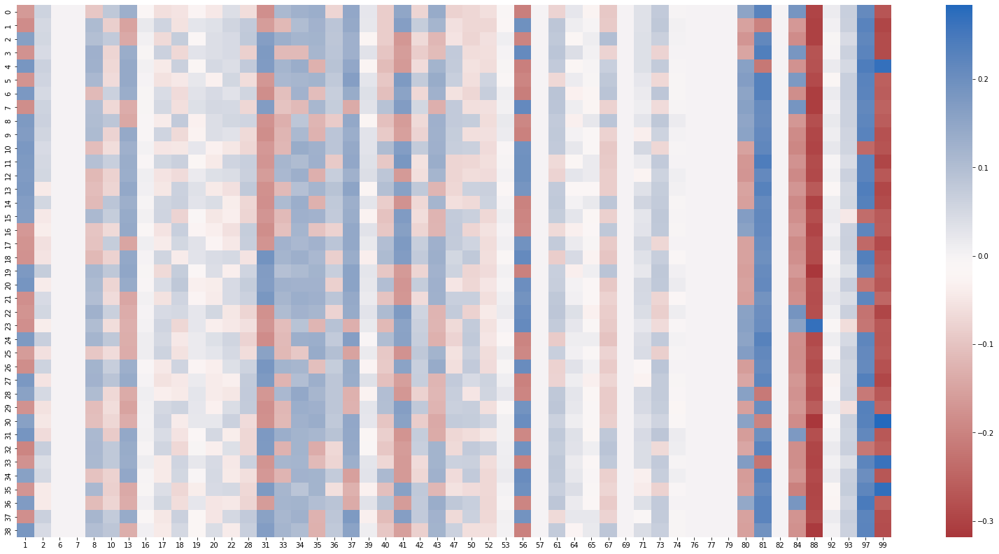

In [204]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

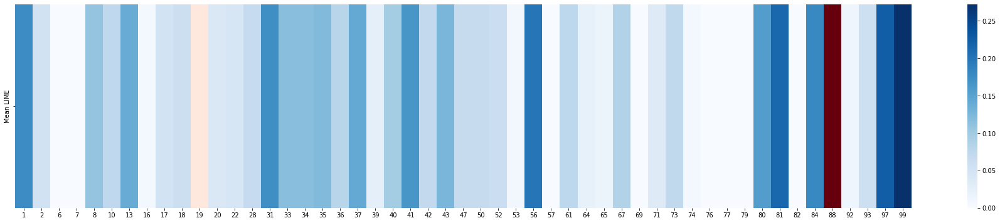

In [205]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

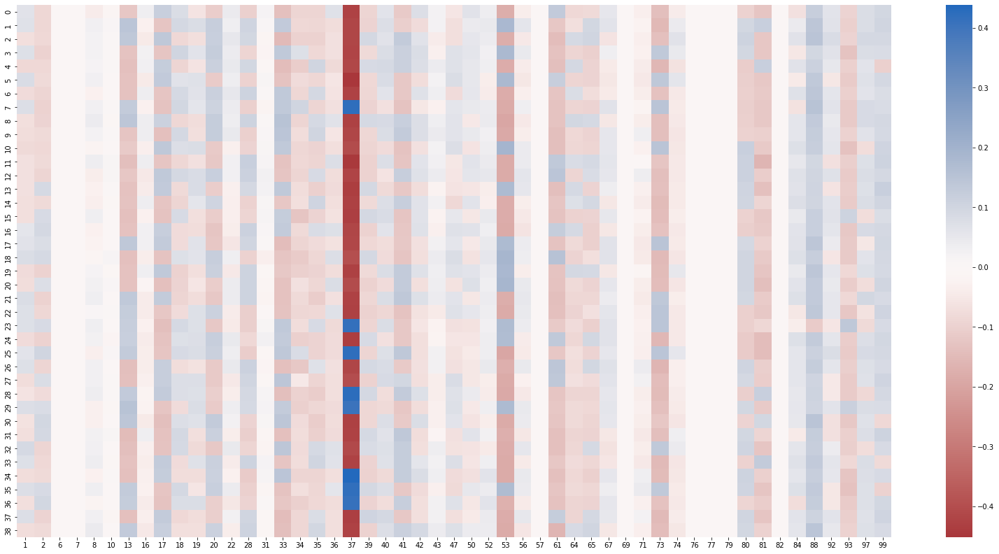

In [206]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

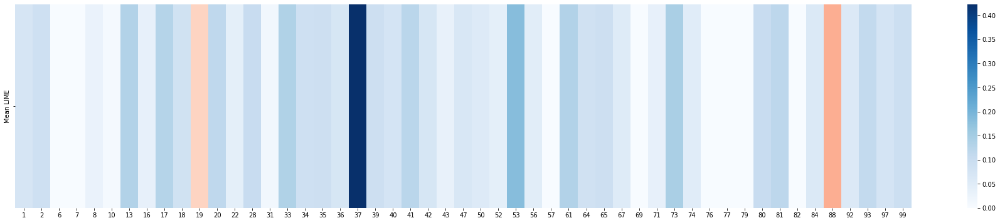

In [207]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Generation of the heat map.

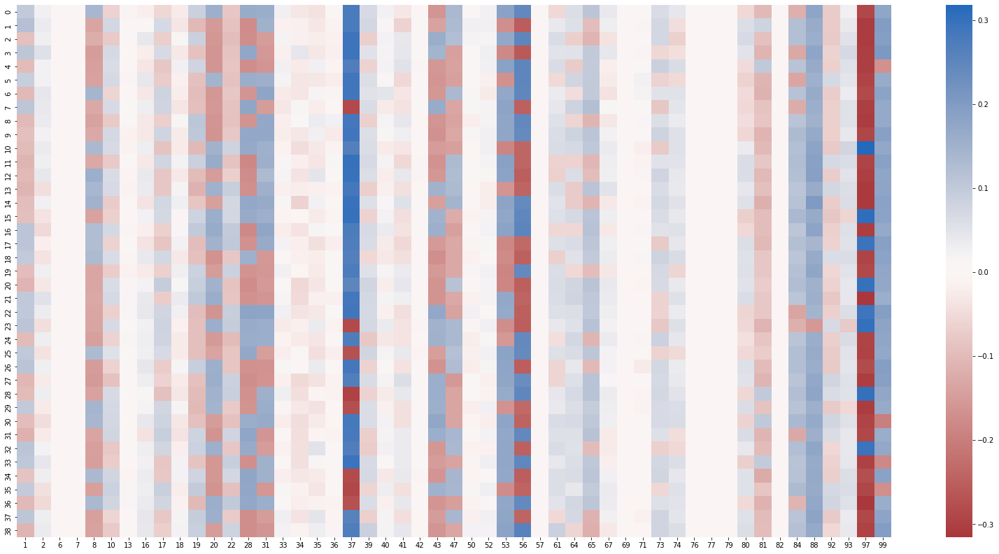

In [208]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

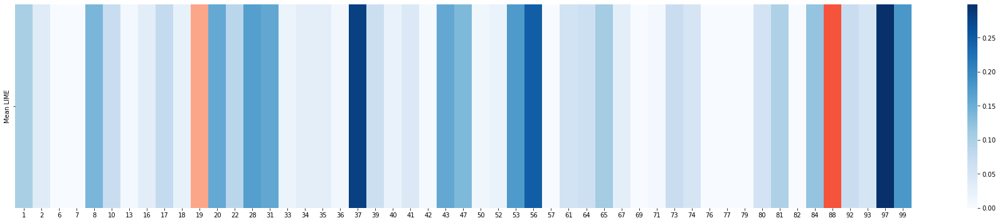

In [209]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

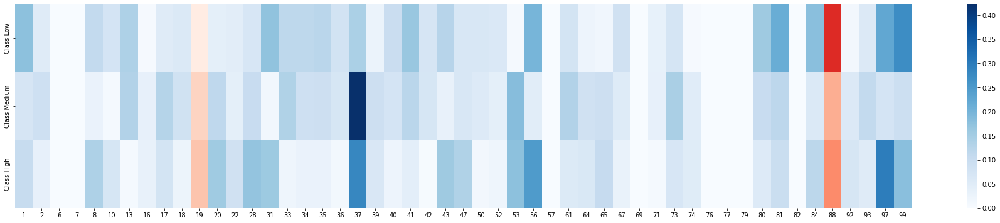

In [210]:
df_lime = pd.concat(map_class, axis=1)
df_lime.columns = name_class
plt.figure(figsize = (32,6))
sns.heatmap(df_lime.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_lime.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using ALE

It shows the main effect of each question compared to the probability that the model predicts in each class. This effect is shown for both responses. Since there are only 2 answers, the map is the same but with the colors reversed.

In [211]:
## Definition of explainability data.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names=train_cols, target_names= target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

## Class index local variable.
iterable_class = -1
map_class = []

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

Obtaining the data for the generation of the explanations by ALE about the all classes.

In [212]:
## Local variables for ALE array data.
ale_list = [[] for _ in range(len(name_class))]

## Recovering the data needed for ALE.
for array in proba_exp_lr.ale_values:
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
    
        ## Saving data of the all classes.
        ale_list[elements].append(array[0][elements])

Data processing for the explainability of ALE.

In [213]:
## Data processing of the Low, Medium and High classes.
for elements in range(0, len(name_class)):
    ale_df = pd.DataFrame([ale_list [elements]])
    ale_df = pd.concat([ale_df.multiply(-1), ale_df])
    ale_df.index = [name_class [elements] + " - False", name_class [elements] + " - True"]
    ale_df.columns = column_Map
    map_class.append(ale_df)

### Explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

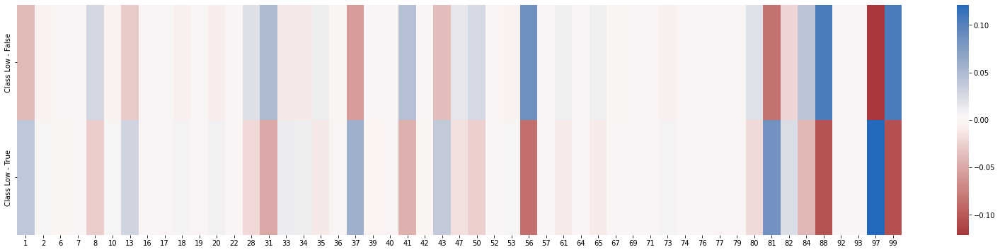

In [214]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

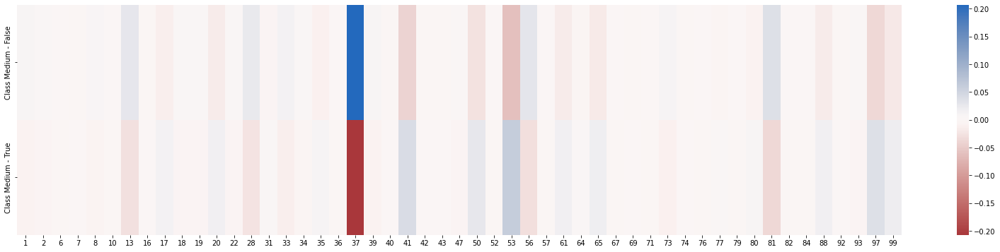

In [215]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

Generation of the heat map.

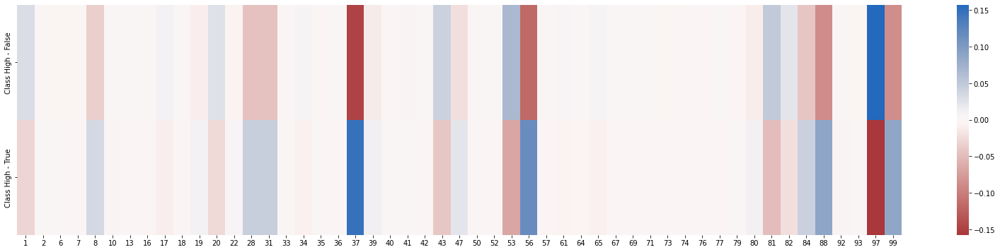

In [216]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used in all classes.

In [217]:
## Application of absolute value to data.
for index in range(0, len(map_class)):
    map_class [index] = map_class [index][0:1].abs()

## Union of the heat maps of the Low, Medium and High class.
ale_df = pd.concat(map_class)
ale_df.index = name_class
ale_df = ale_df.transpose()

Generation of the heat map.

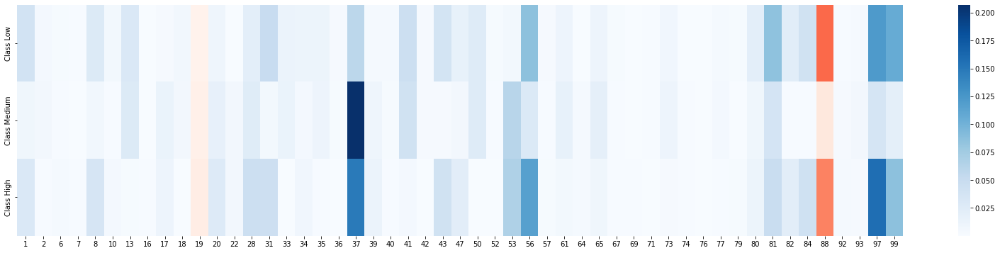

In [218]:
plt.figure(figsize = (28,6))
sns.heatmap(ale_df.transpose(), cmap="Reds", cbar = False)
sns.heatmap(ale_df.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask= df_mask_imp.to_numpy())
plt.show()

## Comparing of Important Variables Methods for Explainability

The global values of each of the methods used are taken, their maximums are obtained (the minimums are 0) and a percentage is calculated based on said maximum, which indicates how relevant the contribution is for each question.

In [219]:
## Class index local variable.
iterable_class = -1

### Comparison of the explanation methods of the first class, in this case the Low.

The highest data of each method used is obtained.

In [220]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [221]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,10,13,16,17,18,...,79,80,81,82,84,88,92,93,97,99
Importance,37.142857,40.000000,0.000000,0.000000,68.571429,71.428571,74.285714,8.571429,0.000000,51.428571,...,0.000000,100.000000,0.000000,0.000000,45.714286,0.000000,8.571429,0.000000,28.571429,60.000000
LIME,60.401283,18.122723,0.000000,0.000000,37.608075,25.653835,47.834473,2.161938,17.726572,20.687345,...,0.000000,54.246405,73.771907,0.000000,62.081989,100.000000,4.309147,19.939081,77.239827,93.880745
SHAP,88.513558,21.715868,11.386413,9.104381,56.386708,41.917536,66.489272,7.734752,28.499256,31.862636,...,0.000000,79.325831,51.000972,10.502295,61.491051,12.933725,11.010077,7.824774,88.473597,53.329844
ALE,32.136914,3.933515,1.920797,1.050437,23.105828,4.598129,24.945188,0.394137,2.481693,5.701884,...,1.358081,16.699304,70.197511,19.149363,33.723731,85.968202,0.854995,2.397132,100.000000,87.483017


Generation of the heat map.

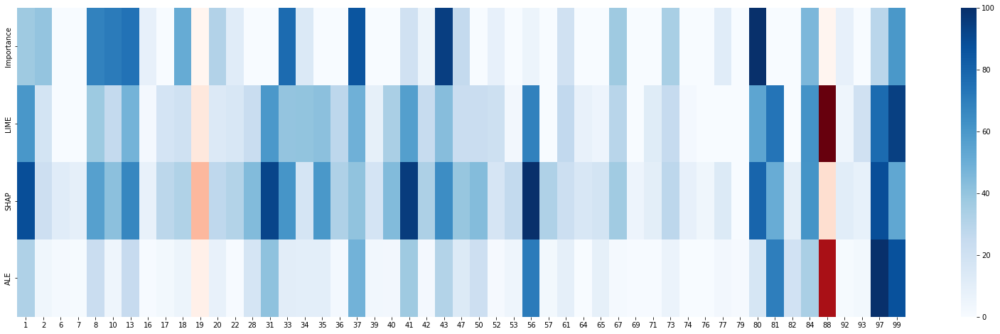

In [222]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the second class, in this case the Medium.

The highest data of each method used is obtained.

In [223]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [224]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,10,13,16,17,18,...,79,80,81,82,84,88,92,93,97,99
Importance,5.555556,38.888889,16.666667,0.000000,0.000000,0.000000,27.777778,22.222222,0.000000,0.000000,...,0.000000,27.777778,5.555556,0.000000,33.333333,22.222222,33.333333,0.000000,77.777778,0.000000
LIME,17.147697,20.891936,0.000000,0.000000,6.944844,1.564595,31.445454,8.476519,30.312948,19.837462,...,0.000000,24.056017,27.742910,0.000000,14.158653,29.051329,13.684313,26.087923,17.702000,21.982308
SHAP,23.376155,24.064456,12.316290,2.012647,10.084651,6.156012,43.996921,9.536227,45.678972,27.430077,...,0.000000,33.477907,18.776834,2.393195,12.521145,6.508578,16.451735,9.713299,24.557032,11.068560
ALE,4.128651,2.997056,0.499666,0.042934,3.331763,0.445826,13.610085,0.370586,6.578984,3.092320,...,0.162846,4.186445,17.708103,0.520271,0.570311,8.055932,1.450016,2.921231,17.439213,9.509067


Generation of the heat map.

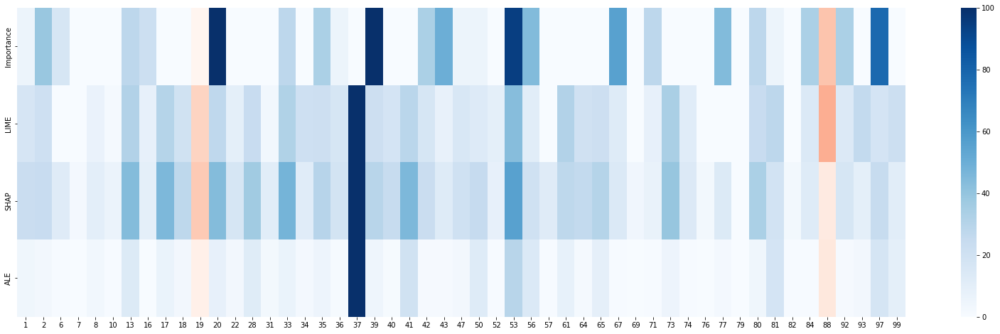

In [225]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the third class, in this case the High.

The highest data of each method used is obtained.

In [226]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [227]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,10,13,16,17,18,...,79,80,81,82,84,88,92,93,97,99
Importance,17.500000,9.714451e-14,0.000000,2.500000,35.000000,30.000000,0.000000,17.500000,20.000000,5.000000,...,0.000000,22.500000,5.000000,2.500000,27.500000,12.500000,0.000000,0.000000,100.000000,65.000000
LIME,34.346697,1.197726e+01,0.000000,0.000000,46.320857,23.456273,2.426526,10.786469,25.692784,7.996509,...,0.000000,18.598655,32.328446,0.000000,40.207217,55.927845,23.301437,17.567256,100.000000,59.992877
SHAP,40.553311,1.139386e+01,21.285689,6.291824,53.782528,29.076709,8.667001,11.711181,32.968080,9.460120,...,0.000000,22.491365,17.202614,6.119421,32.783810,4.385396,24.712792,6.043110,96.069353,27.914729
ALE,19.339387,9.091142e-01,2.137344,0.866025,22.188443,2.957587,1.330063,0.791027,6.737730,0.328511,...,1.260792,7.365621,30.817782,14.074349,26.740774,55.663414,2.565498,1.993506,100.000000,54.920230


Generation of the heat map.

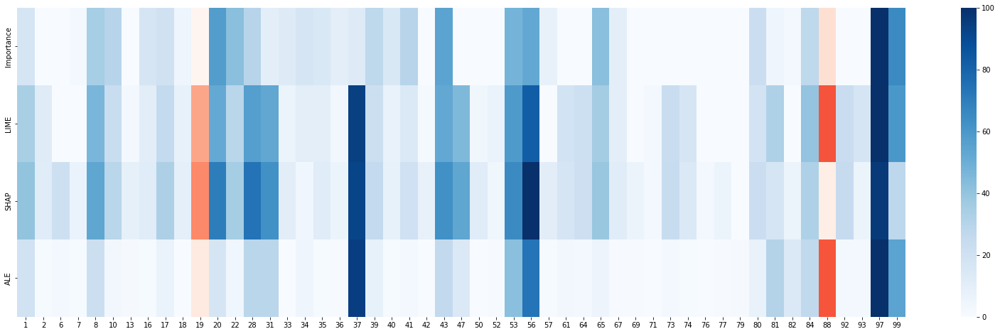

In [228]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

Safeguarding the questions eliminated during this iteration.

In [229]:
## Removal of anomalous questions selected by selection_mode.
for x in question_anomaly:

    ## Status change of the deleted question in the respective auxiliary dataset.
    ds.loc[x - 1,'Status'] = 'Delete'

## Save the changed statuses in the dataset.
ds.to_csv(path_dataset_qs, index = False)

## Iteration 3

The first iteration of improvement of the model is carried out.

## Preparing the data for the neural network

The data is prepared in order to be processed by the neural network.

In [230]:
## The iteration number is increased.
iteration += 1

## Loading data from the dataset.
df = pd.read_csv(path_dataset)
ds = pd.read_csv(path_dataset_qs)

## Elimination of unrelated questions from the dataset.
if len(unrelated_questions) != 0:
    df = df.drop(df.columns[unrelated_questions[0]:unrelated_questions[1]], axis=1)

i = 0
if iteration == 1:
    ## Elimination of list of conflicting questions declared in global variables.
    for x in list_contr:
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1
        ## Status change of the deleted question in the respective auxiliary dataset.
        ds.loc[x - 1,'Status'] = 'Delete'
    
else:    
    ## Elimination of the list of anomadic questions defined in the improvement process.
    ds_delete = ds[ds.Status == "Delete"].reset_index(drop=True)
    for x in ds_delete['Question'].tolist():
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1

## Grouping of the target according to the defined dictionary.
if grouping_name != None and grouping_name != '':
    df[grouping_name] = df[grouping_name].map(class_dic)

## Assignment of local variables according to the data necessary for the neural network.
train_cols = df.columns [0:-1]
label = df.columns [-1]
X = df [train_cols]
y = df [label]

## The prepared data of the dataset is printed.
df

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,18. I don't feel as comfortable with my body as I did before,...,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns,Target
0,1,1,1,1,1,0,0,0,0,0,...,1,1,0,1,0,0,0,0,0,0
1,1,0,1,1,1,0,1,1,1,0,...,1,1,0,1,1,0,0,0,0,0
2,0,0,1,1,0,1,0,1,0,1,...,1,0,0,1,0,0,0,0,0,1
3,0,0,1,1,1,0,1,0,0,1,...,1,0,0,1,0,1,0,1,0,2
4,1,1,1,0,1,1,0,1,1,0,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,1,1,1,1,1,1,1,0,0,1,...,1,1,1,1,0,1,0,1,1,2
100,1,1,1,1,0,0,1,0,0,0,...,1,0,0,1,0,0,0,1,0,1
101,0,0,1,1,0,1,1,1,0,1,...,1,0,0,1,1,1,0,0,1,0
102,1,0,1,1,1,1,0,0,1,1,...,1,0,0,1,1,1,0,0,0,2


## Oversample application

An oversample process is applied to level the amount of existing data given by the grouping.

In [231]:
## The number of elements present in the grouped target is printed.
y.value_counts()

0    39
1    35
2    30
Name: Target, dtype: int64

Oversample application.

In [232]:
## Application of the oversample to the prepared data.
X, y = oversample.fit_resample(X, y)

Printing of the data after the application of the oversample.

In [233]:
## The results obtained after applying the oversample are printed.
y.value_counts()

0    39
1    39
2    39
Name: Target, dtype: int64

## Preparation of the parameters of the neural network

We proceed to define the parameters necessary for the training of the neural network.

In [234]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=seed)

## Neural network training

The alpha parameters and the initial learning rate are adjusted to obtain the best performance with the model
using cross validation.

In [235]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_normal

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = regul_param, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.16329749103942653,
  0.18026037160631153,
  0.16659498207885304,
  0.16659498207885304,
  0.16659498207885304,
  0.16659498207885304,
  0.16659498207885304,
  0.16659498207885304,
  0.16659498207885304],
 [0.006619092595549127,
  0.028021044395542195,
  0.006020651927912844,
  0.006020651927912844,
  0.006020651927912844,
  0.006020651927912844,
  0.006020651927912844,
  0.006020651927912844,
  0.006020651927912844])

We proceed to draw the learning curve graph according to the data obtained by the training.

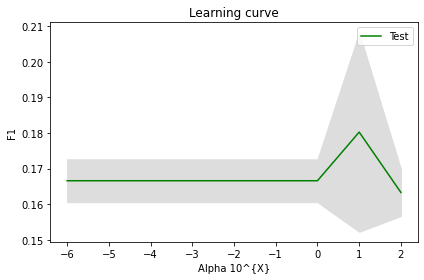

In [236]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Alpha 10^{X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

The training is performed again keeping the same parameters except for the alpha value that changes to 1.

In [237]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_alpha

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = regul_param, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.18578597030209934,
  0.4657540716364246,
  0.4830854439677969,
  0.4718491009048285,
  0.16659498207885304,
  0.16659498207885304,
  0.16659498207885304],
 [0.03912815731541059,
  0.08131191266979419,
  0.07748179685218214,
  0.08743387745396868,
  0.006020651927912844,
  0.006020651927912844,
  0.006020651927912844])

We proceed to draw the learning curve graph according to the data obtained by the training.

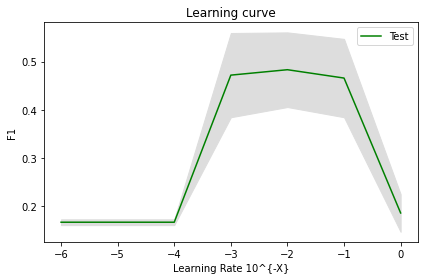

In [238]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Learning Rate 10^{-X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

## Generation of the neural network model

The parameters of the final model are modified according to the data obtained in the training of the neural network.

In [239]:
## The value of the alpha parameter, learning_rate_init and random_state are changed according
## to the data in the global variables.
mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = alpha,
                            learning_rate = 'constant', learning_rate_init = learning_rate_init, max_iter = 100000,
                            random_state = random_state_model)

## We print the data of the final generated model.
mlp.fit(X_train, y_train)

MLPClassifier(activation='logistic', alpha=0.001, hidden_layer_sizes=(10,),
              learning_rate_init=0.1, max_iter=100000, random_state=42)

We safeguard the final generated model

In [240]:
joblib.dump(mlp,"model_depression_i" + str(iteration) + ".pkl")

['model_depression_i3.pkl']

## Generation of the confusion matrix of the model

We obtain the statistics of the final model to generate its confusion matrix.

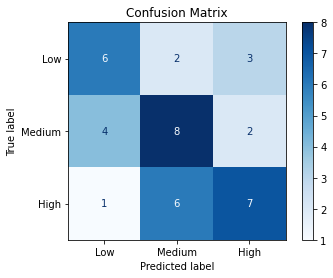

In [241]:
## The data for the generation of the confession matrix are defined.
confusion_matrix = ConfusionMatrixDisplay.from_estimator(mlp, X_test, y_test, display_labels = target_names,
                                                         cmap = plt.cm.Blues)
confusion_matrix.ax_.set_title("Confusion Matrix")
plt.show()

We get the detailed statistics of the final model.

In [242]:
## The necessary detailed prediction is generated.
y_pred = mlp.predict(X_test)

## The detailed statistics of the model are printed.
print('Classification accuracy =',accuracy_score(y_test,y_pred) * 100,'%\n')
print(classification_report(y_test,y_pred))

Classification accuracy = 53.84615384615385 %

              precision    recall  f1-score   support

           0       0.55      0.55      0.55        11
           1       0.50      0.57      0.53        14
           2       0.58      0.50      0.54        14

    accuracy                           0.54        39
   macro avg       0.54      0.54      0.54        39
weighted avg       0.54      0.54      0.54        39



The data obtained is saved for later graphing.

In [243]:
accuracy = accuracy_score(y_test,y_pred) * 100
clf_rep = precision_recall_fscore_support(y_test,y_pred)

## The number of questions used in the iteration is retrieved.
ds_delete = ds[ds.Status == "Delete"]
ds_delete.reset_index(inplace=True, drop=True)

## All the metrics of the confusion matrix are obtained.
metrics = [",".join(map(str, ds_delete['Question'].tolist())), accuracy, clf_rep[0][0], clf_rep[1][0],
           clf_rep[2][0], clf_rep[3][0],clf_rep[0][1], clf_rep[1][1], clf_rep[2][1], clf_rep[3][1],
           clf_rep[0][2], clf_rep[1][2], clf_rep[2][2], clf_rep[3][2]]

## The names of the columns of the dataset are defined.
columns = ['Question','Acurracy global','Precision_0','Recall_0','F1_score_0', 'Support_0',
           'Precision_1','Recall_1','F1_score_1', 'Support_1','Precision_2','Recall_2','F1_score_2','Support_2']

## A new row of the dataset is generated with all the data.
data = pd.DataFrame([metrics], columns = columns)

## The data is saved to the dataset.
data.to_csv(path_dataset_qd, mode = 'a', header = False, index = False)

## The data added to the dataset is printed.
data

,Question,Acurracy global,Precision_0,Recall_0,F1_score_0,Support_0,Precision_1,Recall_1,F1_score_1,Support_1,Precision_2,Recall_2,F1_score_2,Support_2
0,"3,4,5,9,11,12,14,15,19,21,23,24,25,26,27,29,30...",53.846154,0.545455,0.545455,0.545455,11,0.5,0.571429,0.533333,14,0.583333,0.5,0.538462,14


## Improvement process of the neural network model.

The application of the explanation method by ALE allows to determine the behavior of the neural network and thereby improve it by discarding non-significant data for it.

## Slope Analysis of ALE Plots

In [244]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

We proceed to obtain the graphs to obtain the slopes of the selected classes.

In [245]:
## The question metrics dataset is loaded.
dm = pd.DataFrame()

## The number of questions used in the iteration is retrieved.
ds_item = ds[ds.Status == "In use"]
ds_item.reset_index(inplace=True, drop=True)

## We get the slopes from the ALE data.
for i in range(df.shape[1]-1):
    structure_data = {'Question': ds_item.loc[i, "Question"]}
    
    for index in selection_class:
        slope = proba_exp_lr.ale_values [i][1][index] - proba_exp_lr.ale_values [i][0][index]
        structure_data['Slope ' + str(target_names[index])] = slope
        structure_data['Threshold ' + str(target_names[index])] = 'NA'
        structure_data['Anomaly ' + str(target_names[index])] = 'NA'
        
    dm = dm.append(structure_data, ignore_index=True)
    
## The current rating data dataset is printed.
dm

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be remove

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.006614,NA,NA,-0.000607,NA,NA
1,2,-0.018055,NA,NA,-0.008497,NA,NA
2,6,-0.001865,NA,NA,-0.007545,NA,NA
3,7,-0.017367,NA,NA,0.018536,NA,NA
4,8,0.173014,NA,NA,-0.225715,NA,NA
5,10,-0.002792,NA,NA,0.012527,NA,NA
6,13,-0.047196,NA,NA,0.017650,NA,NA
7,16,0.007778,NA,NA,-0.004252,NA,NA
8,17,0.002405,NA,NA,0.028202,NA,NA
9,18,-0.088971,NA,NA,-0.010765,NA,NA


## Slope analysis and threshold application

The slope obtained is analyzed and those that are above or below the positive and negative threshold are selected.

In [246]:
for i in range(df.shape[1]-1):
    for index in selection_class:
        
        ## The slopes are selected according to the values of the thresholds of the defined classes.
        if dm.loc[i, "Slope " + str(target_names[index])] >= positive_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 1
        elif dm.loc[i, "Slope " + str(target_names[index])] <= negative_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 0
            
## The current rating data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.006614,NA,NA,-0.000607,NA,NA
1,2,-0.018055,0,NA,-0.008497,NA,NA
2,6,-0.001865,NA,NA,-0.007545,NA,NA
3,7,-0.017367,0,NA,0.018536,1,NA
4,8,0.173014,1,NA,-0.225715,0,NA
5,10,-0.002792,NA,NA,0.012527,1,NA
6,13,-0.047196,0,NA,0.017650,1,NA
7,16,0.007778,NA,NA,-0.004252,NA,NA
8,17,0.002405,NA,NA,0.028202,1,NA
9,18,-0.088971,0,NA,-0.010765,0,NA


## Analysis and determination of anomalous questions

The anomalous questions present in the model are determined based on their slope and expected response from the expert.

In [247]:
## The dataset of expected responses is loaded.
da = pd.read_csv(path_dataset_qa)

## Delete list of questions deleted in this iteration.
i = 0
for x in ds_delete['Question']:
    da.drop(da.index[x - (i + 1)], axis = 0, inplace = True)
    i += 1

## Indexes are restored for later use.
da.reset_index(inplace=True, drop=True)

## The dataset of expected responses is printed.
da

,Numero,Pregunta,RE
0,1,La mayor parte del tiempo tengo dificultad par...,1
1,2,No siento ganas de hacer mis deberes cotidianos,1
2,6,Considero que mi vida está llena de cosas buenas,0
3,7,Mis aficiones siguen siendo importante,0
4,8,Sigo siendo tan puntual como siempre he sido,0
5,10,Me he dado cuenta de que puedo pasar mucho tie...,1
6,13,Antes me sentía más animado para hacer mis act...,1
7,16,Creo que mis pensamientos son extraños o disti...,1
8,17,Siento culpa sobre las decisiones que he tomado,1
9,18,No me siento tan cómodo con mi cuerpo como me ...,1


We proceed to identify the anomadic questions present in the model present in this iteration.

In [248]:
for i in range(df.shape[1]-1):
    
    ## Local variable to indicate the index of the selected classes.
    i_index = 0
    
    for index in selection_class:
        
        ## Determine if it fails based on the expected response parameters of the defined classes.
        if dm.loc[i, "Threshold "  + str(target_names[index])] == 1 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][0]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 1 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][1]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][2]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly "  + str(target_names[index])] = expected_response_map[i_index][3]
        
        ## Increase of the index of the selected classes.
        i_index += 1

## The final grade data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.006614,NA,NA,-0.000607,NA,NA
1,2,-0.018055,0,0,-0.008497,NA,NA
2,6,-0.001865,NA,NA,-0.007545,NA,NA
3,7,-0.017367,0,1,0.018536,1,1
4,8,0.173014,1,0,-0.225715,0,0
5,10,-0.002792,NA,NA,0.012527,1,0
6,13,-0.047196,0,0,0.017650,1,0
7,16,0.007778,NA,NA,-0.004252,NA,NA
8,17,0.002405,NA,NA,0.028202,1,0
9,18,-0.088971,0,0,-0.010765,0,1


## Removing identified anomadic questions from the model

We proceed to eliminate the identified anomadic questions so as not to use them in the next iteration.

In [249]:
## Local variable for the elimination of the anomaly questions.
instructions = ''
init = False
question_anomaly = []

if selection_mode == 1:
    
    ## Questions that fail in the defined class are retrieved.
    dm_delete = dm[dm['Anomaly ' + str(target_names[select_class_mode])] == 1]
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 2:
    
    ## Questions that fail in classes defined with the or condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " or `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 3:
    
    ## Questions that fail in classes defined with the and condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 4:
    
    ## Out-of-threshold questions are retrieved in classes defined with the condition type and.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 'NA'"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 'NA'"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()

## The selected blank questions are printed according to the selection_mode.
question_anomaly

[7, 18, 41, 42, 77]

## Model explainability process

The data used for the test of the neural network model is shown.

In [250]:
X_test

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,7. My hobbies are still important to me,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,18. I don't feel as comfortable with my body as I did before,...,77. I would regret betraying a friend,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns
69,1,0,1,1,0,0,0,0,0,1,...,1,1,1,0,1,1,0,0,0,0
46,1,0,1,1,1,1,1,1,1,1,...,1,1,0,1,1,0,0,0,0,0
58,0,0,1,1,1,0,1,1,0,0,...,1,1,0,0,1,0,0,0,0,0
114,1,0,1,1,1,1,0,0,1,1,...,1,1,0,0,1,1,0,0,0,0
73,0,0,1,1,1,1,0,0,0,0,...,1,1,1,1,1,0,0,0,0,1
98,1,0,0,1,1,1,0,1,0,1,...,1,1,1,0,1,1,1,0,0,0
31,0,0,1,1,0,0,0,0,1,1,...,1,1,1,0,1,0,0,0,0,0
53,1,0,1,1,1,1,1,1,1,1,...,1,1,1,0,1,1,0,0,0,0
65,0,0,1,1,1,0,1,0,0,0,...,1,1,1,0,1,0,0,0,0,0
96,0,0,1,1,1,1,0,0,1,1,...,1,1,1,0,1,0,0,0,0,0


## Explanation of the model using ALE

In analysis of the model through the results obtained by ALE, it is possible to identify the behavior of the neural network.

In [251]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

The graphs of all the data present in the dataset used are shown.

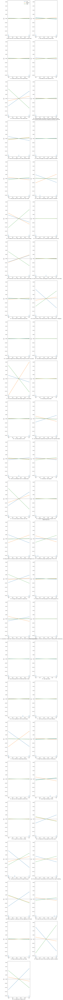

In [252]:
plot_ale(proba_exp_lr, n_cols=2, features=list(range(df.shape[1]-1)),fig_kw={'figwidth': 10, 'figheight': 180});

## Explanation of the model using LIME

We proceed to explain the improved model using LIME for the Low, Medium and High classes.

In [253]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                   feature_names=train_cols, class_names=target_names, 
                                                   discretize_continuous=True)

The first individual present in the test data is explained.

In [254]:
exp = explainer.explain_instance(X_test.to_numpy()[0], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The second individual present in the test data is explained.

In [255]:
exp = explainer.explain_instance(X_test.to_numpy()[1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The last individual present in the test data is explained.

In [256]:
exp = explainer.explain_instance(X_test.to_numpy()[-1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


## Explanation of the model using SHAP

SHAP explanatory values are displayed according to the class to which the selected individual belongs according to the prediction of the model.

The first individual present in the test data is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

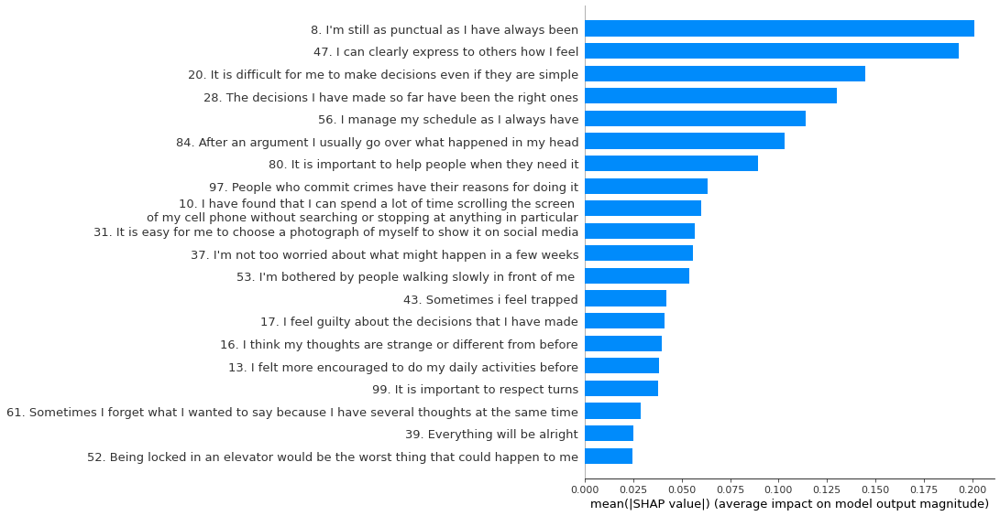

In [257]:
## Individual Selection.
individual = X_test.iloc[[0]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The second individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

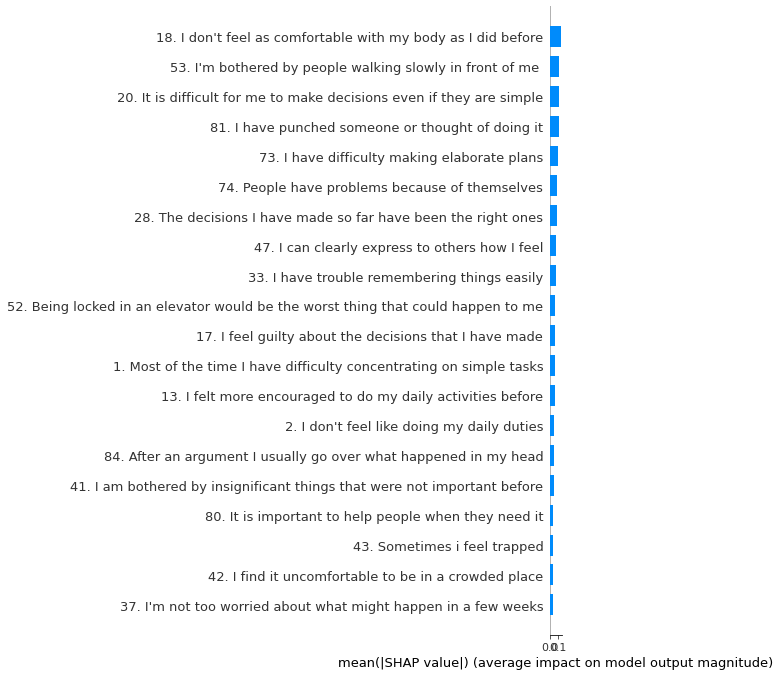

In [258]:
## Individual Selection.
individual = X_test.iloc[[1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The last individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

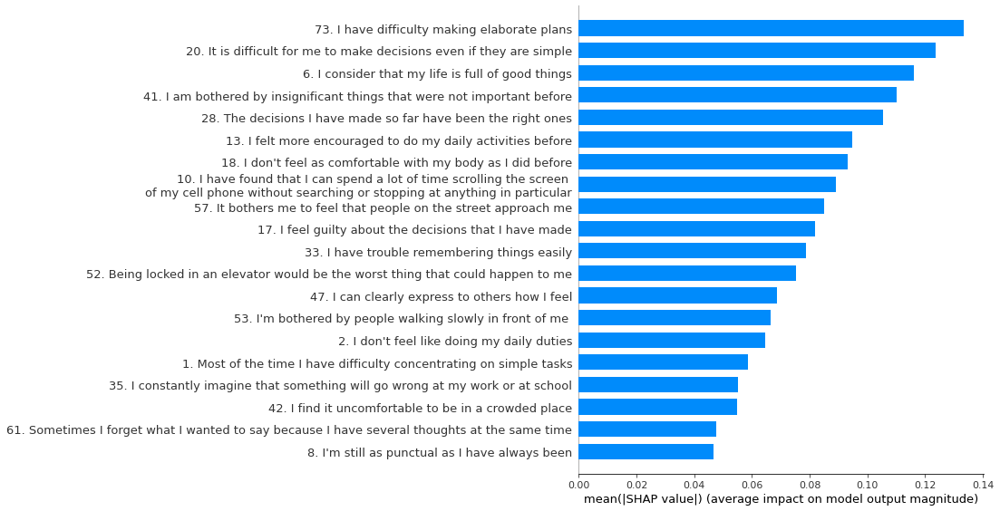

In [259]:
## Individual Selection.
individual = X_test.iloc[[-1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

## Explanation using heatmaps

The importance of the data present in the neural network is shown from explanation methods.

In [260]:
## Questions currently in use are retrieved.
ds_item = ds[ds.Status == "In use"].reset_index(drop=True)

## The data is prepared for the generation of heat maps.
column_Map = ds_item['Question'].tolist()
content_Map = [False for x in range(1, df.shape[1])]

## The next questions to be deleted will be marked.
for index in range(0, len(content_Map)):
    
    if iteration == 0:
        for delete in list_contr:
            if column_Map[index] == delete:
                content_Map [index] = True
    else:
        for delete in question_anomaly:
            if column_Map[index] == delete:
                content_Map [index] = True

## The dataframe is created with the prepared data.
df_mask = pd.DataFrame([content_Map], columns = column_Map)
df_mask_imp = pd.concat([df_mask, df_mask, df_mask], ignore_index = True, axis = 0)
df_mask_all = pd.concat([df_mask, df_mask, df_mask, df_mask], ignore_index = True, axis = 0)

df_mask

,1,2,6,7,8,10,13,16,17,18,...,77,79,80,81,82,84,92,93,97,99
0,False,False,False,True,False,False,False,False,False,True,...,True,False,False,False,False,False,False,False,False,False


### Identification of important variables

Identification of important variables from the randomness of the answers as questions of the data.

In [261]:
## Loading the data for explainability.
explainer = ClassifierExplainer(mlp, X_test, y_test)

## Class index local variable.
iterable_class = -1
map_class = []

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')


### Explainability of the data belonging to the first class, in this case the Low.

Calculating permutation importances (if slow, try setting n_jobs parameter)...


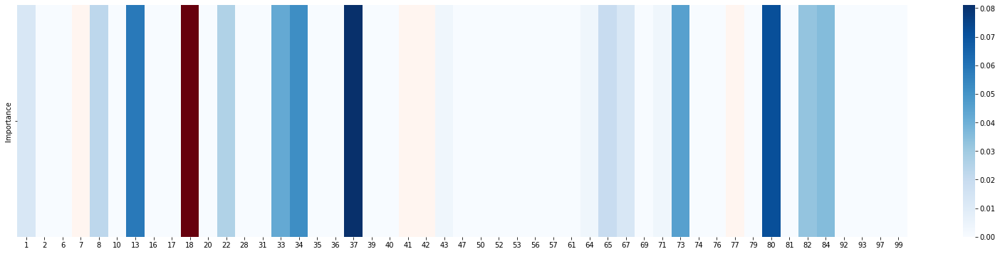

In [262]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

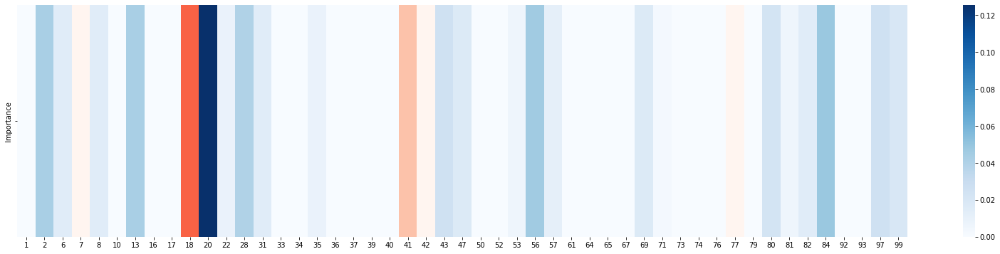

In [263]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

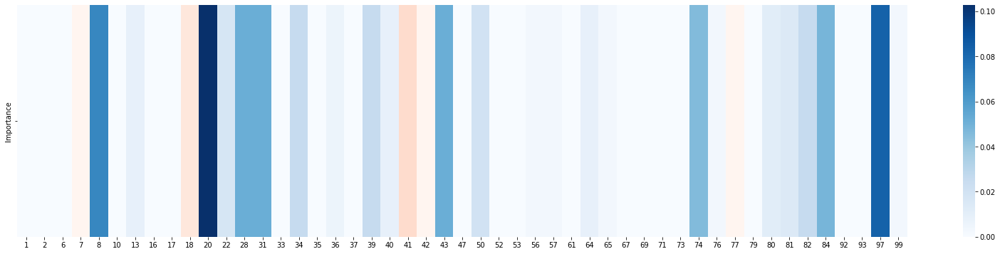

In [264]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

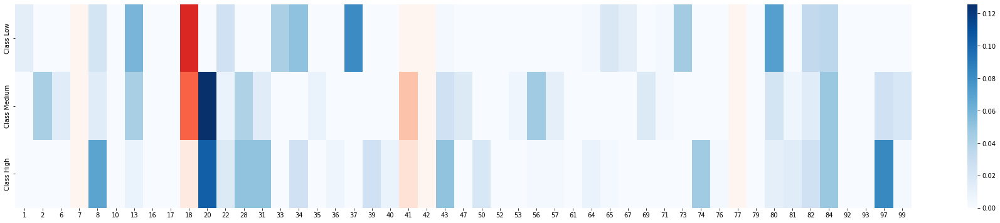

In [265]:
## Fusion of the previous heat maps.
df_importance = pd.concat(map_class, axis=1)
df_importance.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_importance.transpose(), cmap = "Reds", cbar = False)
sns.heatmap(df_importance.transpose(), cmap = "Blues",yticklabels = True, xticklabels = True ,mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using SHAP

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of SHAP.

In [266]:
## Class index local variable.
iterable_class = -1
map_class = []

### Individual explainability of the data belonging to the first class, in this case the Low.

Definition of explainability data.

In [267]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Calculating shap values...


  0%|          | 0/39 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

Generation of the heat map.

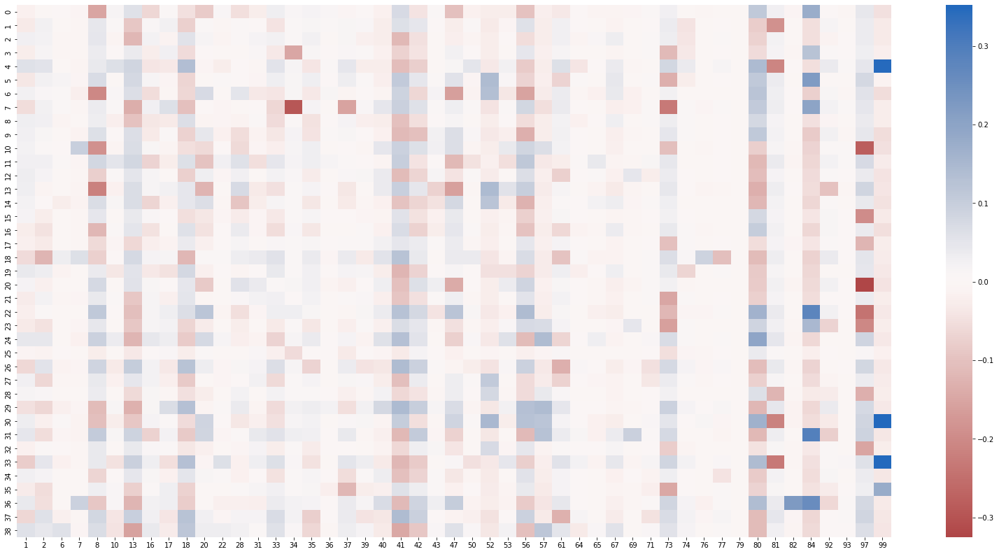

In [268]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [269]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

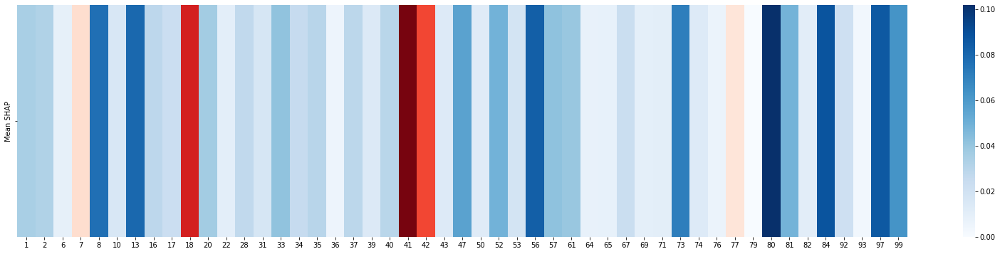

In [270]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Definition of explainability data.

In [271]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

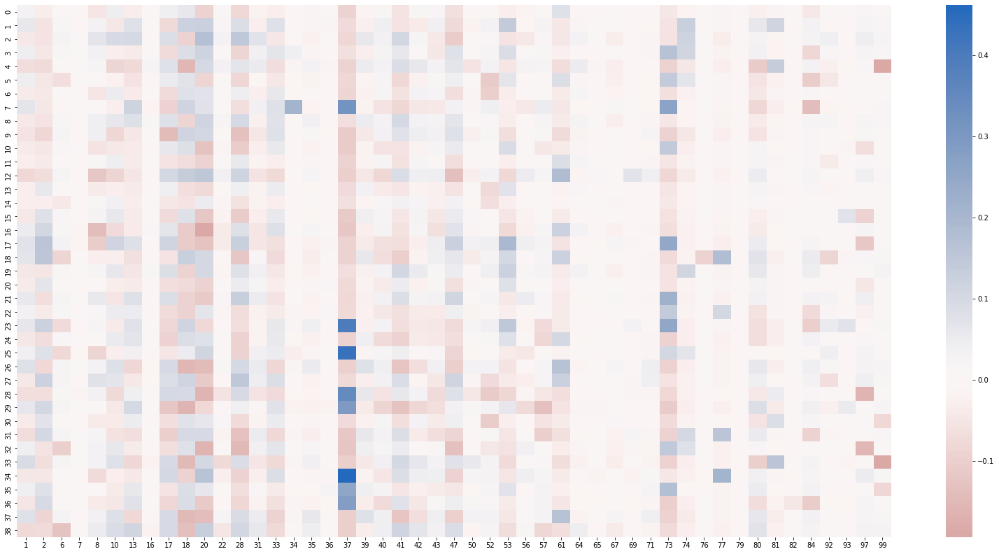

In [272]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [273]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

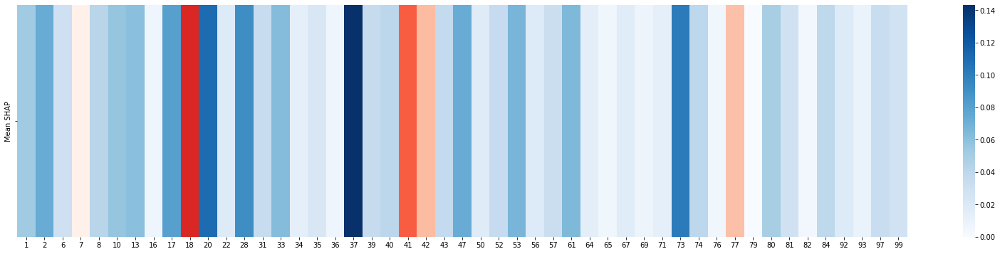

In [274]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Definition of explainability data.

In [275]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

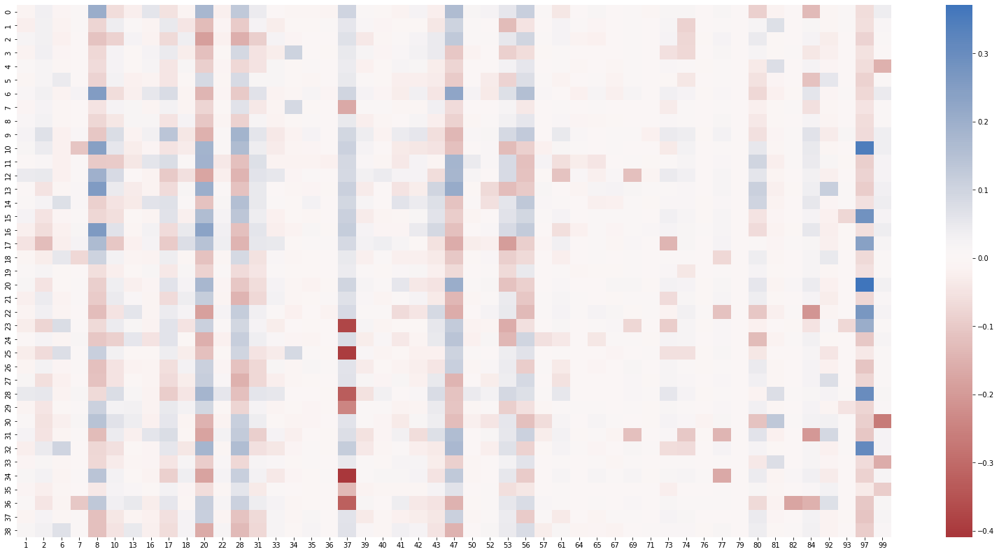

In [276]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [277]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

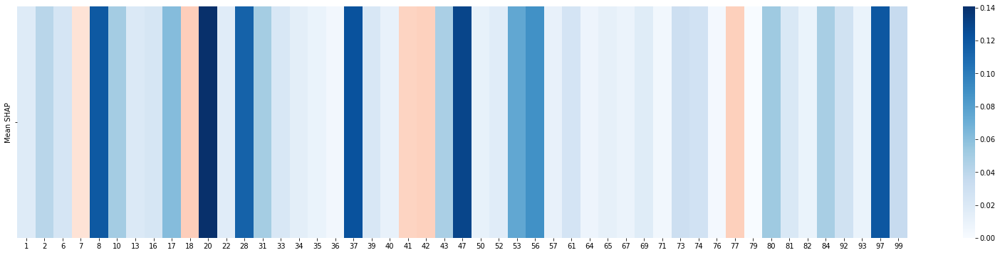

In [278]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

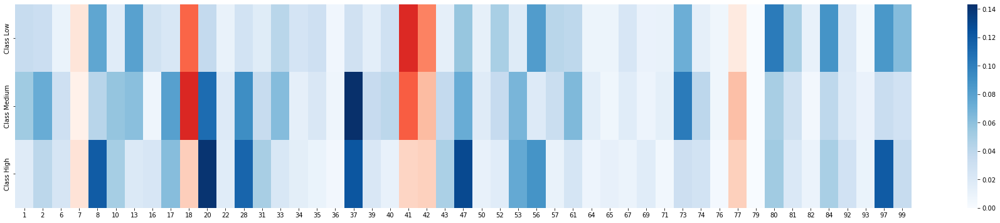

In [279]:
## Fusion of the previous heat maps.
df_shap = pd.concat(map_class, axis=1)
df_shap.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_shap.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_shap.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using LIME

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of LIME.

In [280]:
## Data preparation for explainability.
lime_exp = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                  feature_names=train_cols, class_names=target_names,
                                                  discretize_continuous=True)

## Class index local variable.
iterable_class = -1
map_class = []

Obtaining the data for the generation of the explanations by LIME about the Low, Medium and High classes.

In [281]:
## Local variables for LIME array data.
exp_matrix = [[] for _ in range(len(name_class))]

## Recovering the data needed for LIME.
for x in X_test.to_numpy():
    
    ## Auxiliary temporary variables.
    exp_list = [[] for _ in range(len(name_class))]
    
    ## Loading the data for explainability.
    exp = lime_exp.explain_instance(x, mlp.predict_proba, num_features = df.shape[1] - 1, top_labels = len(name_class))
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
        temp = exp.as_map()[elements]
        temp.sort(key=itemgetter(0))
        
        ## Saving data of the Low, Medium and High classes.
        for tup in temp:
            exp_list[elements].append(tup[1])
            
        exp_matrix[elements].append(exp_list[elements])

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

### Individual explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

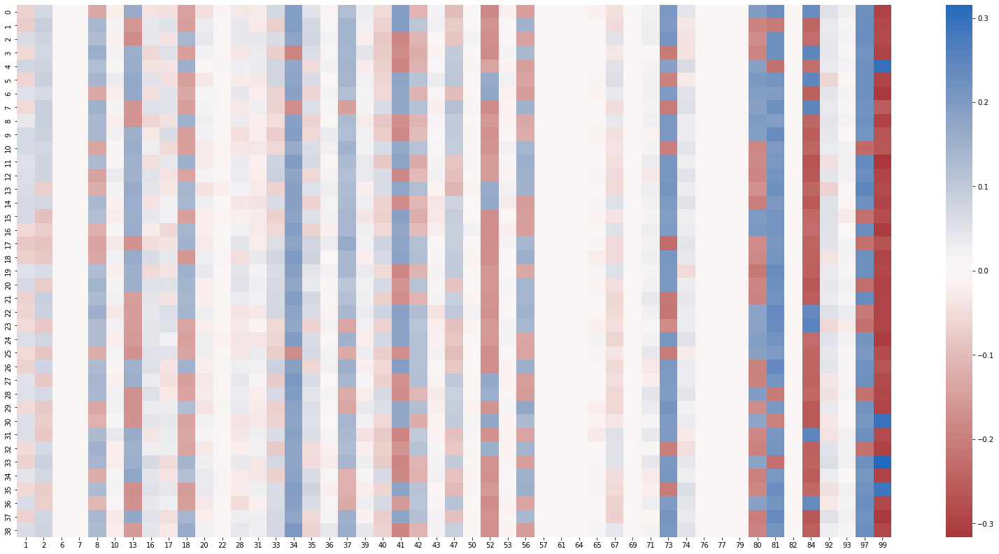

In [282]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

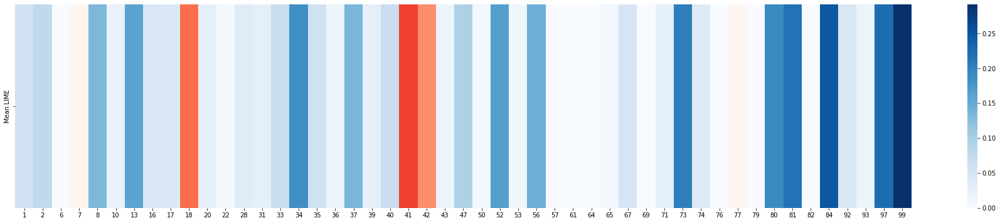

In [283]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

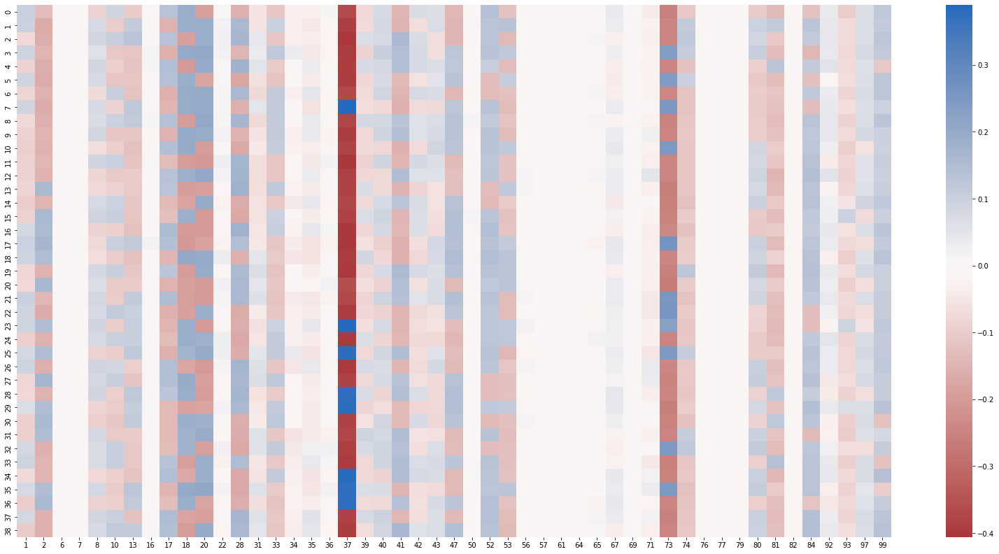

In [284]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

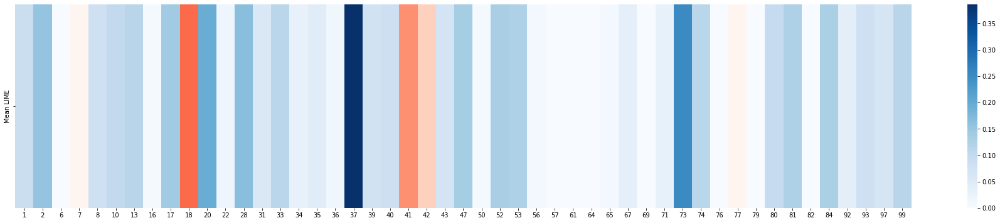

In [285]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Generation of the heat map.

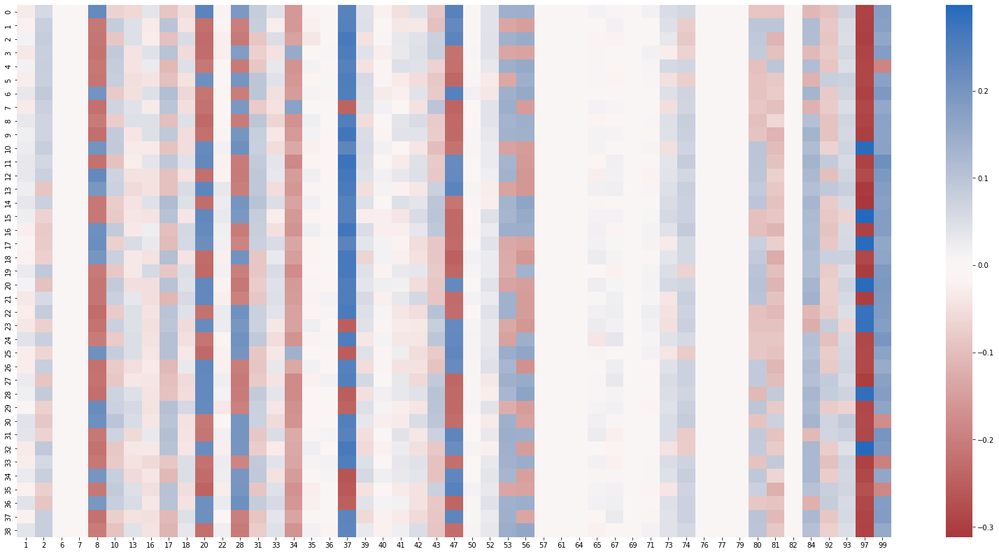

In [286]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

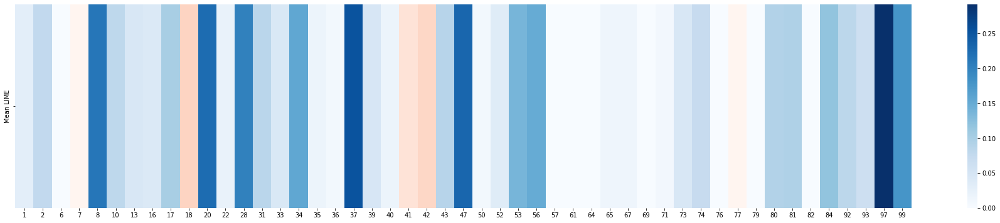

In [287]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

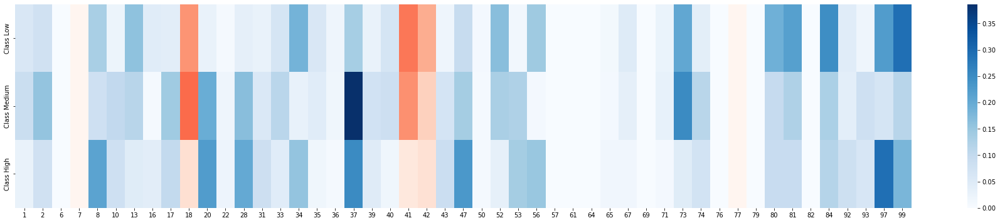

In [288]:
df_lime = pd.concat(map_class, axis=1)
df_lime.columns = name_class
plt.figure(figsize = (32,6))
sns.heatmap(df_lime.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_lime.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using ALE

It shows the main effect of each question compared to the probability that the model predicts in each class. This effect is shown for both responses. Since there are only 2 answers, the map is the same but with the colors reversed.

In [289]:
## Definition of explainability data.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names=train_cols, target_names= target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

## Class index local variable.
iterable_class = -1
map_class = []

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

Obtaining the data for the generation of the explanations by ALE about the all classes.

In [290]:
## Local variables for ALE array data.
ale_list = [[] for _ in range(len(name_class))]

## Recovering the data needed for ALE.
for array in proba_exp_lr.ale_values:
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
    
        ## Saving data of the all classes.
        ale_list[elements].append(array[0][elements])

Data processing for the explainability of ALE.

In [291]:
## Data processing of the Low, Medium and High classes.
for elements in range(0, len(name_class)):
    ale_df = pd.DataFrame([ale_list [elements]])
    ale_df = pd.concat([ale_df.multiply(-1), ale_df])
    ale_df.index = [name_class [elements] + " - False", name_class [elements] + " - True"]
    ale_df.columns = column_Map
    map_class.append(ale_df)

### Explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

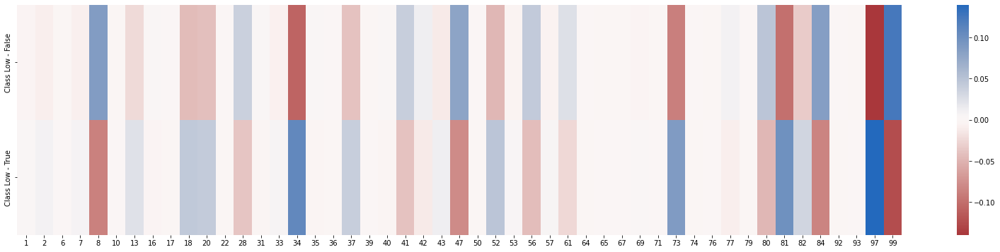

In [292]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

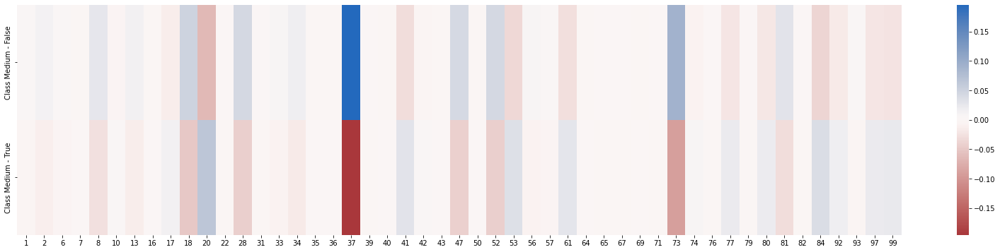

In [293]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

Generation of the heat map.

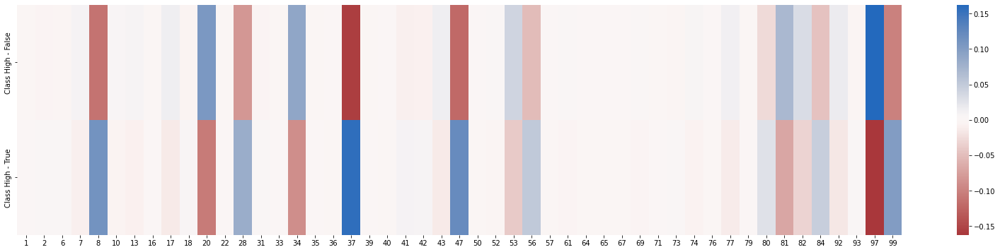

In [294]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used in all classes.

In [295]:
## Application of absolute value to data.
for index in range(0, len(map_class)):
    map_class [index] = map_class [index][0:1].abs()

## Union of the heat maps of the Low, Medium and High class.
ale_df = pd.concat(map_class)
ale_df.index = name_class
ale_df = ale_df.transpose()

Generation of the heat map.

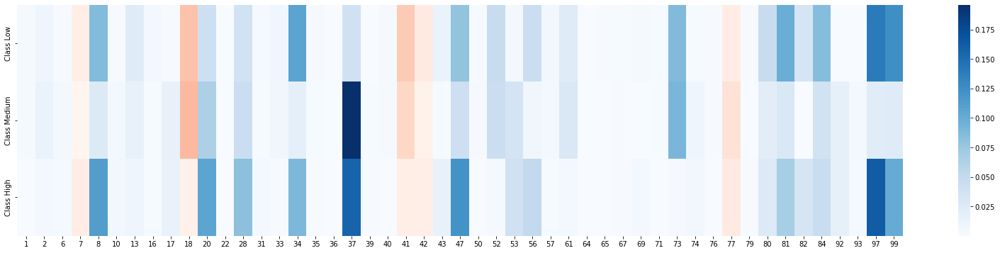

In [296]:
plt.figure(figsize = (28,6))
sns.heatmap(ale_df.transpose(), cmap="Reds", cbar = False)
sns.heatmap(ale_df.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask= df_mask_imp.to_numpy())
plt.show()

## Comparing of Important Variables Methods for Explainability

The global values of each of the methods used are taken, their maximums are obtained (the minimums are 0) and a percentage is calculated based on said maximum, which indicates how relevant the contribution is for each question.

In [297]:
## Class index local variable.
iterable_class = -1

### Comparison of the explanation methods of the first class, in this case the Low.

The highest data of each method used is obtained.

In [298]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [299]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,10,13,16,17,18,...,77,79,80,81,82,84,92,93,97,99
Importance,14.814815,0.000000,0.000000,0.000000,25.925926,0.000000,66.666667,0.000000,0.000000,100.000000,...,0.000000,0.000000,81.481481,0.000000,37.037037,40.740741,0.000000,0.000000,0.000000,0.000000
LIME,20.600717,26.754235,0.000000,0.000000,45.384484,7.352910,54.850309,15.478767,14.381033,49.117179,...,0.000000,0.000000,65.138764,74.570248,0.000000,84.507928,15.202873,6.039862,76.854879,100.000000
SHAP,34.234844,31.720840,8.900906,13.532531,75.455262,15.946860,78.468788,27.763508,22.445438,72.019055,...,9.425743,0.000000,100.000000,47.967360,10.623009,86.280154,20.849034,3.341185,84.373949,61.426954
ALE,2.364628,6.454780,0.666747,6.208866,61.852897,0.998094,16.872555,2.780838,0.859725,31.807592,...,6.599119,0.819968,34.254586,70.334858,24.094872,60.343271,0.096641,0.413920,100.000000,88.915684


Generation of the heat map.

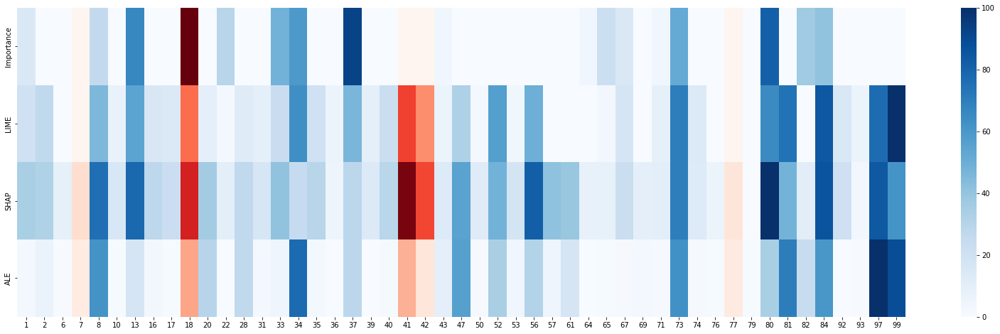

In [300]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the second class, in this case the Medium.

The highest data of each method used is obtained.

In [301]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [302]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,10,13,16,17,18,...,77,79,80,81,82,84,92,93,97,99
Importance,0.000000,34.090909,11.363636,0.000000,11.363636,0.000000,34.090909,0.000000,0.000000,52.272727,...,0.000000,0.000000,18.181818,4.545455,11.363636,38.636364,0.000000,0.000000,20.454545,15.909091
LIME,22.929144,40.195796,0.000000,0.000000,20.758687,26.305259,29.417350,1.842820,37.010247,49.704894,...,0.000000,0.000000,25.312398,32.047672,0.000000,33.327173,9.851854,20.743172,17.497981,29.345957
SHAP,36.820175,51.005767,20.967264,2.454494,29.364184,39.487612,42.430117,4.420939,55.883237,69.610118,...,23.620856,0.000000,34.710790,19.581876,2.899012,27.379299,13.226573,6.722431,23.578225,19.203928
ALE,1.842787,6.775381,2.401324,0.298259,13.448134,2.484138,7.539309,0.899854,7.809972,25.450227,...,11.543163,0.156524,10.655668,15.168295,0.392912,19.460172,8.707469,2.046525,11.537851,12.070647


Generation of the heat map.

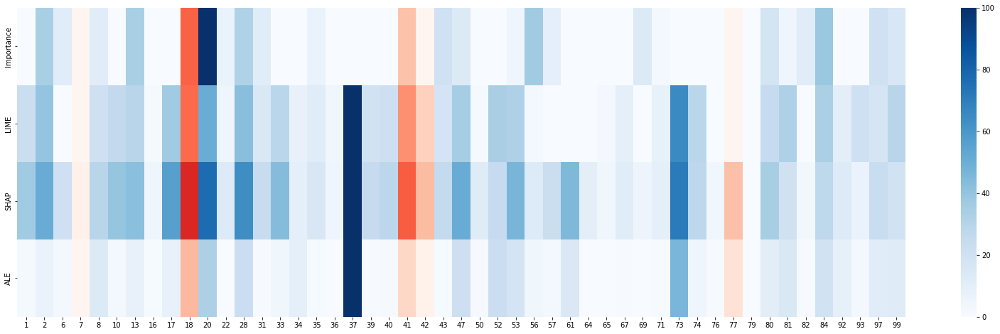

In [303]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the third class, in this case the High.

The highest data of each method used is obtained.

In [304]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [305]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,7,8,10,13,16,17,18,...,77,79,80,81,82,84,92,93,97,99
Importance,0.000000,0.000000,0.000000,0.000000,66.666667,0.000000,8.333333,0.000000,0.000000,8.333333,...,0.000000,0.000000,11.111111,13.888889,25.000000,47.222222,0.000000,0.000000,80.555556,2.777778
LIME,9.785984,26.510540,0.000000,0.000000,72.864390,27.500233,15.851658,14.352265,34.657596,16.756031,...,0.000000,0.000000,31.573536,32.077536,0.000000,40.315393,28.247556,21.587558,100.000000,61.074489
SHAP,12.664044,28.948504,17.457041,11.020512,84.214168,35.687276,14.418670,16.408724,43.732454,18.666375,...,18.318383,0.000000,37.145914,14.863949,6.286002,34.544136,19.714130,6.593027,84.856635,24.868560
ALE,0.186923,2.614916,2.322166,5.704601,69.465092,3.855218,5.431854,1.308601,8.679178,3.312946,...,8.240876,0.894644,16.636618,42.253728,20.268124,28.476252,10.418508,2.111903,100.000000,61.984914


Generation of the heat map.

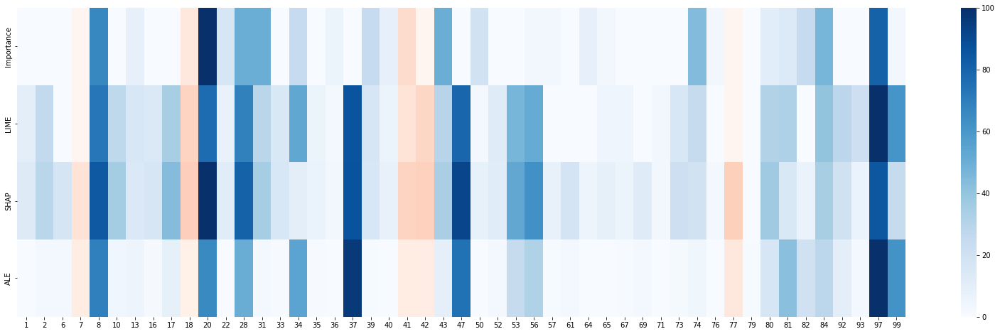

In [306]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

Safeguarding the questions eliminated during this iteration.

In [307]:
## Removal of anomalous questions selected by selection_mode.
for x in question_anomaly:

    ## Status change of the deleted question in the respective auxiliary dataset.
    ds.loc[x - 1,'Status'] = 'Delete'

## Save the changed statuses in the dataset.
ds.to_csv(path_dataset_qs, index = False)

## Iteration 4

The first iteration of improvement of the model is carried out.

## Preparing the data for the neural network

The data is prepared in order to be processed by the neural network.

In [308]:
## The iteration number is increased.
iteration += 1

## Loading data from the dataset.
df = pd.read_csv(path_dataset)
ds = pd.read_csv(path_dataset_qs)

## Elimination of unrelated questions from the dataset.
if len(unrelated_questions) != 0:
    df = df.drop(df.columns[unrelated_questions[0]:unrelated_questions[1]], axis=1)

i = 0
if iteration == 1:
    ## Elimination of list of conflicting questions declared in global variables.
    for x in list_contr:
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1
        ## Status change of the deleted question in the respective auxiliary dataset.
        ds.loc[x - 1,'Status'] = 'Delete'
    
else:    
    ## Elimination of the list of anomadic questions defined in the improvement process.
    ds_delete = ds[ds.Status == "Delete"].reset_index(drop=True)
    for x in ds_delete['Question'].tolist():
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1

## Grouping of the target according to the defined dictionary.
if grouping_name != None and grouping_name != '':
    df[grouping_name] = df[grouping_name].map(class_dic)

## Assignment of local variables according to the data necessary for the neural network.
train_cols = df.columns [0:-1]
label = df.columns [-1]
X = df [train_cols]
y = df [label]

## The prepared data of the dataset is printed.
df

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,20. It is difficult for me to make decisions even if they are simple,22. It is not difficult for me to understand something the first time,...,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns,Target
0,1,1,1,1,0,0,0,0,1,1,...,1,1,0,1,0,0,0,0,0,0
1,1,0,1,1,0,1,1,1,1,1,...,1,1,0,1,1,0,0,0,0,0
2,0,0,1,0,1,0,1,0,0,1,...,1,0,0,1,0,0,0,0,0,1
3,0,0,1,1,0,1,0,0,1,1,...,1,0,0,1,0,1,0,1,0,2
4,1,1,1,1,1,0,1,1,1,0,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,1,1,1,1,1,1,0,0,1,0,...,1,1,1,1,0,1,0,1,1,2
100,1,1,1,0,0,1,0,0,1,0,...,1,0,0,1,0,0,0,1,0,1
101,0,0,1,0,1,1,1,0,0,0,...,1,0,0,1,1,1,0,0,1,0
102,1,0,1,1,1,0,0,1,1,1,...,1,0,0,1,1,1,0,0,0,2


## Oversample application

An oversample process is applied to level the amount of existing data given by the grouping.

In [309]:
## The number of elements present in the grouped target is printed.
y.value_counts()

0    39
1    35
2    30
Name: Target, dtype: int64

Oversample application.

In [310]:
## Application of the oversample to the prepared data.
X, y = oversample.fit_resample(X, y)

Printing of the data after the application of the oversample.

In [311]:
## The results obtained after applying the oversample are printed.
y.value_counts()

0    39
1    39
2    39
Name: Target, dtype: int64

## Preparation of the parameters of the neural network

We proceed to define the parameters necessary for the training of the neural network.

In [312]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=seed)

## Neural network training

The alpha parameters and the initial learning rate are adjusted to obtain the best performance with the model
using cross validation.

In [313]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_normal

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = regul_param, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.16659498207885304,
  0.28843132176465514,
  0.2776667776667776,
  0.3040008983868633,
  0.2575300255300256,
  0.2575300255300256,
  0.2575300255300256,
  0.2575300255300256,
  0.2575300255300256],
 [0.006020651927912844,
  0.08630510353212997,
  0.09251139902038742,
  0.09711067192502043,
  0.07582590789635271,
  0.07582590789635271,
  0.07582590789635271,
  0.07582590789635271,
  0.07582590789635271])

We proceed to draw the learning curve graph according to the data obtained by the training.

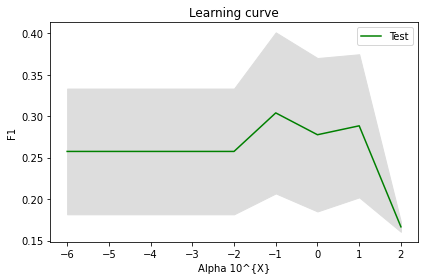

In [314]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Alpha 10^{X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

The training is performed again keeping the same parameters except for the alpha value that changes to 1.

In [315]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_alpha

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = regul_param, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.17806090178006687,
  0.4222391190967042,
  0.43333889593951513,
  0.40979484224066265,
  0.2776667776667776,
  0.16659498207885304,
  0.16659498207885304],
 [0.01757734769209096,
  0.11485289010636886,
  0.13511435367470756,
  0.14103979938781133,
  0.09251139902038742,
  0.006020651927912844,
  0.006020651927912844])

We proceed to draw the learning curve graph according to the data obtained by the training.

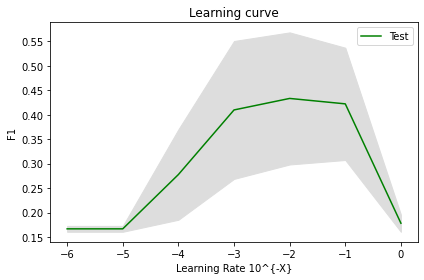

In [316]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Learning Rate 10^{-X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

## Generation of the neural network model

The parameters of the final model are modified according to the data obtained in the training of the neural network.

In [317]:
## The value of the alpha parameter, learning_rate_init and random_state are changed according
## to the data in the global variables.
mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = alpha,
                            learning_rate = 'constant', learning_rate_init = learning_rate_init, max_iter = 100000,
                            random_state = random_state_model)

## We print the data of the final generated model.
mlp.fit(X_train, y_train)

MLPClassifier(activation='logistic', alpha=0.001, hidden_layer_sizes=(10,),
              learning_rate_init=0.1, max_iter=100000, random_state=42)

We safeguard the final generated model

In [318]:
joblib.dump(mlp,"model_depression_i" + str(iteration) + ".pkl")

['model_depression_i4.pkl']

## Generation of the confusion matrix of the model

We obtain the statistics of the final model to generate its confusion matrix.

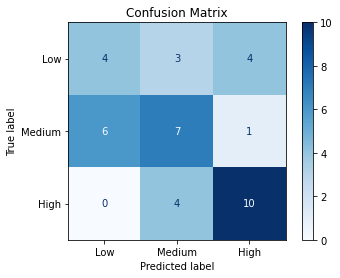

In [319]:
## The data for the generation of the confession matrix are defined.
confusion_matrix = ConfusionMatrixDisplay.from_estimator(mlp, X_test, y_test, display_labels = target_names,
                                                         cmap = plt.cm.Blues)
confusion_matrix.ax_.set_title("Confusion Matrix")
plt.show()

We get the detailed statistics of the final model.

In [320]:
## The necessary detailed prediction is generated.
y_pred = mlp.predict(X_test)

## The detailed statistics of the model are printed.
print('Classification accuracy =',accuracy_score(y_test,y_pred) * 100,'%\n')
print(classification_report(y_test,y_pred))

Classification accuracy = 53.84615384615385 %

              precision    recall  f1-score   support

           0       0.40      0.36      0.38        11
           1       0.50      0.50      0.50        14
           2       0.67      0.71      0.69        14

    accuracy                           0.54        39
   macro avg       0.52      0.53      0.52        39
weighted avg       0.53      0.54      0.53        39



The data obtained is saved for later graphing.

In [321]:
accuracy = accuracy_score(y_test,y_pred) * 100
clf_rep = precision_recall_fscore_support(y_test,y_pred)

## The number of questions used in the iteration is retrieved.
ds_delete = ds[ds.Status == "Delete"]
ds_delete.reset_index(inplace=True, drop=True)

## All the metrics of the confusion matrix are obtained.
metrics = [",".join(map(str, ds_delete['Question'].tolist())), accuracy, clf_rep[0][0], clf_rep[1][0],
           clf_rep[2][0], clf_rep[3][0],clf_rep[0][1], clf_rep[1][1], clf_rep[2][1], clf_rep[3][1],
           clf_rep[0][2], clf_rep[1][2], clf_rep[2][2], clf_rep[3][2]]

## The names of the columns of the dataset are defined.
columns = ['Question','Acurracy global','Precision_0','Recall_0','F1_score_0', 'Support_0',
           'Precision_1','Recall_1','F1_score_1', 'Support_1','Precision_2','Recall_2','F1_score_2','Support_2']

## A new row of the dataset is generated with all the data.
data = pd.DataFrame([metrics], columns = columns)

## The data is saved to the dataset.
data.to_csv(path_dataset_qd, mode = 'a', header = False, index = False)

## The data added to the dataset is printed.
data

,Question,Acurracy global,Precision_0,Recall_0,F1_score_0,Support_0,Precision_1,Recall_1,F1_score_1,Support_1,Precision_2,Recall_2,F1_score_2,Support_2
0,"3,4,5,7,9,11,12,14,15,18,19,21,23,24,25,26,27,...",53.846154,0.4,0.363636,0.380952,11,0.5,0.5,0.5,14,0.666667,0.714286,0.689655,14


## Improvement process of the neural network model.

The application of the explanation method by ALE allows to determine the behavior of the neural network and thereby improve it by discarding non-significant data for it.

## Slope Analysis of ALE Plots

In [322]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

We proceed to obtain the graphs to obtain the slopes of the selected classes.

In [323]:
## The question metrics dataset is loaded.
dm = pd.DataFrame()

## The number of questions used in the iteration is retrieved.
ds_item = ds[ds.Status == "In use"]
ds_item.reset_index(inplace=True, drop=True)

## We get the slopes from the ALE data.
for i in range(df.shape[1]-1):
    structure_data = {'Question': ds_item.loc[i, "Question"]}
    
    for index in selection_class:
        slope = proba_exp_lr.ale_values [i][1][index] - proba_exp_lr.ale_values [i][0][index]
        structure_data['Slope ' + str(target_names[index])] = slope
        structure_data['Threshold ' + str(target_names[index])] = 'NA'
        structure_data['Anomaly ' + str(target_names[index])] = 'NA'
        
    dm = dm.append(structure_data, ignore_index=True)
    
## The current rating data dataset is printed.
dm

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be remove

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.059830,NA,NA,0.064008,NA,NA
1,2,-0.000434,NA,NA,-0.008779,NA,NA
2,6,-0.004093,NA,NA,-0.000412,NA,NA
3,8,0.003680,NA,NA,-0.003408,NA,NA
4,10,0.061062,NA,NA,0.023922,NA,NA
5,13,-0.113167,NA,NA,0.000994,NA,NA
6,16,-0.001265,NA,NA,0.000027,NA,NA
7,17,-0.005767,NA,NA,0.012354,NA,NA
8,20,0.010568,NA,NA,0.022650,NA,NA
9,22,-0.017375,NA,NA,-0.018091,NA,NA


## Slope analysis and threshold application

The slope obtained is analyzed and those that are above or below the positive and negative threshold are selected.

In [324]:
for i in range(df.shape[1]-1):
    for index in selection_class:
        
        ## The slopes are selected according to the values of the thresholds of the defined classes.
        if dm.loc[i, "Slope " + str(target_names[index])] >= positive_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 1
        elif dm.loc[i, "Slope " + str(target_names[index])] <= negative_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 0
            
## The current rating data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.059830,0,NA,0.064008,1,NA
1,2,-0.000434,NA,NA,-0.008779,NA,NA
2,6,-0.004093,NA,NA,-0.000412,NA,NA
3,8,0.003680,NA,NA,-0.003408,NA,NA
4,10,0.061062,1,NA,0.023922,1,NA
5,13,-0.113167,0,NA,0.000994,NA,NA
6,16,-0.001265,NA,NA,0.000027,NA,NA
7,17,-0.005767,NA,NA,0.012354,1,NA
8,20,0.010568,1,NA,0.022650,1,NA
9,22,-0.017375,0,NA,-0.018091,0,NA


## Analysis and determination of anomalous questions

The anomalous questions present in the model are determined based on their slope and expected response from the expert.

In [325]:
## The dataset of expected responses is loaded.
da = pd.read_csv(path_dataset_qa)

## Delete list of questions deleted in this iteration.
i = 0
for x in ds_delete['Question']:
    da.drop(da.index[x - (i + 1)], axis = 0, inplace = True)
    i += 1

## Indexes are restored for later use.
da.reset_index(inplace=True, drop=True)

## The dataset of expected responses is printed.
da

,Numero,Pregunta,RE
0,1,La mayor parte del tiempo tengo dificultad par...,1
1,2,No siento ganas de hacer mis deberes cotidianos,1
2,6,Considero que mi vida está llena de cosas buenas,0
3,8,Sigo siendo tan puntual como siempre he sido,0
4,10,Me he dado cuenta de que puedo pasar mucho tie...,1
5,13,Antes me sentía más animado para hacer mis act...,1
6,16,Creo que mis pensamientos son extraños o disti...,1
7,17,Siento culpa sobre las decisiones que he tomado,1
8,20,Me resulta complicado poder tomar decisiones a...,1
9,22,No se me dificulta entender algo a la primera,0


We proceed to identify the anomadic questions present in the model present in this iteration.

In [326]:
for i in range(df.shape[1]-1):
    
    ## Local variable to indicate the index of the selected classes.
    i_index = 0
    
    for index in selection_class:
        
        ## Determine if it fails based on the expected response parameters of the defined classes.
        if dm.loc[i, "Threshold "  + str(target_names[index])] == 1 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][0]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 1 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][1]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][2]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly "  + str(target_names[index])] = expected_response_map[i_index][3]
        
        ## Increase of the index of the selected classes.
        i_index += 1

## The final grade data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.059830,0,0,0.064008,1,0
1,2,-0.000434,NA,NA,-0.008779,NA,NA
2,6,-0.004093,NA,NA,-0.000412,NA,NA
3,8,0.003680,NA,NA,-0.003408,NA,NA
4,10,0.061062,1,1,0.023922,1,0
5,13,-0.113167,0,0,0.000994,NA,NA
6,16,-0.001265,NA,NA,0.000027,NA,NA
7,17,-0.005767,NA,NA,0.012354,1,0
8,20,0.010568,1,1,0.022650,1,0
9,22,-0.017375,0,1,-0.018091,0,0


## Removing identified anomadic questions from the model

We proceed to eliminate the identified anomadic questions so as not to use them in the next iteration.

In [327]:
## Local variable for the elimination of the anomaly questions.
instructions = ''
init = False
question_anomaly = []

if selection_mode == 1:
    
    ## Questions that fail in the defined class are retrieved.
    dm_delete = dm[dm['Anomaly ' + str(target_names[select_class_mode])] == 1]
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 2:
    
    ## Questions that fail in classes defined with the or condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " or `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 3:
    
    ## Questions that fail in classes defined with the and condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 4:
    
    ## Out-of-threshold questions are retrieved in classes defined with the condition type and.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 'NA'"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 'NA'"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()

## The selected blank questions are printed according to the selection_mode.
question_anomaly

[33, 50]

## Model explainability process

The data used for the test of the neural network model is shown.

In [328]:
X_test

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,20. It is difficult for me to make decisions even if they are simple,22. It is not difficult for me to understand something the first time,...,76. Laws are not as important as others think,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns
69,1,0,1,0,0,0,0,0,1,1,...,1,1,1,0,1,1,0,0,0,0
46,1,0,1,1,1,1,1,1,0,1,...,1,1,0,1,1,0,0,0,0,0
58,0,0,1,1,0,1,1,0,0,1,...,1,1,0,0,1,0,0,0,0,0
114,1,0,1,0,1,1,1,0,0,1,...,1,1,0,0,1,1,0,0,0,0
73,0,0,1,1,1,0,0,0,0,1,...,1,1,1,1,1,0,0,0,0,1
98,1,0,0,1,1,0,1,0,1,1,...,1,1,1,0,1,1,1,0,0,0
31,0,0,1,0,0,0,0,1,0,1,...,1,1,1,0,1,0,0,0,0,0
53,1,0,1,1,1,1,1,1,0,1,...,1,1,1,0,1,1,0,0,0,0
65,0,0,1,1,0,1,0,0,0,1,...,1,1,1,0,1,0,0,0,0,0
96,0,0,1,1,1,0,0,1,0,1,...,1,1,1,0,1,0,0,0,0,0


## Explanation of the model using ALE

In analysis of the model through the results obtained by ALE, it is possible to identify the behavior of the neural network.

In [329]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

The graphs of all the data present in the dataset used are shown.

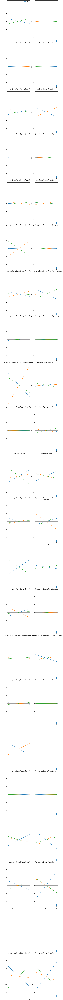

In [330]:
plot_ale(proba_exp_lr, n_cols=2, features=list(range(df.shape[1]-1)),fig_kw={'figwidth': 10, 'figheight': 180});

## Explanation of the model using LIME

We proceed to explain the improved model using LIME for the Low, Medium and High classes.

In [331]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                   feature_names=train_cols, class_names=target_names, 
                                                   discretize_continuous=True)

The first individual present in the test data is explained.

In [332]:
exp = explainer.explain_instance(X_test.to_numpy()[0], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The second individual present in the test data is explained.

In [333]:
exp = explainer.explain_instance(X_test.to_numpy()[1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The last individual present in the test data is explained.

In [334]:
exp = explainer.explain_instance(X_test.to_numpy()[-1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


## Explanation of the model using SHAP

SHAP explanatory values are displayed according to the class to which the selected individual belongs according to the prediction of the model.

The first individual present in the test data is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

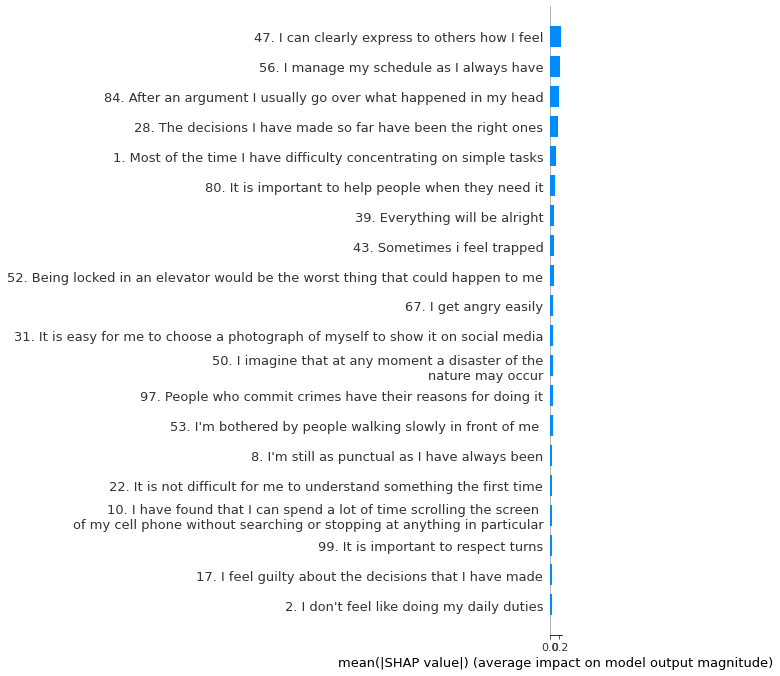

In [335]:
## Individual Selection.
individual = X_test.iloc[[0]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The second individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

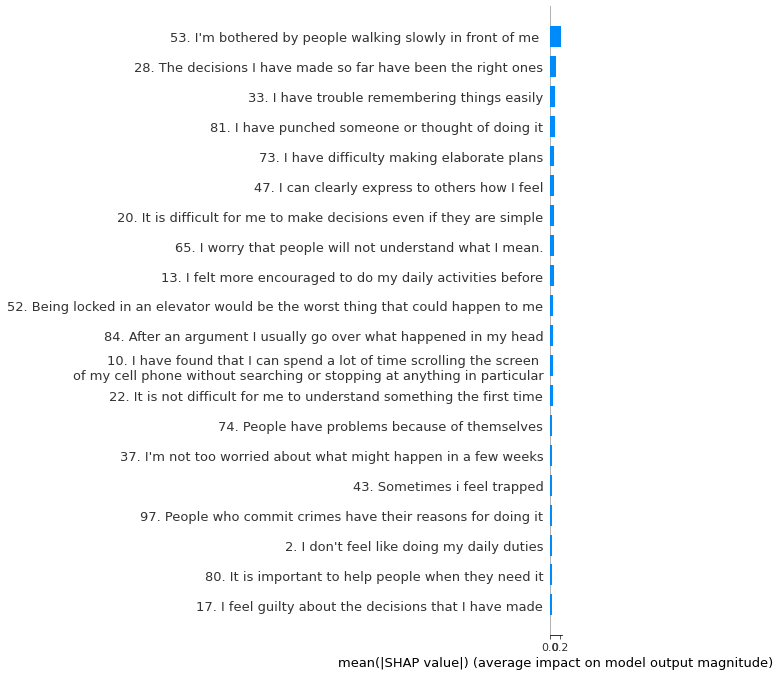

In [336]:
## Individual Selection.
individual = X_test.iloc[[1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The last individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

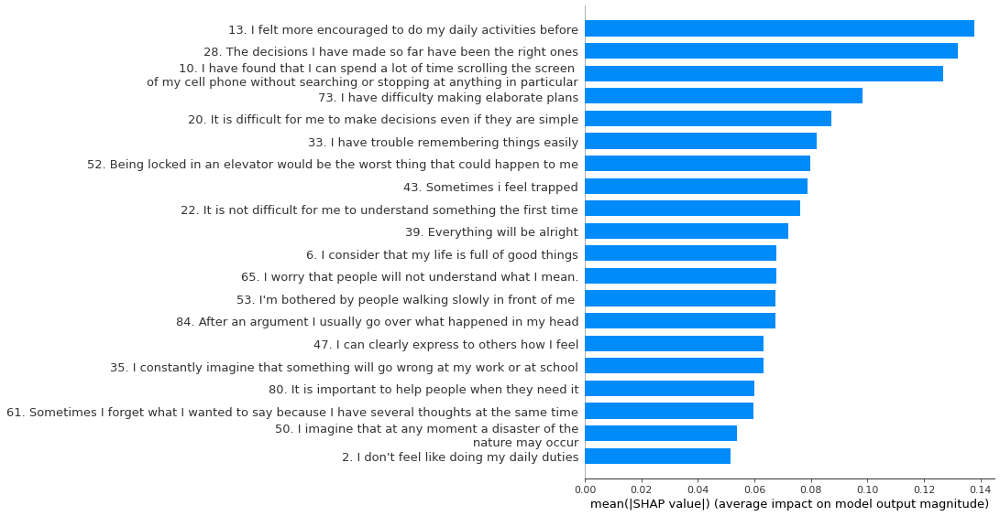

In [337]:
## Individual Selection.
individual = X_test.iloc[[-1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

## Explanation using heatmaps

The importance of the data present in the neural network is shown from explanation methods.

In [338]:
## Questions currently in use are retrieved.
ds_item = ds[ds.Status == "In use"].reset_index(drop=True)

## The data is prepared for the generation of heat maps.
column_Map = ds_item['Question'].tolist()
content_Map = [False for x in range(1, df.shape[1])]

## The next questions to be deleted will be marked.
for index in range(0, len(content_Map)):
    
    if iteration == 0:
        for delete in list_contr:
            if column_Map[index] == delete:
                content_Map [index] = True
    else:
        for delete in question_anomaly:
            if column_Map[index] == delete:
                content_Map [index] = True

## The dataframe is created with the prepared data.
df_mask = pd.DataFrame([content_Map], columns = column_Map)
df_mask_imp = pd.concat([df_mask, df_mask, df_mask], ignore_index = True, axis = 0)
df_mask_all = pd.concat([df_mask, df_mask, df_mask, df_mask], ignore_index = True, axis = 0)

df_mask

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


### Identification of important variables

Identification of important variables from the randomness of the answers as questions of the data.

In [339]:
## Loading the data for explainability.
explainer = ClassifierExplainer(mlp, X_test, y_test)

## Class index local variable.
iterable_class = -1
map_class = []

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')


### Explainability of the data belonging to the first class, in this case the Low.

Calculating permutation importances (if slow, try setting n_jobs parameter)...


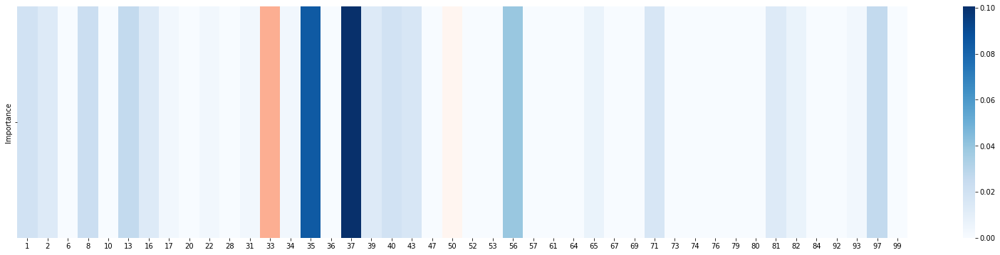

In [340]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

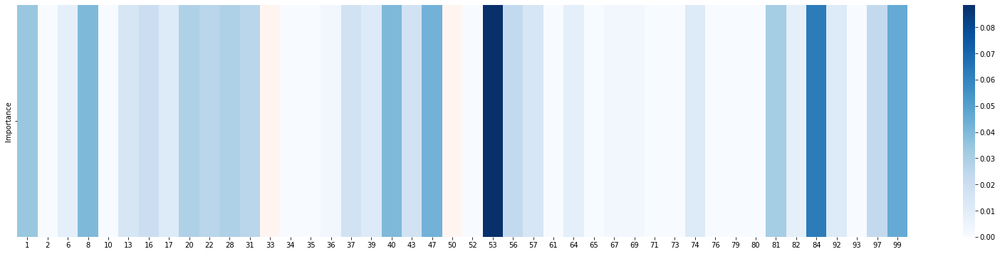

In [341]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

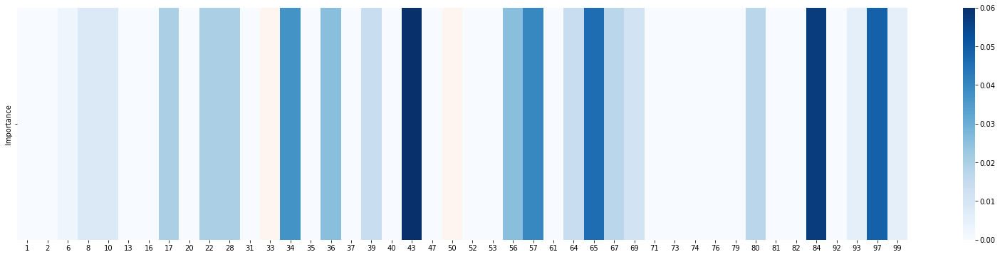

In [342]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

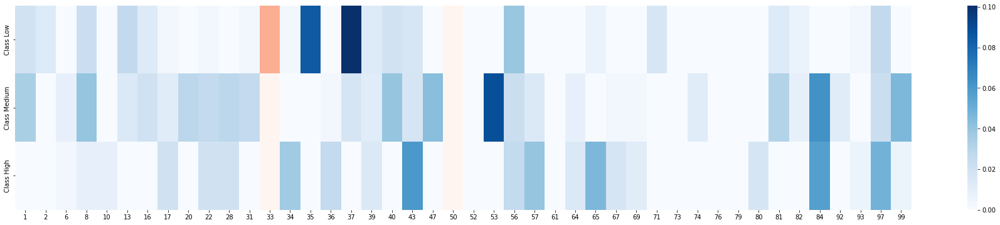

In [343]:
## Fusion of the previous heat maps.
df_importance = pd.concat(map_class, axis=1)
df_importance.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_importance.transpose(), cmap = "Reds", cbar = False)
sns.heatmap(df_importance.transpose(), cmap = "Blues",yticklabels = True, xticklabels = True ,mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using SHAP

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of SHAP.

In [344]:
## Class index local variable.
iterable_class = -1
map_class = []

### Individual explainability of the data belonging to the first class, in this case the Low.

Definition of explainability data.

In [345]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Calculating shap values...


  0%|          | 0/39 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

Generation of the heat map.

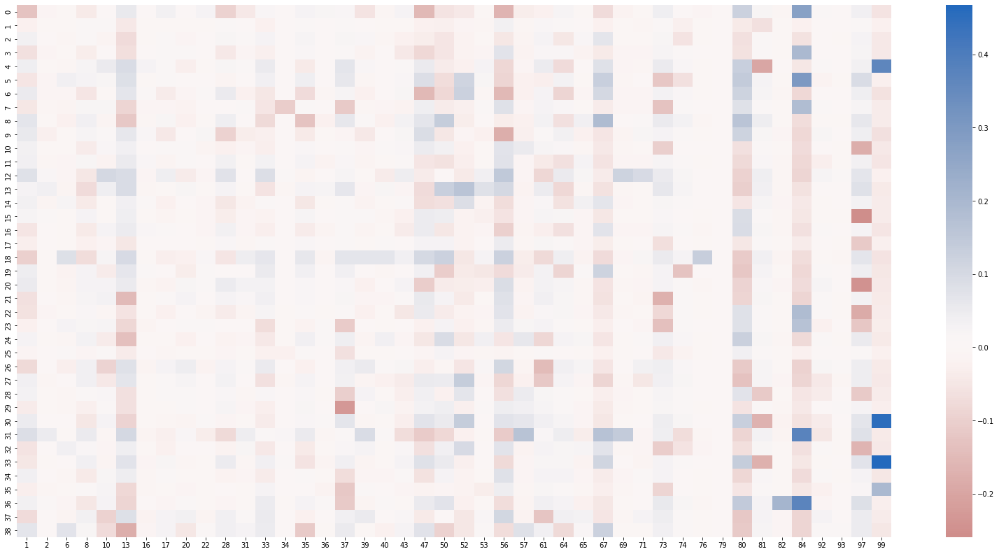

In [346]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [347]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

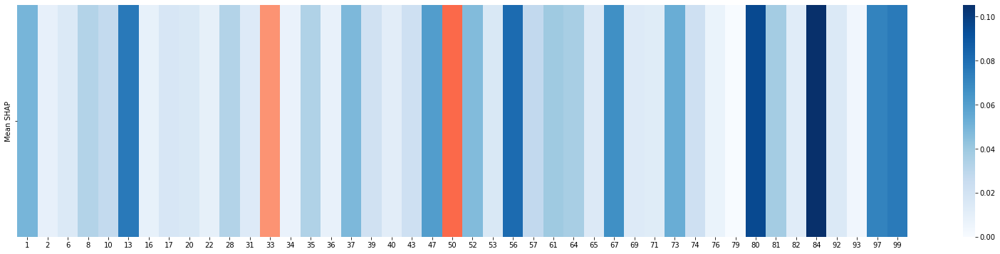

In [348]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Definition of explainability data.

In [349]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

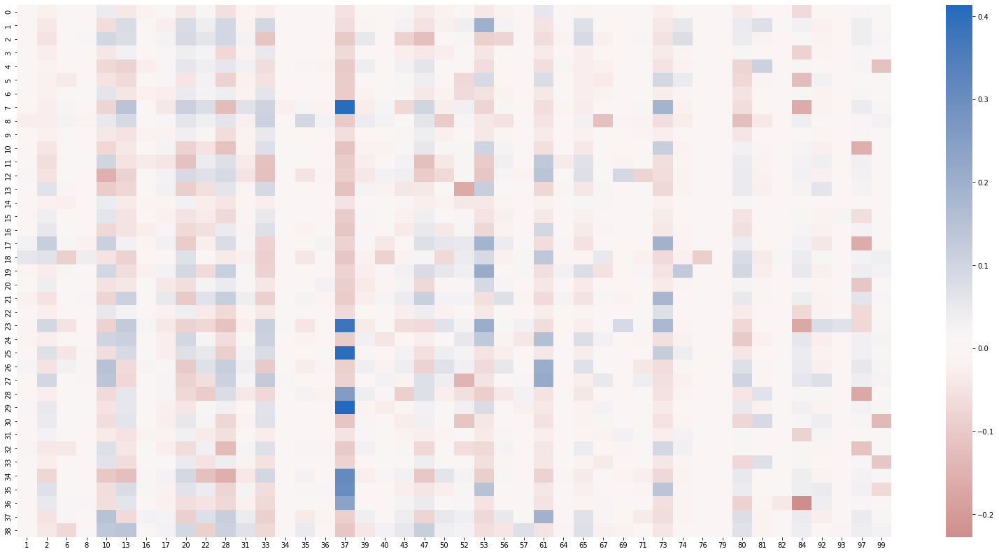

In [350]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [351]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

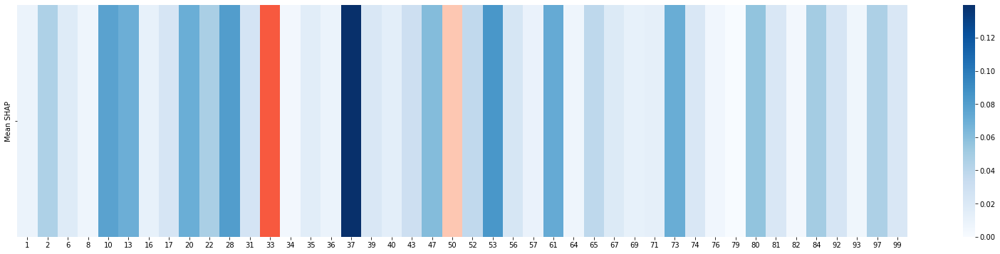

In [352]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Definition of explainability data.

In [353]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

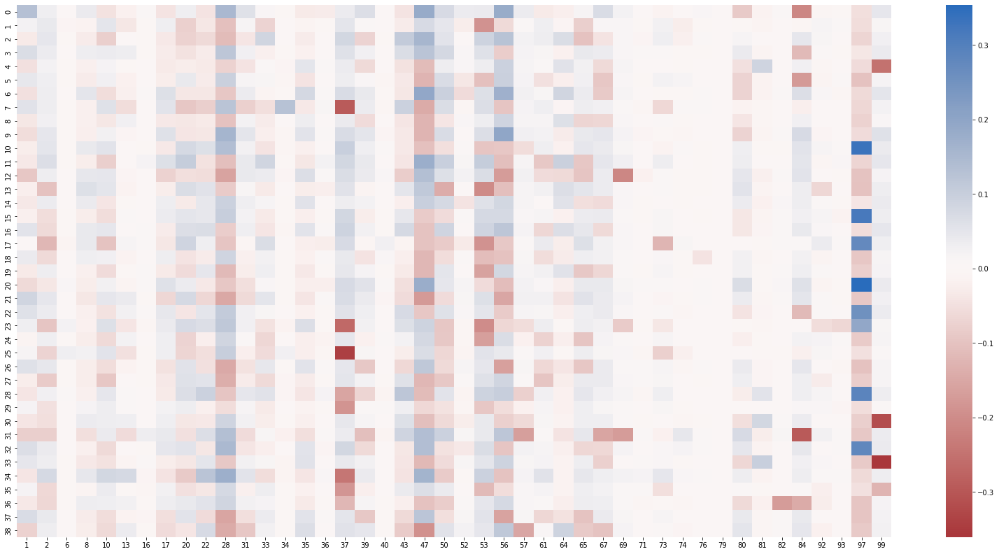

In [354]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [355]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

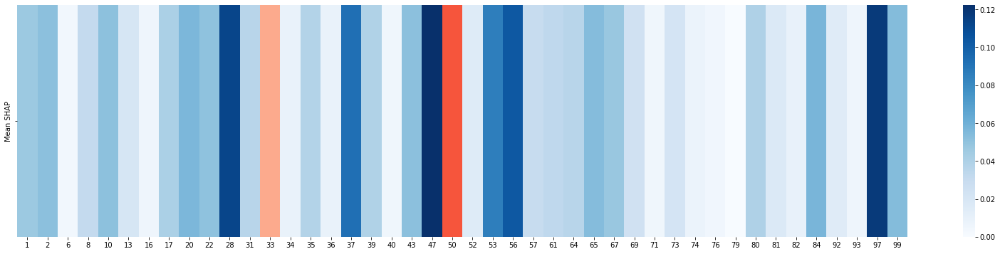

In [356]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

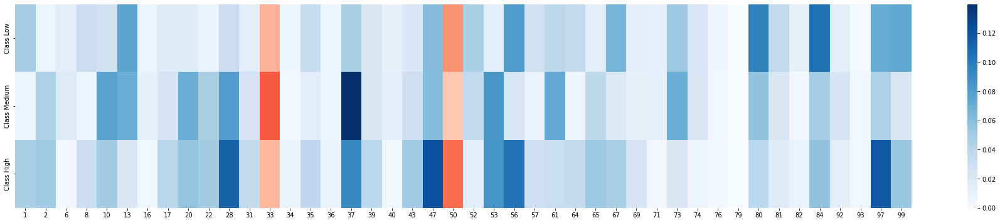

In [357]:
## Fusion of the previous heat maps.
df_shap = pd.concat(map_class, axis=1)
df_shap.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_shap.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_shap.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using LIME

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of LIME.

In [358]:
## Data preparation for explainability.
lime_exp = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                  feature_names=train_cols, class_names=target_names,
                                                  discretize_continuous=True)

## Class index local variable.
iterable_class = -1
map_class = []

Obtaining the data for the generation of the explanations by LIME about the Low, Medium and High classes.

In [359]:
## Local variables for LIME array data.
exp_matrix = [[] for _ in range(len(name_class))]

## Recovering the data needed for LIME.
for x in X_test.to_numpy():
    
    ## Auxiliary temporary variables.
    exp_list = [[] for _ in range(len(name_class))]
    
    ## Loading the data for explainability.
    exp = lime_exp.explain_instance(x, mlp.predict_proba, num_features = df.shape[1] - 1, top_labels = len(name_class))
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
        temp = exp.as_map()[elements]
        temp.sort(key=itemgetter(0))
        
        ## Saving data of the Low, Medium and High classes.
        for tup in temp:
            exp_list[elements].append(tup[1])
            
        exp_matrix[elements].append(exp_list[elements])

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

### Individual explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

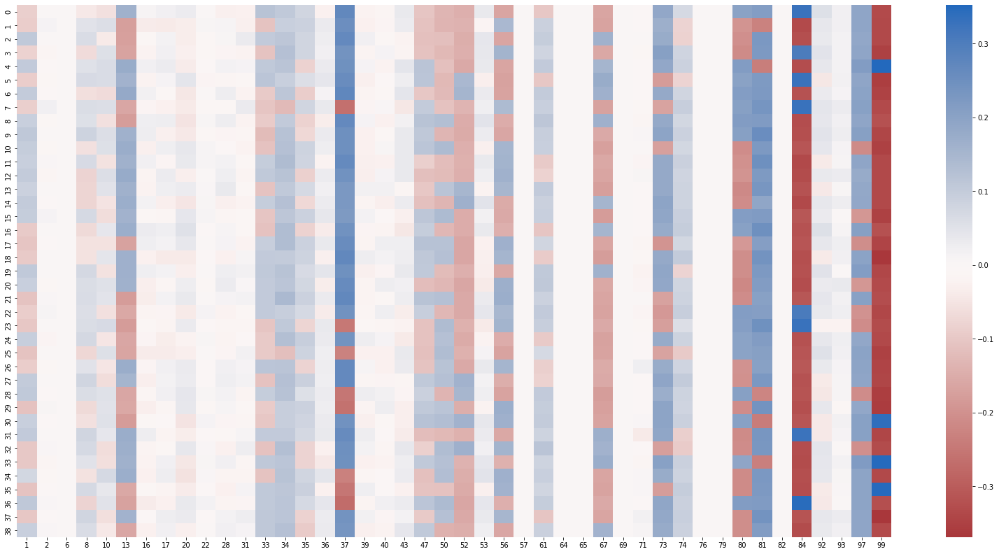

In [360]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

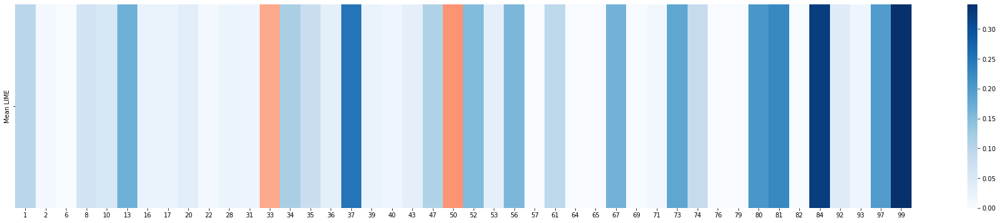

In [361]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

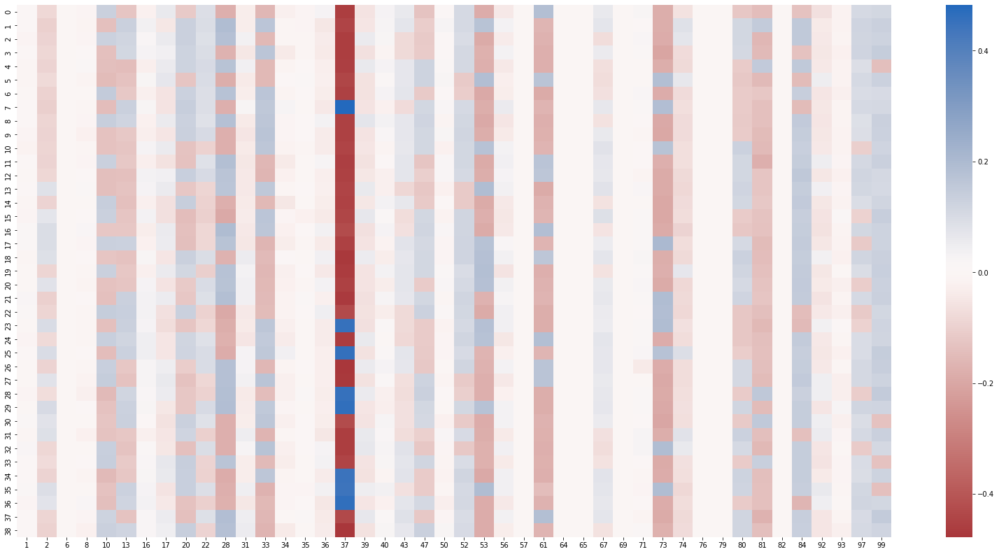

In [362]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

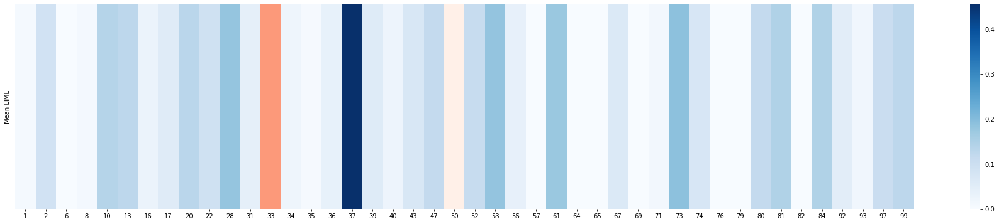

In [363]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Generation of the heat map.

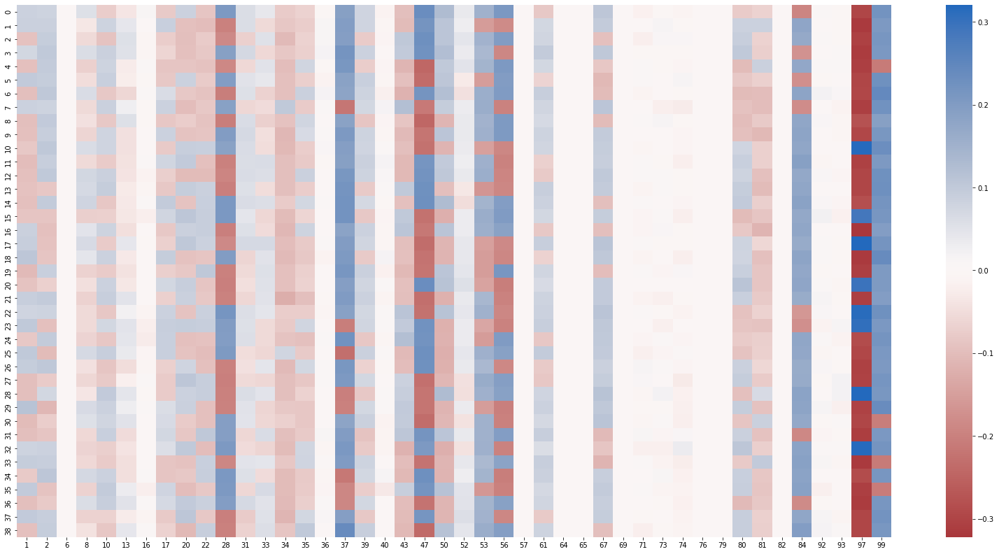

In [364]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

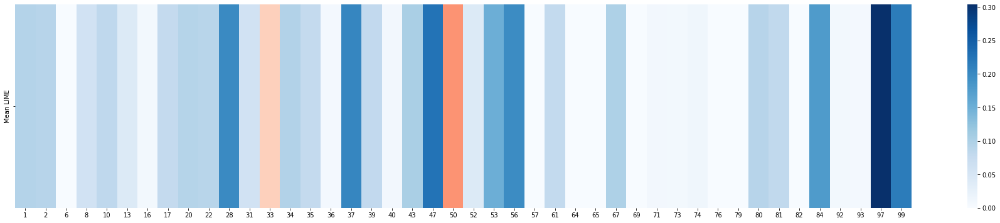

In [365]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

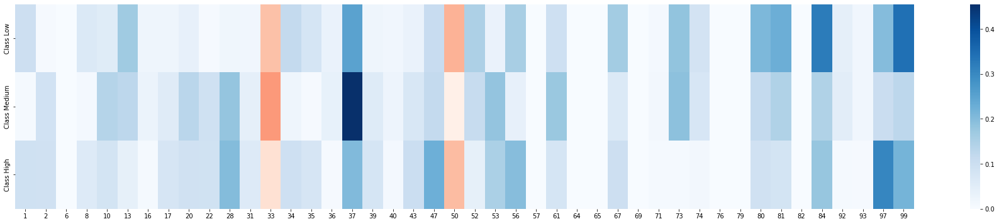

In [366]:
df_lime = pd.concat(map_class, axis=1)
df_lime.columns = name_class
plt.figure(figsize = (32,6))
sns.heatmap(df_lime.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_lime.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using ALE

It shows the main effect of each question compared to the probability that the model predicts in each class. This effect is shown for both responses. Since there are only 2 answers, the map is the same but with the colors reversed.

In [367]:
## Definition of explainability data.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names=train_cols, target_names= target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

## Class index local variable.
iterable_class = -1
map_class = []

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

Obtaining the data for the generation of the explanations by ALE about the all classes.

In [368]:
## Local variables for ALE array data.
ale_list = [[] for _ in range(len(name_class))]

## Recovering the data needed for ALE.
for array in proba_exp_lr.ale_values:
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
    
        ## Saving data of the all classes.
        ale_list[elements].append(array[0][elements])

Data processing for the explainability of ALE.

In [369]:
## Data processing of the Low, Medium and High classes.
for elements in range(0, len(name_class)):
    ale_df = pd.DataFrame([ale_list [elements]])
    ale_df = pd.concat([ale_df.multiply(-1), ale_df])
    ale_df.index = [name_class [elements] + " - False", name_class [elements] + " - True"]
    ale_df.columns = column_Map
    map_class.append(ale_df)

### Explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

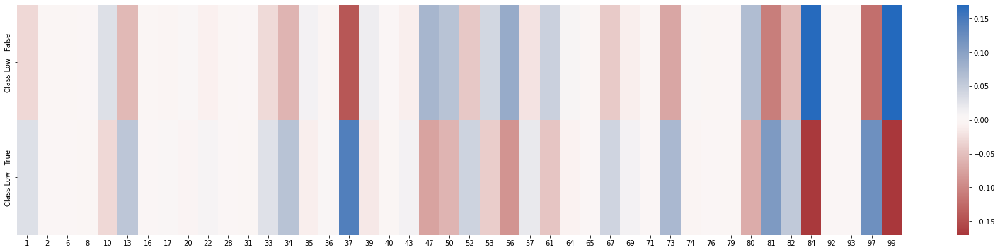

In [370]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

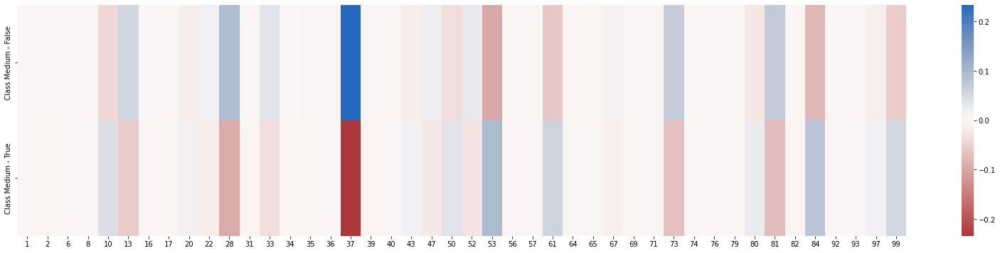

In [371]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

Generation of the heat map.

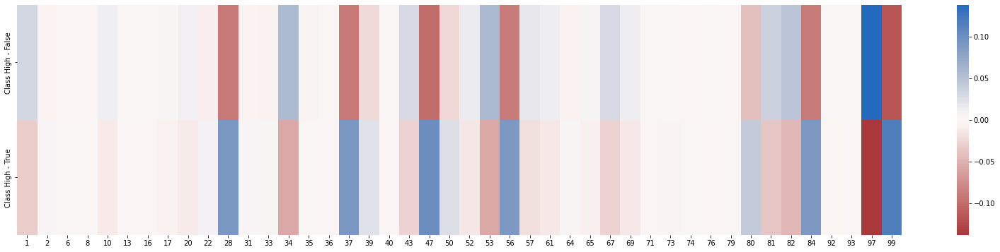

In [372]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used in all classes.

In [373]:
## Application of absolute value to data.
for index in range(0, len(map_class)):
    map_class [index] = map_class [index][0:1].abs()

## Union of the heat maps of the Low, Medium and High class.
ale_df = pd.concat(map_class)
ale_df.index = name_class
ale_df = ale_df.transpose()

Generation of the heat map.

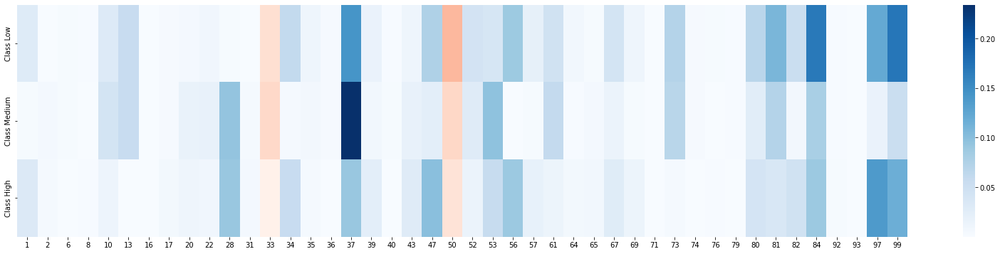

In [374]:
plt.figure(figsize = (28,6))
sns.heatmap(ale_df.transpose(), cmap="Reds", cbar = False)
sns.heatmap(ale_df.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask= df_mask_imp.to_numpy())
plt.show()

## Comparing of Important Variables Methods for Explainability

The global values of each of the methods used are taken, their maximums are obtained (the minimums are 0) and a percentage is calculated based on said maximum, which indicates how relevant the contribution is for each question.

In [375]:
## Class index local variable.
iterable_class = -1

### Comparison of the explanation methods of the first class, in this case the Low.

The highest data of each method used is obtained.

In [376]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [377]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
Importance,19.354839,12.903226,0.000000,22.580645,0.000000,25.806452,12.903226,3.225806,0.000000,3.225806,...,0.000000,0.000000,0.000000,12.903226,6.451613,0.000000,0.000000,3.225806,25.806452,0.000000
LIME,28.629169,2.057150,0.000000,19.022672,15.934153,49.100402,6.633353,6.597230,11.118590,2.052391,...,0.000000,0.000000,60.475890,66.153249,0.000000,94.634972,11.981487,4.898959,58.070498,100.000000
SHAP,46.993527,8.285825,14.365941,31.056122,25.918871,72.135063,8.179034,16.310257,15.088006,8.780410,...,6.480479,0.000000,90.384789,35.711625,11.718050,100.000000,14.108634,3.603833,68.111911,71.540102
ALE,17.534272,0.127091,1.199430,1.078407,17.895170,33.165480,0.370801,1.690174,3.097283,5.091920,...,1.263925,1.059736,39.517958,63.381609,31.429444,98.976996,0.897642,0.264193,71.616878,100.000000


Generation of the heat map.

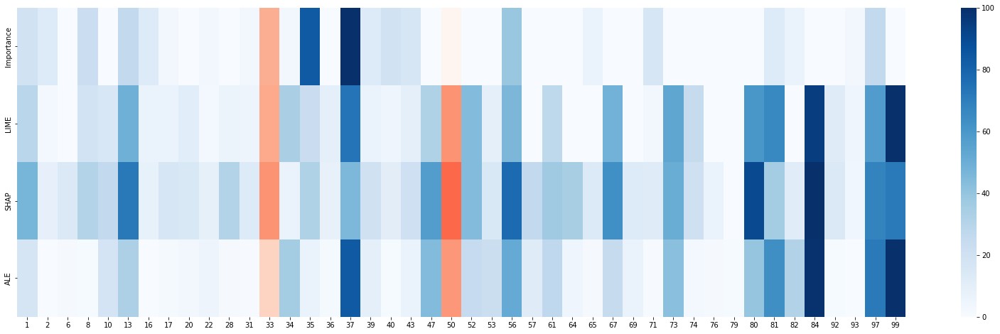

In [378]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the second class, in this case the Medium.

The highest data of each method used is obtained.

In [379]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [380]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
Importance,38.709677,0.000000,9.677419,45.161290,0.000000,16.129032,22.580645,12.903226,32.258065,29.032258,...,0.000000,0.000000,0.000000,35.483871,9.677419,70.967742,12.903226,0.000000,25.806452,51.612903
LIME,1.662668,19.495825,0.000000,2.259648,30.174700,27.880771,5.972574,12.145782,28.530787,20.545273,...,0.000000,0.000000,25.468713,31.675761,0.000000,31.896432,10.667805,3.717348,23.280461,27.752656
SHAP,6.168833,32.738983,12.835563,4.763426,55.408085,49.753463,7.924225,17.037128,50.189503,33.604271,...,3.810156,0.000000,40.341150,15.245539,2.848219,35.677943,17.063583,3.946505,32.829673,15.311655
ALE,0.892802,1.968990,0.962721,0.058179,18.163038,23.973833,0.264674,1.407661,7.099566,7.579725,...,0.298538,0.516546,11.005452,30.560679,3.029039,34.171360,0.496210,0.057761,6.739448,22.946256


Generation of the heat map.

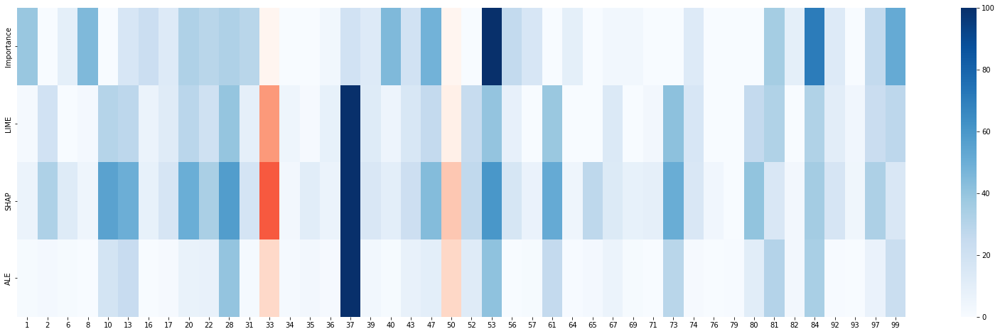

In [381]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the third class, in this case the High.

The highest data of each method used is obtained.

In [382]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [383]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
Importance,0.000000,0.000000,4.761905,14.285714,14.285714,0.000000,0.000000,33.333333,0.000000,33.333333,...,0.000000,0.000000,28.571429,0.000000,0.000000,95.238095,0.000000,9.523810,80.952381,9.523810
LIME,30.545647,29.879324,0.000000,19.321167,27.241144,13.418220,2.384111,25.569647,30.188044,29.658009,...,0.000000,0.000000,29.794369,26.884337,0.000000,58.524724,2.716491,2.261115,100.000000,70.744032
SHAP,37.977710,41.848957,3.491143,25.612172,41.476533,16.549282,4.481280,33.349552,45.801571,41.222765,...,3.629524,0.000000,32.091074,14.139092,7.614898,46.494775,12.140878,4.778629,96.071986,44.037309
ALE,23.199248,3.181962,0.149271,1.235036,8.670522,0.360428,0.009730,4.477491,8.209391,6.556843,...,1.056856,0.434617,30.209341,26.559261,33.732932,64.457960,1.951646,0.424691,100.000000,84.759385


Generation of the heat map.

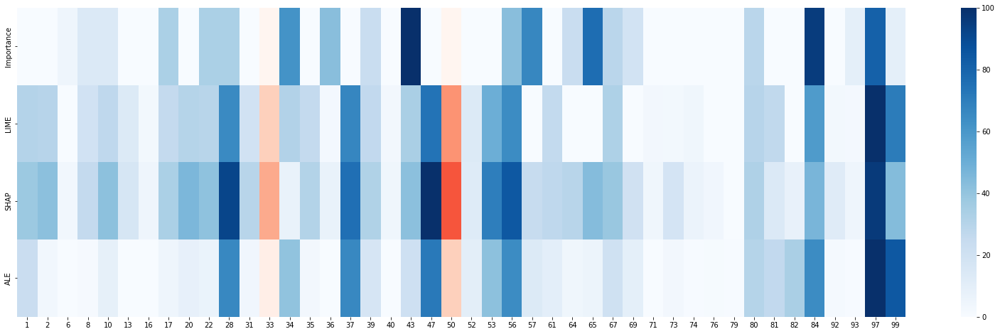

In [384]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

Safeguarding the questions eliminated during this iteration.

In [385]:
## Removal of anomalous questions selected by selection_mode.
for x in question_anomaly:

    ## Status change of the deleted question in the respective auxiliary dataset.
    ds.loc[x - 1,'Status'] = 'Delete'

## Save the changed statuses in the dataset.
ds.to_csv(path_dataset_qs, index = False)

## Iteration 5

The first iteration of improvement of the model is carried out.

## Preparing the data for the neural network

The data is prepared in order to be processed by the neural network.

In [386]:
## The iteration number is increased.
iteration += 1

## Loading data from the dataset.
df = pd.read_csv(path_dataset)
ds = pd.read_csv(path_dataset_qs)

## Elimination of unrelated questions from the dataset.
if len(unrelated_questions) != 0:
    df = df.drop(df.columns[unrelated_questions[0]:unrelated_questions[1]], axis=1)

i = 0
if iteration == 1:
    ## Elimination of list of conflicting questions declared in global variables.
    for x in list_contr:
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1
        ## Status change of the deleted question in the respective auxiliary dataset.
        ds.loc[x - 1,'Status'] = 'Delete'
    
else:    
    ## Elimination of the list of anomadic questions defined in the improvement process.
    ds_delete = ds[ds.Status == "Delete"].reset_index(drop=True)
    for x in ds_delete['Question'].tolist():
        df.drop(df.columns[x - (i + 1)], axis = 1, inplace = True)
        i += 1

## Grouping of the target according to the defined dictionary.
if grouping_name != None and grouping_name != '':
    df[grouping_name] = df[grouping_name].map(class_dic)

## Assignment of local variables according to the data necessary for the neural network.
train_cols = df.columns [0:-1]
label = df.columns [-1]
X = df [train_cols]
y = df [label]

## The prepared data of the dataset is printed.
df

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,20. It is difficult for me to make decisions even if they are simple,22. It is not difficult for me to understand something the first time,...,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns,Target
0,1,1,1,1,0,0,0,0,1,1,...,1,1,0,1,0,0,0,0,0,0
1,1,0,1,1,0,1,1,1,1,1,...,1,1,0,1,1,0,0,0,0,0
2,0,0,1,0,1,0,1,0,0,1,...,1,0,0,1,0,0,0,0,0,1
3,0,0,1,1,0,1,0,0,1,1,...,1,0,0,1,0,1,0,1,0,2
4,1,1,1,1,1,0,1,1,1,0,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99,1,1,1,1,1,1,0,0,1,0,...,1,1,1,1,0,1,0,1,1,2
100,1,1,1,0,0,1,0,0,1,0,...,1,0,0,1,0,0,0,1,0,1
101,0,0,1,0,1,1,1,0,0,0,...,1,0,0,1,1,1,0,0,1,0
102,1,0,1,1,1,0,0,1,1,1,...,1,0,0,1,1,1,0,0,0,2


## Oversample application

An oversample process is applied to level the amount of existing data given by the grouping.

In [387]:
## The number of elements present in the grouped target is printed.
y.value_counts()

0    39
1    35
2    30
Name: Target, dtype: int64

Oversample application.

In [388]:
## Application of the oversample to the prepared data.
X, y = oversample.fit_resample(X, y)

Printing of the data after the application of the oversample.

In [389]:
## The results obtained after applying the oversample are printed.
y.value_counts()

0    39
1    39
2    39
Name: Target, dtype: int64

## Preparation of the parameters of the neural network

We proceed to define the parameters necessary for the training of the neural network.

In [390]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=seed)

## Neural network training

The alpha parameters and the initial learning rate are adjusted to obtain the best performance with the model
using cross validation.

In [391]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_normal

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = regul_param, 
             learning_rate = 'constant', learning_rate_init = 0.0001, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.1632974910394265,
  0.17910044977511244,
  0.2134900489183255,
  0.21796835709129558,
  0.22441781406706837,
  0.22441781406706837,
  0.22441781406706837,
  0.22441781406706837,
  0.22441781406706837],
 [0.006619092595549127,
  0.03738199764605503,
  0.03759666129433013,
  0.045505150536351104,
  0.044780893408842184,
  0.044780893408842184,
  0.044780893408842184,
  0.044780893408842184,
  0.044780893408842184])

We proceed to draw the learning curve graph according to the data obtained by the training.

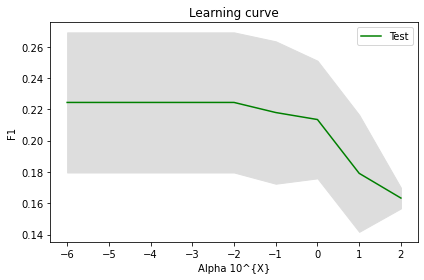

In [392]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Alpha 10^{X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

The training is performed again keeping the same parameters except for the alpha value that changes to 1.

In [393]:
## Local variables are defined for the storage of the scores obtained by the training.
cv_scores_mean = []
cv_scores_std = []
regul_param_range = regul_param_alpha

## Training and validation of different configurations.
for regul_param in regul_param_range:
    
    ## Increase the max_iter parameter until it converges.
    mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = 1, 
             learning_rate = 'constant', learning_rate_init = regul_param, max_iter = 100000, random_state = seed)
    
    scores = cross_val_score(mlp, X, y, cv = 5, scoring = 'f1_macro')
    
    cv_scores_mean.append(scores.mean())
    cv_scores_std.append(scores.std())
    
## The results obtained during the training are printed.
cv_scores_mean, cv_scores_std

([0.1927316172477463,
  0.3981073284014461,
  0.4116582866737666,
  0.4064239028944911,
  0.2134900489183255,
  0.16947033054559935,
  0.16947033054559935],
 [0.06900121176816054,
  0.06226522543522221,
  0.07041327278291896,
  0.0451835151409837,
  0.03759666129433013,
  0.040956253005396466,
  0.040956253005396466])

We proceed to draw the learning curve graph according to the data obtained by the training.

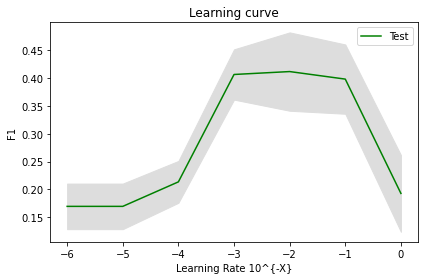

In [394]:
## The average accuracy line is drawn on the test parts.
plt.figure()
plt.plot(np.log10(regul_param_range), cv_scores_mean, color = "g", label = "Test")

## The standard deviation band is drawn.
lower_limit = np.array(cv_scores_mean) - np.array(cv_scores_std)
upper_limit = np.array(cv_scores_mean) + np.array(cv_scores_std)
plt.fill_between(np.log10(regul_param_range), lower_limit, upper_limit, color = "#DDDDDD")

## Generate the graph.
plt.title("Learning curve")
plt.xlabel("Learning Rate 10^{-X}"), plt.ylabel("F1"), plt.legend(loc = "best")
plt.tight_layout()
plt.show()

## Generation of the neural network model

The parameters of the final model are modified according to the data obtained in the training of the neural network.

In [395]:
## The value of the alpha parameter, learning_rate_init and random_state are changed according
## to the data in the global variables.
mlp = MLPClassifier(hidden_layer_sizes = (10,), activation = 'logistic', solver = 'adam', alpha = alpha,
                            learning_rate = 'constant', learning_rate_init = learning_rate_init, max_iter = 100000,
                            random_state = random_state_model)

## We print the data of the final generated model.
mlp.fit(X_train, y_train)

MLPClassifier(activation='logistic', alpha=0.001, hidden_layer_sizes=(10,),
              learning_rate_init=0.1, max_iter=100000, random_state=42)

We safeguard the final generated model

In [396]:
joblib.dump(mlp,"model_depression_i" + str(iteration) + ".pkl")

['model_depression_i5.pkl']

## Generation of the confusion matrix of the model

We obtain the statistics of the final model to generate its confusion matrix.

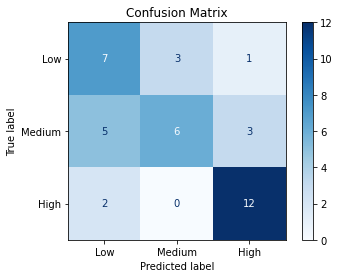

In [397]:
## The data for the generation of the confession matrix are defined.
confusion_matrix = ConfusionMatrixDisplay.from_estimator(mlp, X_test, y_test, display_labels = target_names,
                                                         cmap = plt.cm.Blues)
confusion_matrix.ax_.set_title("Confusion Matrix")
plt.show()

We get the detailed statistics of the final model.

In [398]:
## The necessary detailed prediction is generated.
y_pred = mlp.predict(X_test)

## The detailed statistics of the model are printed.
print('Classification accuracy =',accuracy_score(y_test,y_pred) * 100,'%\n')
print(classification_report(y_test,y_pred))

Classification accuracy = 64.1025641025641 %

              precision    recall  f1-score   support

           0       0.50      0.64      0.56        11
           1       0.67      0.43      0.52        14
           2       0.75      0.86      0.80        14

    accuracy                           0.64        39
   macro avg       0.64      0.64      0.63        39
weighted avg       0.65      0.64      0.63        39



The data obtained is saved for later graphing.

In [399]:
accuracy = accuracy_score(y_test,y_pred) * 100
clf_rep = precision_recall_fscore_support(y_test,y_pred)

## The number of questions used in the iteration is retrieved.
ds_delete = ds[ds.Status == "Delete"]
ds_delete.reset_index(inplace=True, drop=True)

## All the metrics of the confusion matrix are obtained.
metrics = [",".join(map(str, ds_delete['Question'].tolist())), accuracy, clf_rep[0][0], clf_rep[1][0],
           clf_rep[2][0], clf_rep[3][0],clf_rep[0][1], clf_rep[1][1], clf_rep[2][1], clf_rep[3][1],
           clf_rep[0][2], clf_rep[1][2], clf_rep[2][2], clf_rep[3][2]]

## The names of the columns of the dataset are defined.
columns = ['Question','Acurracy global','Precision_0','Recall_0','F1_score_0', 'Support_0',
           'Precision_1','Recall_1','F1_score_1', 'Support_1','Precision_2','Recall_2','F1_score_2','Support_2']

## A new row of the dataset is generated with all the data.
data = pd.DataFrame([metrics], columns = columns)

## The data is saved to the dataset.
data.to_csv(path_dataset_qd, mode = 'a', header = False, index = False)

## The data added to the dataset is printed.
data

,Question,Acurracy global,Precision_0,Recall_0,F1_score_0,Support_0,Precision_1,Recall_1,F1_score_1,Support_1,Precision_2,Recall_2,F1_score_2,Support_2
0,"3,4,5,7,9,11,12,14,15,18,19,21,23,24,25,26,27,...",64.102564,0.5,0.636364,0.56,11,0.666667,0.428571,0.521739,14,0.75,0.857143,0.8,14


## Improvement process of the neural network model.

The application of the explanation method by ALE allows to determine the behavior of the neural network and thereby improve it by discarding non-significant data for it.

## Slope Analysis of ALE Plots

In [400]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

We proceed to obtain the graphs to obtain the slopes of the selected classes.

In [401]:
## The question metrics dataset is loaded.
dm = pd.DataFrame()

## The number of questions used in the iteration is retrieved.
ds_item = ds[ds.Status == "In use"]
ds_item.reset_index(inplace=True, drop=True)

## We get the slopes from the ALE data.
for i in range(df.shape[1]-1):
    structure_data = {'Question': ds_item.loc[i, "Question"]}
    
    for index in selection_class:
        slope = proba_exp_lr.ale_values [i][1][index] - proba_exp_lr.ale_values [i][0][index]
        structure_data['Slope ' + str(target_names[index])] = slope
        structure_data['Threshold ' + str(target_names[index])] = 'NA'
        structure_data['Anomaly ' + str(target_names[index])] = 'NA'
        
    dm = dm.append(structure_data, ignore_index=True)
    
## The current rating data dataset is printed.
dm

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
The frame.append method is deprecated and will be remove

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.138471,NA,NA,0.139419,NA,NA
1,2,-0.014418,NA,NA,-0.058997,NA,NA
2,6,-0.035443,NA,NA,-0.001914,NA,NA
3,8,0.030353,NA,NA,-0.008966,NA,NA
4,10,-0.003401,NA,NA,0.007547,NA,NA
5,13,-0.184835,NA,NA,0.016001,NA,NA
6,16,-0.001500,NA,NA,-0.001485,NA,NA
7,17,-0.073803,NA,NA,0.072450,NA,NA
8,20,0.023498,NA,NA,0.105458,NA,NA
9,22,0.126786,NA,NA,-0.149254,NA,NA


## Slope analysis and threshold application

The slope obtained is analyzed and those that are above or below the positive and negative threshold are selected.

In [402]:
for i in range(df.shape[1]-1):
    for index in selection_class:
        
        ## The slopes are selected according to the values of the thresholds of the defined classes.
        if dm.loc[i, "Slope " + str(target_names[index])] >= positive_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 1
        elif dm.loc[i, "Slope " + str(target_names[index])] <= negative_threshold:
            dm.loc[i, "Threshold " + str(target_names[index])] = 0
            
## The current rating data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.138471,0,NA,0.139419,1,NA
1,2,-0.014418,0,NA,-0.058997,0,NA
2,6,-0.035443,0,NA,-0.001914,NA,NA
3,8,0.030353,1,NA,-0.008966,NA,NA
4,10,-0.003401,NA,NA,0.007547,NA,NA
5,13,-0.184835,0,NA,0.016001,1,NA
6,16,-0.001500,NA,NA,-0.001485,NA,NA
7,17,-0.073803,0,NA,0.072450,1,NA
8,20,0.023498,1,NA,0.105458,1,NA
9,22,0.126786,1,NA,-0.149254,0,NA


## Analysis and determination of anomalous questions

The anomalous questions present in the model are determined based on their slope and expected response from the expert.

In [403]:
## The dataset of expected responses is loaded.
da = pd.read_csv(path_dataset_qa)

## Delete list of questions deleted in this iteration.
i = 0
for x in ds_delete['Question']:
    da.drop(da.index[x - (i + 1)], axis = 0, inplace = True)
    i += 1

## Indexes are restored for later use.
da.reset_index(inplace=True, drop=True)

## The dataset of expected responses is printed.
da

,Numero,Pregunta,RE
0,1,La mayor parte del tiempo tengo dificultad par...,1
1,2,No siento ganas de hacer mis deberes cotidianos,1
2,6,Considero que mi vida está llena de cosas buenas,0
3,8,Sigo siendo tan puntual como siempre he sido,0
4,10,Me he dado cuenta de que puedo pasar mucho tie...,1
5,13,Antes me sentía más animado para hacer mis act...,1
6,16,Creo que mis pensamientos son extraños o disti...,1
7,17,Siento culpa sobre las decisiones que he tomado,1
8,20,Me resulta complicado poder tomar decisiones a...,1
9,22,No se me dificulta entender algo a la primera,0


We proceed to identify the anomadic questions present in the model present in this iteration.

In [404]:
for i in range(df.shape[1]-1):
    
    ## Local variable to indicate the index of the selected classes.
    i_index = 0
    
    for index in selection_class:
        
        ## Determine if it fails based on the expected response parameters of the defined classes.
        if dm.loc[i, "Threshold "  + str(target_names[index])] == 1 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][0]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 1 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][1]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 1:
            dm.loc[i, "Anomaly " + str(target_names[index])] = expected_response_map[i_index][2]
        if dm.loc[i, "Threshold " + str(target_names[index])] == 0 and da.loc[i, "RE"] == 0:
            dm.loc[i, "Anomaly "  + str(target_names[index])] = expected_response_map[i_index][3]
        
        ## Increase of the index of the selected classes.
        i_index += 1

## The final grade data dataset is printed.
dm

,Question,Slope Low,Threshold Low,Anomaly Low,Slope High,Threshold High,Anomaly High
0,1,-0.138471,0,0,0.139419,1,0
1,2,-0.014418,0,0,-0.058997,0,1
2,6,-0.035443,0,1,-0.001914,NA,NA
3,8,0.030353,1,0,-0.008966,NA,NA
4,10,-0.003401,NA,NA,0.007547,NA,NA
5,13,-0.184835,0,0,0.016001,1,0
6,16,-0.001500,NA,NA,-0.001485,NA,NA
7,17,-0.073803,0,0,0.072450,1,0
8,20,0.023498,1,1,0.105458,1,0
9,22,0.126786,1,0,-0.149254,0,0


## Removing identified anomadic questions from the model

We proceed to eliminate the identified anomadic questions so as not to use them in the next iteration.

In [405]:
## Local variable for the elimination of the anomaly questions.
instructions = ''
init = False
question_anomaly = []

if selection_mode == 1:
    
    ## Questions that fail in the defined class are retrieved.
    dm_delete = dm[dm['Anomaly ' + str(target_names[select_class_mode])] == 1]
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 2:
    
    ## Questions that fail in classes defined with the or condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " or `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 3:
    
    ## Questions that fail in classes defined with the and condition type are retrieved.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 1"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 1"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()
    
if selection_mode == 4:
    
    ## Out-of-threshold questions are retrieved in classes defined with the condition type and.
    for index in selection_class:
        if init == False:
            instructions += "`Anomaly " + str(target_names[index]) + "` == 'NA'"
            init = True
        else:
            instructions += " and `Anomaly " + str(target_names[index]) + "` == 'NA'"
    
    dm_delete = dm.query(instructions)
    dm_delete.reset_index(inplace=True, drop=True)
    question_anomaly = dm_delete['Question'].tolist()

## The selected blank questions are printed according to the selection_mode.
question_anomaly

[2, 36, 93]

## Model explainability process

The data used for the test of the neural network model is shown.

In [406]:
X_test

,1. Most of the time I have difficulty concentrating on simple tasks,2. I don't feel like doing my daily duties,6. I consider that my life is full of good things,8. I'm still as punctual as I have always been,10. I have found that I can spend a lot of time scrolling the screen \nof my cell phone without searching or stopping at anything in particular,13. I felt more encouraged to do my daily activities before,16. I think my thoughts are strange or different from before,17. I feel guilty about the decisions that I have made,20. It is difficult for me to make decisions even if they are simple,22. It is not difficult for me to understand something the first time,...,76. Laws are not as important as others think,79. It is easy for me to work in a team,80. It is important to help people when they need it,81. I have punched someone or thought of doing it,82. If it was necessary I would pretend to be someone else to get something,84. After an argument I usually go over what happened in my head,92. It does not seem serious to me to have some debts,93. People steal because they have needs,97. People who commit crimes have their reasons for doing it,99. It is important to respect turns
69,1,0,1,0,0,0,0,0,1,1,...,1,1,1,0,1,1,0,0,0,0
46,1,0,1,1,1,1,1,1,0,1,...,1,1,0,1,1,0,0,0,0,0
58,0,0,1,1,0,1,1,0,0,1,...,1,1,0,0,1,0,0,0,0,0
114,1,0,1,0,1,1,1,0,0,1,...,1,1,0,0,1,1,0,0,0,0
73,0,0,1,1,1,0,0,0,0,1,...,1,1,1,1,1,0,0,0,0,1
98,1,0,0,1,1,0,1,0,1,1,...,1,1,1,0,1,1,1,0,0,0
31,0,0,1,0,0,0,0,1,0,1,...,1,1,1,0,1,0,0,0,0,0
53,1,0,1,1,1,1,1,1,0,1,...,1,1,1,0,1,1,0,0,0,0
65,0,0,1,1,0,1,0,0,0,1,...,1,1,1,0,1,0,0,0,0,0
96,0,0,1,1,1,0,0,1,0,1,...,1,1,1,0,1,0,0,0,0,0


## Explanation of the model using ALE

In analysis of the model through the results obtained by ALE, it is possible to identify the behavior of the neural network.

In [407]:
## The necessary parameters for the use of ALE are established according to the model.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names = train_cols, target_names = target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

The graphs of all the data present in the dataset used are shown.

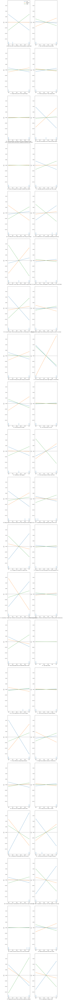

In [408]:
plot_ale(proba_exp_lr, n_cols=2, features=list(range(df.shape[1]-1)),fig_kw={'figwidth': 10, 'figheight': 180});

## Explanation of the model using LIME

We proceed to explain the improved model using LIME for the Low, Medium and High classes.

In [409]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                   feature_names=train_cols, class_names=target_names, 
                                                   discretize_continuous=True)

The first individual present in the test data is explained.

In [410]:
exp = explainer.explain_instance(X_test.to_numpy()[0], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The second individual present in the test data is explained.

In [411]:
exp = explainer.explain_instance(X_test.to_numpy()[1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


The last individual present in the test data is explained.

In [412]:
exp = explainer.explain_instance(X_test.to_numpy()[-1], mlp.predict_proba, num_features=6,top_labels=1) 
exp.show_in_notebook(show_table=True, show_all=False)

X does not have valid feature names, but MLPClassifier was fitted with feature names


## Explanation of the model using SHAP

SHAP explanatory values are displayed according to the class to which the selected individual belongs according to the prediction of the model.

The first individual present in the test data is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

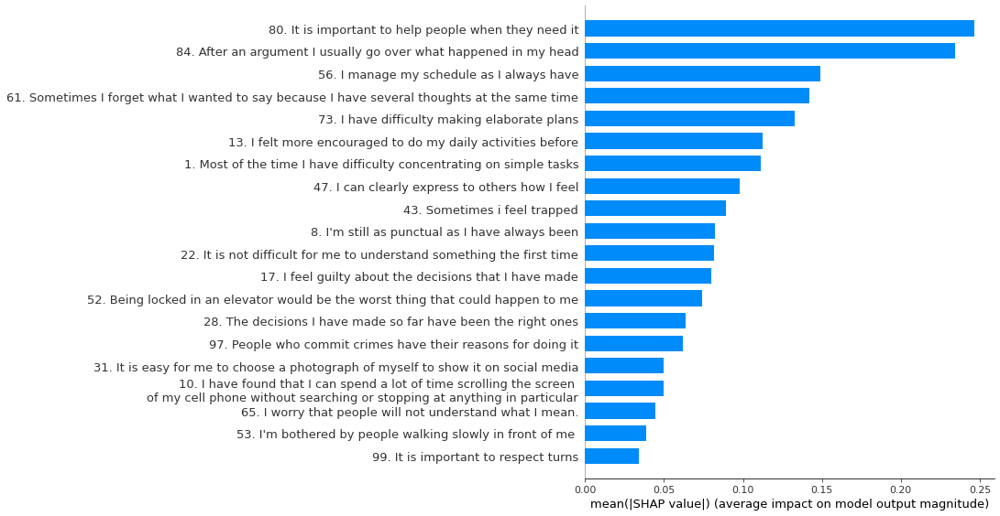

In [413]:
## Individual Selection.
individual = X_test.iloc[[0]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The second individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

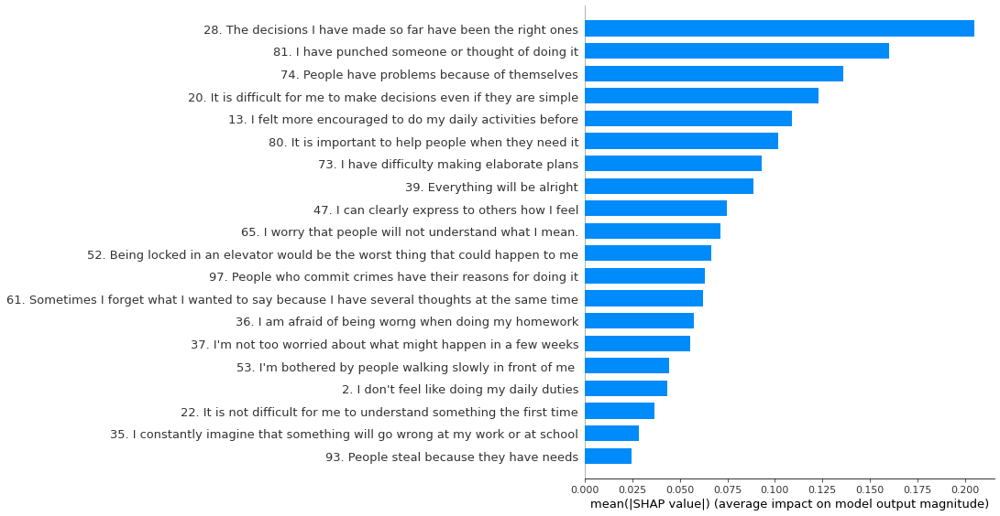

In [414]:
## Individual Selection.
individual = X_test.iloc[[1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

The last individual present in the data test is explained.

X does not have valid feature names, but MLPClassifier was fitted with feature names


  0%|          | 0/1 [00:00<?, ?it/s]

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the 

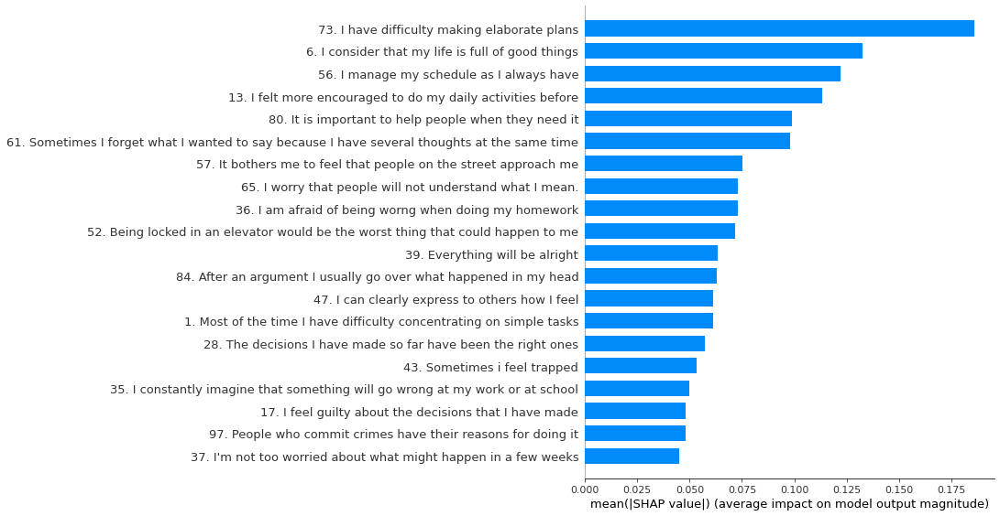

In [415]:
## Individual Selection.
individual = X_test.iloc[[-1]]

## Individual explanation by SHAP.
explainer = shap.KernelExplainer(mlp.predict_proba, X_train,feature_names = train_cols, output_names = target_names)
shap_values = explainer.shap_values(individual)
clase = mlp.predict(individual)[0]
shap.summary_plot(shap_values[clase], individual, feature_names = train_cols, plot_type = "bar")

## Explanation using heatmaps

The importance of the data present in the neural network is shown from explanation methods.

In [416]:
## Questions currently in use are retrieved.
ds_item = ds[ds.Status == "In use"].reset_index(drop=True)

## The data is prepared for the generation of heat maps.
column_Map = ds_item['Question'].tolist()
content_Map = [False for x in range(1, df.shape[1])]

## The next questions to be deleted will be marked.
for index in range(0, len(content_Map)):
    
    if iteration == 0:
        for delete in list_contr:
            if column_Map[index] == delete:
                content_Map [index] = True
    else:
        for delete in question_anomaly:
            if column_Map[index] == delete:
                content_Map [index] = True

## The dataframe is created with the prepared data.
df_mask = pd.DataFrame([content_Map], columns = column_Map)
df_mask_imp = pd.concat([df_mask, df_mask, df_mask], ignore_index = True, axis = 0)
df_mask_all = pd.concat([df_mask, df_mask, df_mask, df_mask], ignore_index = True, axis = 0)

df_mask

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
0,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False


### Identification of important variables

Identification of important variables from the randomness of the answers as questions of the data.

In [417]:
## Loading the data for explainability.
explainer = ClassifierExplainer(mlp, X_test, y_test)

## Class index local variable.
iterable_class = -1
map_class = []

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')


### Explainability of the data belonging to the first class, in this case the Low.

Calculating permutation importances (if slow, try setting n_jobs parameter)...


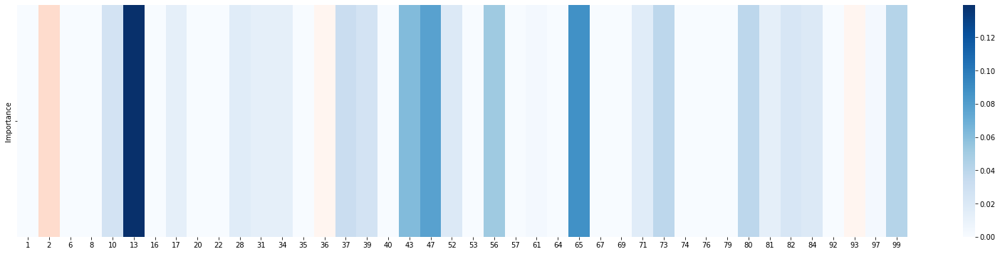

In [418]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

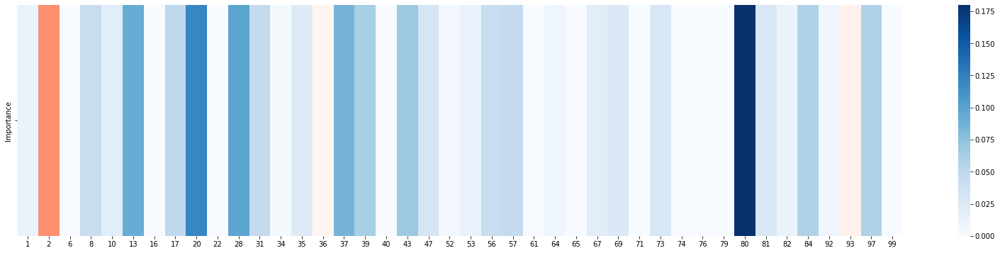

In [419]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

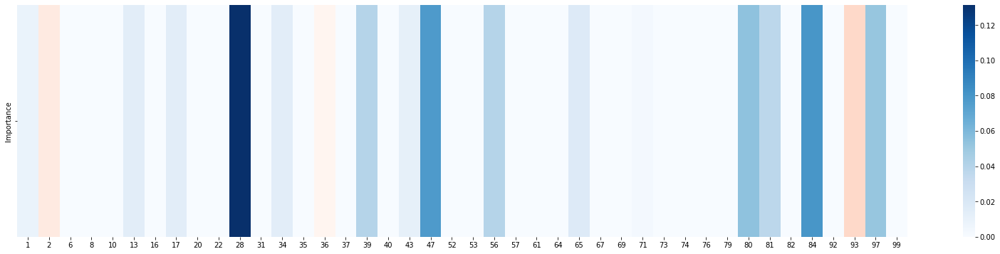

In [420]:
## Definition of explainability data.
iterable_class += 1
df_importance = explainer.permutation_importances(iterable_class).sort_index()
df_importance.index = column_Map
df_importance.drop("Score",inplace=True, axis=1)
df_importance.drop("Feature",inplace=True, axis=1)
df_importance.loc[df_importance['Importance'] < 0, 'Importance'] = 0
map_class.append(df_importance)

## Generation of the heat map.
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

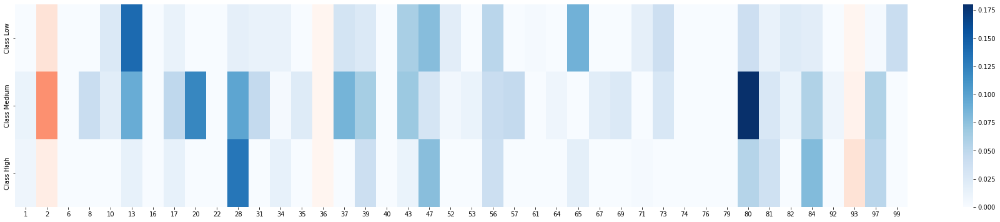

In [421]:
## Fusion of the previous heat maps.
df_importance = pd.concat(map_class, axis=1)
df_importance.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_importance.transpose(), cmap = "Reds", cbar = False)
sns.heatmap(df_importance.transpose(), cmap = "Blues",yticklabels = True, xticklabels = True ,mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using SHAP

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of SHAP.

In [422]:
## Class index local variable.
iterable_class = -1
map_class = []

### Individual explainability of the data belonging to the first class, in this case the Low.

Definition of explainability data.

In [423]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Calculating shap values...


  0%|          | 0/39 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

Generation of the heat map.

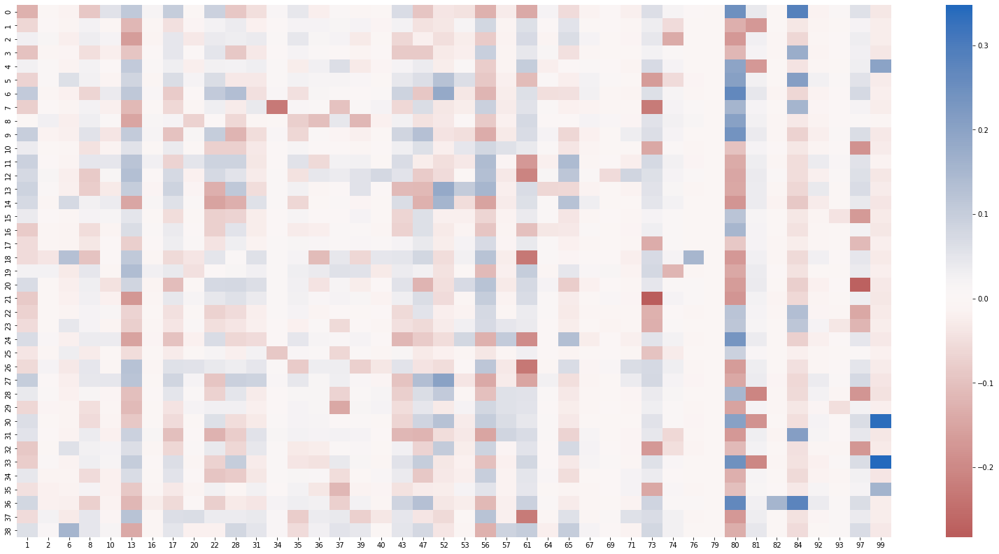

In [424]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [425]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

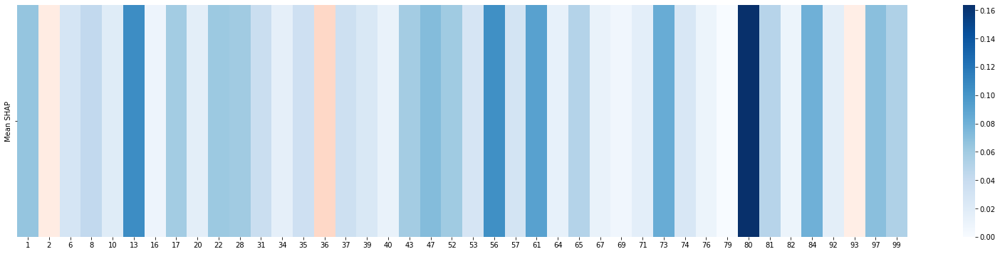

In [426]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Definition of explainability data.

In [427]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

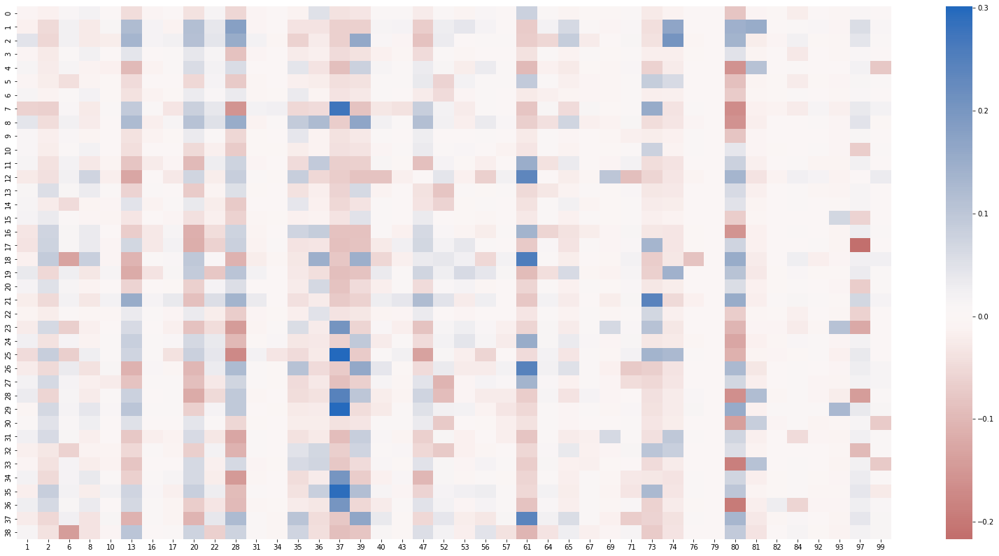

In [428]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [429]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

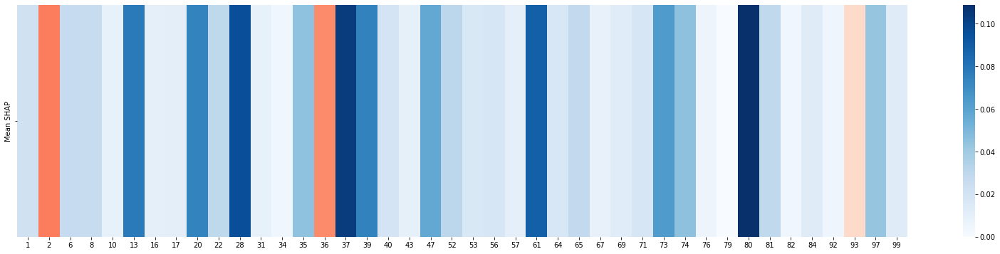

In [430]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Definition of explainability data.

In [431]:
iterable_class += 1
df_shap = explainer.get_shap_values_df(iterable_class)
df_shap.columns = column_Map

Generation of the heat map.

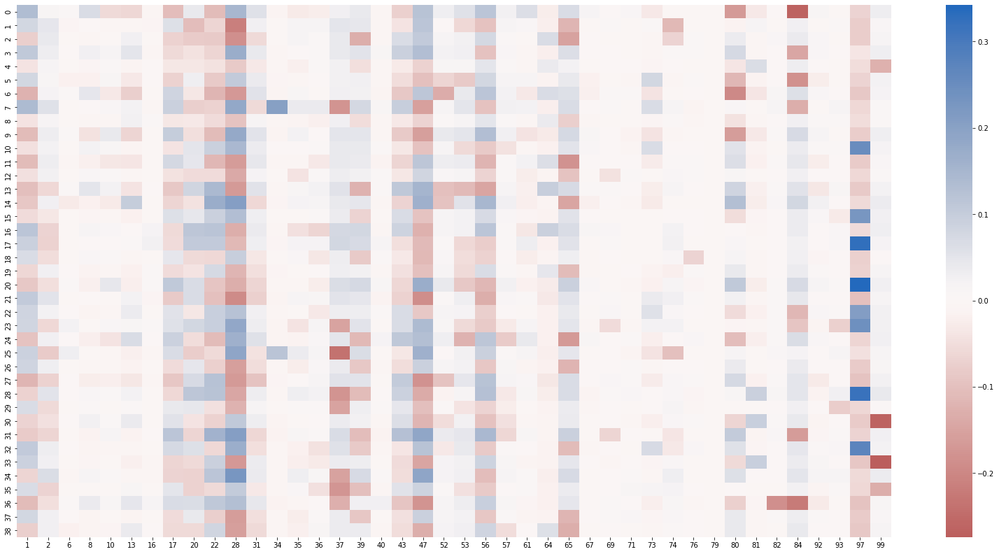

In [432]:
plt.figure(figsize = (28,14))
sns.heatmap(df_shap, cmap="vlag_r", yticklabels=True, xticklabels=True, center=0)
plt.show()

Fusion of the data used.

In [433]:
df_shap_mean = df_shap.abs().mean(axis=0).to_frame()
df_shap_mean.columns= ["Mean SHAP"]
map_class.append(df_shap_mean)

Generation of the heat map.

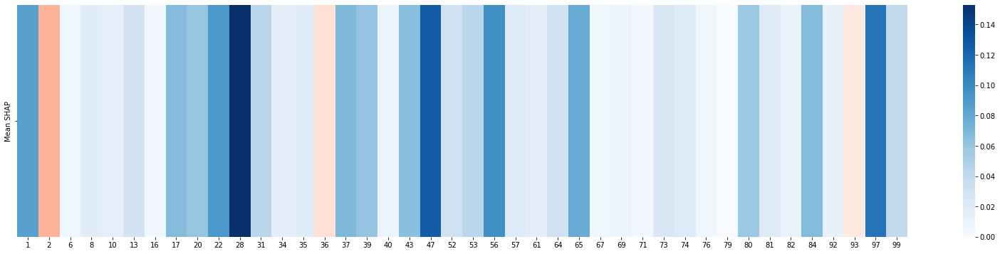

In [434]:
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

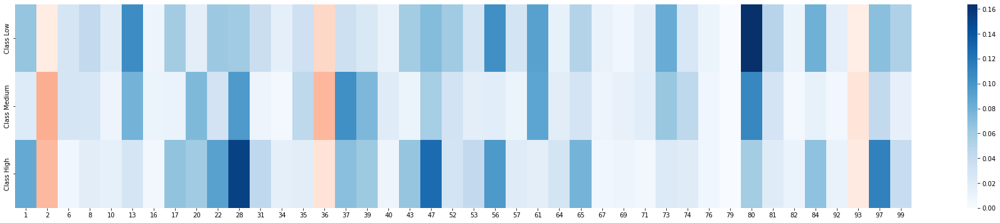

In [435]:
## Fusion of the previous heat maps.
df_shap = pd.concat(map_class, axis=1)
df_shap.columns = name_class

## Generation of the heat map.
plt.figure(figsize = (32,6))
sns.heatmap(df_shap.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_shap.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using LIME

Contribution in the final probability of each question for specific instances at the local level. For each class, a map is first shown with all the individuals and the contribution of each question, and then a map made with the mean of these values in absolute value. This seeks to globalize the scope of LIME.

In [436]:
## Data preparation for explainability.
lime_exp = lime.lime_tabular.LimeTabularExplainer(X_train.to_numpy(), categorical_features=train_cols,
                                                  feature_names=train_cols, class_names=target_names,
                                                  discretize_continuous=True)

## Class index local variable.
iterable_class = -1
map_class = []

Obtaining the data for the generation of the explanations by LIME about the Low, Medium and High classes.

In [437]:
## Local variables for LIME array data.
exp_matrix = [[] for _ in range(len(name_class))]

## Recovering the data needed for LIME.
for x in X_test.to_numpy():
    
    ## Auxiliary temporary variables.
    exp_list = [[] for _ in range(len(name_class))]
    
    ## Loading the data for explainability.
    exp = lime_exp.explain_instance(x, mlp.predict_proba, num_features = df.shape[1] - 1, top_labels = len(name_class))
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
        temp = exp.as_map()[elements]
        temp.sort(key=itemgetter(0))
        
        ## Saving data of the Low, Medium and High classes.
        for tup in temp:
            exp_list[elements].append(tup[1])
            
        exp_matrix[elements].append(exp_list[elements])

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

### Individual explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

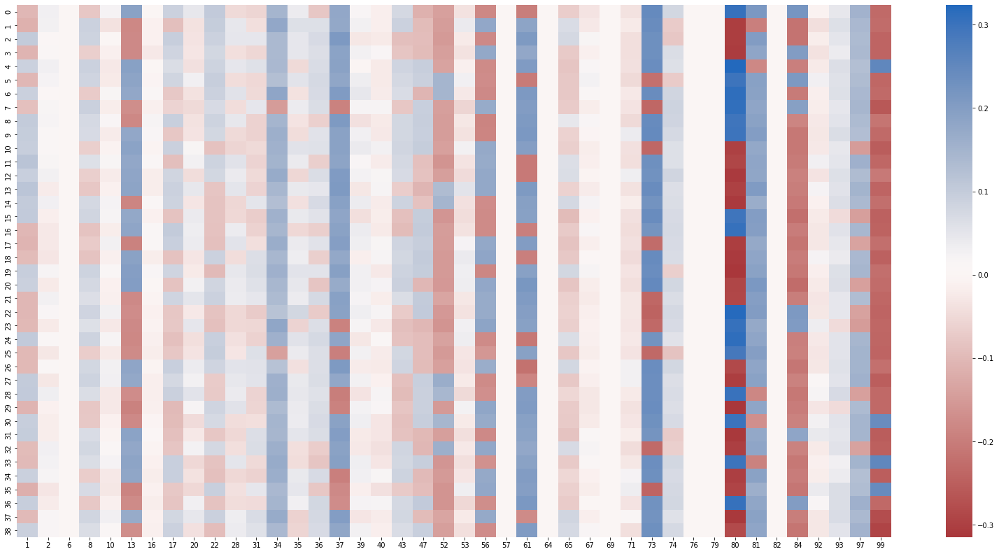

In [438]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

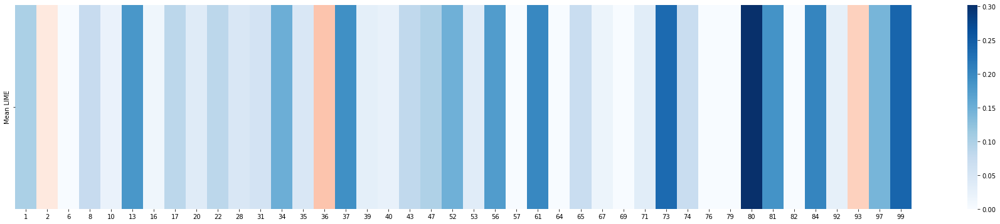

In [439]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

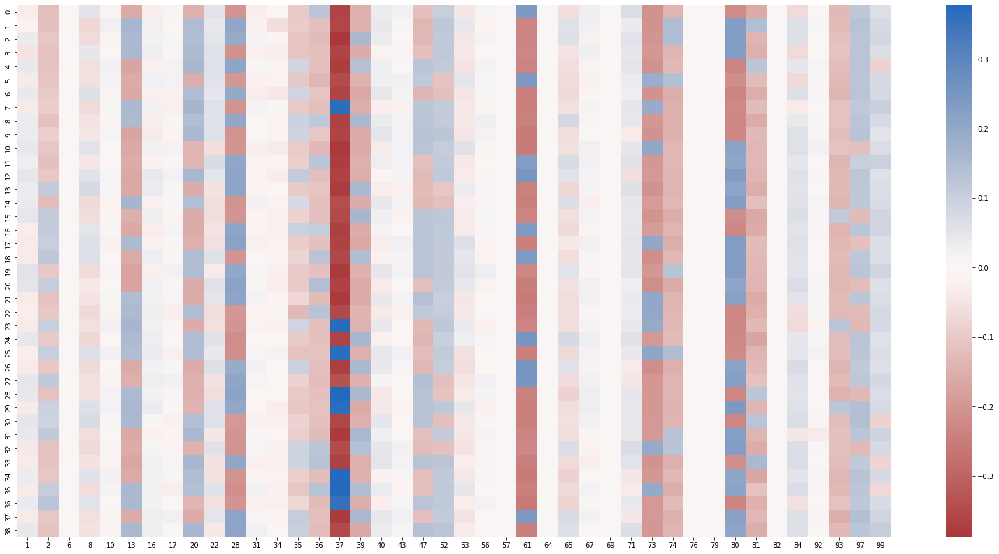

In [440]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

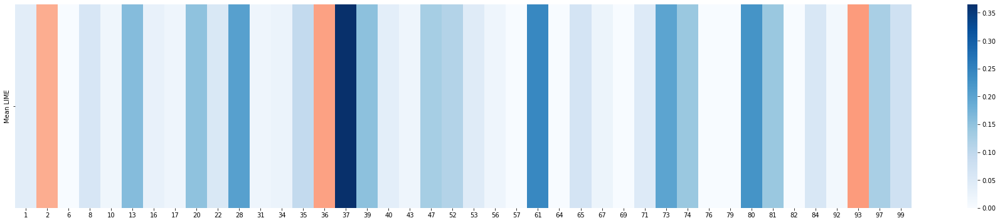

In [441]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

### Individual explainability of data belonging to the third class, in this case High.

Generation of the heat map.

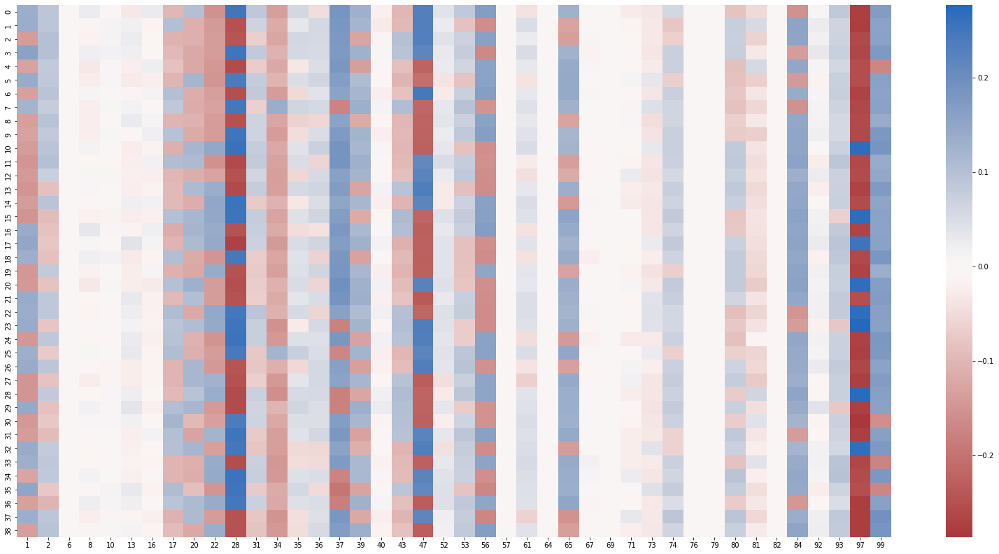

In [442]:
iterable_class += 1
plt.figure(figsize = (28,14))
lime_df = pd.DataFrame(exp_matrix[iterable_class])
lime_df.columns = column_Map
sns.heatmap(lime_df, cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used.

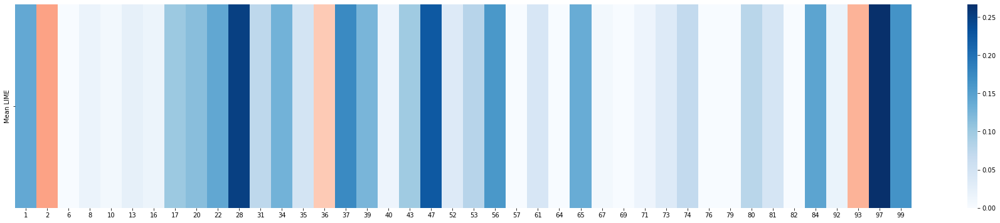

In [443]:
lime_df_mean = lime_df.abs().mean(axis = 0).to_frame()
lime_df_mean.columns= ["Mean LIME"]
map_class.append(lime_df_mean)

plt.figure(figsize = (32,6))
sns.heatmap(map_class[iterable_class].transpose(), cmap="Reds", cbar = False)
sns.heatmap(map_class[iterable_class].transpose(), cmap="Blues", yticklabels = True, xticklabels = True,
            mask = df_mask.to_numpy())
plt.show()

Merging of the all class heatmaps into one map.

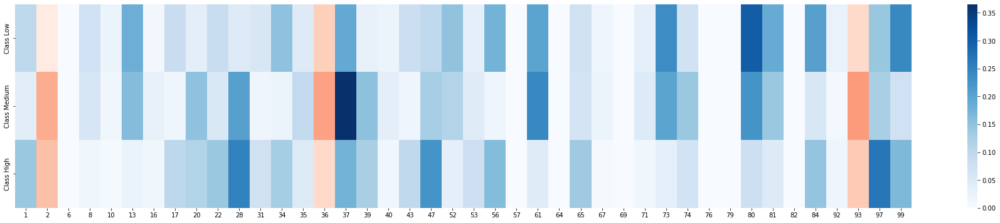

In [444]:
df_lime = pd.concat(map_class, axis=1)
df_lime.columns = name_class
plt.figure(figsize = (32,6))
sns.heatmap(df_lime.transpose(), cmap="Reds", cbar = False)
sns.heatmap(df_lime.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_imp.to_numpy())
plt.show()

### Identification of important variables using ALE

It shows the main effect of each question compared to the probability that the model predicts in each class. This effect is shown for both responses. Since there are only 2 answers, the map is the same but with the colors reversed.

In [445]:
## Definition of explainability data.
proba_fun_lr = mlp.predict_proba
proba_ale_lr = ALE(proba_fun_lr, feature_names=train_cols, target_names= target_names)
proba_exp_lr = proba_ale_lr.explain(X_train.to_numpy())

## Class index local variable.
iterable_class = -1
map_class = []

X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted with feature names
X does not have valid feature names, but MLPClassifier was fitted

Obtaining the data for the generation of the explanations by ALE about the all classes.

In [446]:
## Local variables for ALE array data.
ale_list = [[] for _ in range(len(name_class))]

## Recovering the data needed for ALE.
for array in proba_exp_lr.ale_values:
    
    ## Recovering the data.
    for elements in range(0, len(name_class)):
    
        ## Saving data of the all classes.
        ale_list[elements].append(array[0][elements])

Data processing for the explainability of ALE.

In [447]:
## Data processing of the Low, Medium and High classes.
for elements in range(0, len(name_class)):
    ale_df = pd.DataFrame([ale_list [elements]])
    ale_df = pd.concat([ale_df.multiply(-1), ale_df])
    ale_df.index = [name_class [elements] + " - False", name_class [elements] + " - True"]
    ale_df.columns = column_Map
    map_class.append(ale_df)

### Explainability of the data belonging to the first class, in this case the Low.

Generation of the heat map.

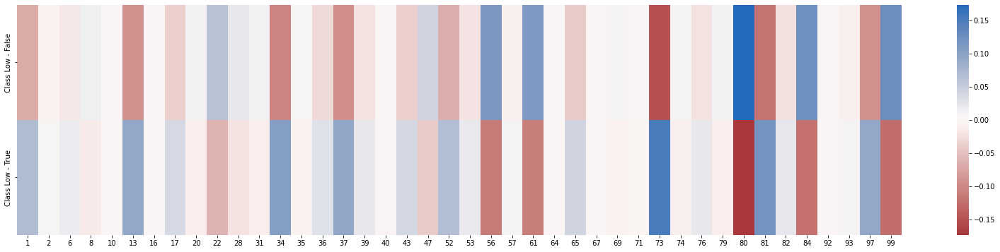

In [448]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the second class, in this case the Medium.

Generation of the heat map.

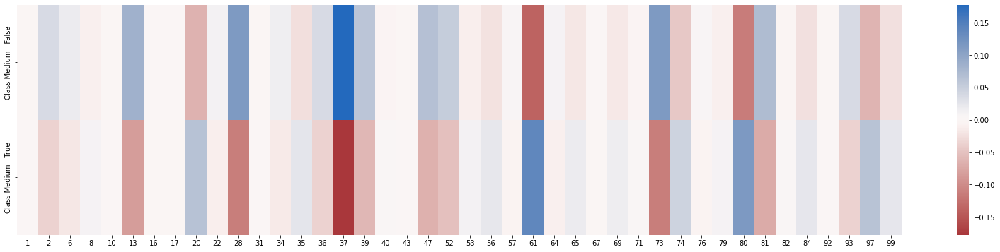

In [449]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

### Explainability of the data belonging to the third class, in this case the High.

Generation of the heat map.

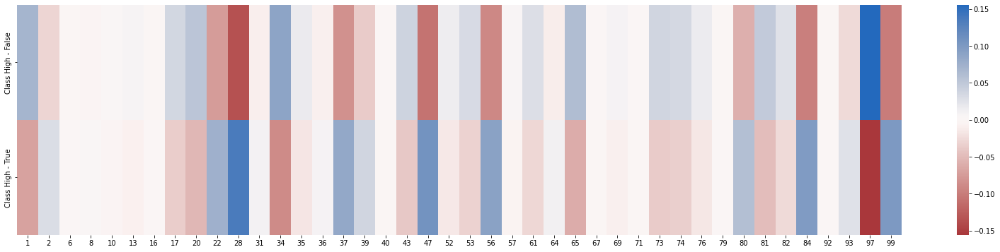

In [450]:
iterable_class += 1
plt.figure(figsize = (28,6))
sns.heatmap(map_class[iterable_class], cmap="vlag_r",yticklabels=True, xticklabels=True)
plt.show()

Fusion of the data used in all classes.

In [451]:
## Application of absolute value to data.
for index in range(0, len(map_class)):
    map_class [index] = map_class [index][0:1].abs()

## Union of the heat maps of the Low, Medium and High class.
ale_df = pd.concat(map_class)
ale_df.index = name_class
ale_df = ale_df.transpose()

Generation of the heat map.

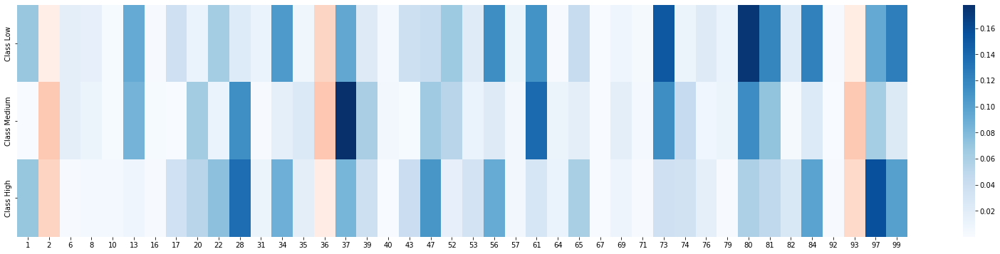

In [452]:
plt.figure(figsize = (28,6))
sns.heatmap(ale_df.transpose(), cmap="Reds", cbar = False)
sns.heatmap(ale_df.transpose(), cmap="Blues", yticklabels = True, xticklabels = True, mask= df_mask_imp.to_numpy())
plt.show()

## Comparing of Important Variables Methods for Explainability

The global values of each of the methods used are taken, their maximums are obtained (the minimums are 0) and a percentage is calculated based on said maximum, which indicates how relevant the contribution is for each question.

In [453]:
## Class index local variable.
iterable_class = -1

### Comparison of the explanation methods of the first class, in this case the Low.

The highest data of each method used is obtained.

In [454]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [455]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
Importance,0.000000,13.953488,0.000000,0.000000,18.604651,100.000000,0.000000,9.302326,0.000000,0.000000,...,0.000000,0.000000,27.906977,9.302326,16.279070,13.953488,0.000000,0.000000,2.325581,30.232558
LIME,33.270074,7.093782,0.000000,24.991642,6.695682,60.202982,4.093528,28.142957,12.234096,28.352631,...,0.000000,0.000000,100.000000,62.079677,0.000000,67.512403,8.647985,17.762347,47.000147,79.429587
SHAP,39.686885,5.737685,17.531298,26.210309,12.006029,64.239285,5.167823,36.123220,10.286206,37.923145,...,5.497511,0.000000,100.000000,29.718955,5.472459,49.148290,10.313934,4.482257,42.571524,32.327464
ALE,39.857023,4.149958,10.201832,8.736596,0.979009,53.202363,0.431892,21.243200,6.763605,36.493760,...,13.174312,6.473271,100.000000,68.993240,13.591306,70.752285,0.792622,5.904648,53.421181,71.914449


Generation of the heat map.

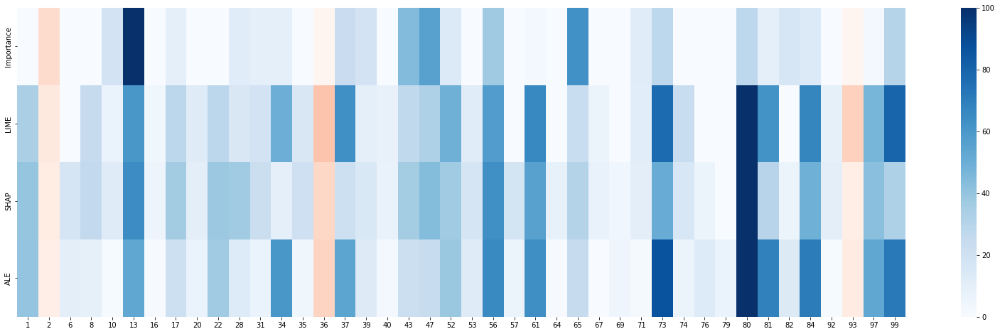

In [456]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the second class, in this case the Medium.

The highest data of each method used is obtained.

In [457]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [458]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
Importance,6.349206,38.095238,0.000000,23.809524,11.111111,50.793651,0.000000,26.984127,66.666667,0.000000,...,0.000000,0.000000,100.000000,15.873016,6.349206,31.746032,4.761905,1.587302,31.746032,0.000000
LIME,10.774993,29.594261,0.000000,16.398921,3.941186,43.533318,7.594973,4.638809,41.280497,15.030989,...,0.000000,0.000000,61.427876,38.565063,0.000000,16.008679,2.680480,34.848139,34.071159,20.546780
SHAP,19.893428,43.807883,25.362592,24.585135,7.894789,71.870622,9.329613,10.399590,68.137722,27.704935,...,5.344838,0.000000,100.000000,26.839640,3.527107,12.123963,5.037732,14.521300,39.686233,12.364700
ALE,0.266410,20.629580,10.497333,6.009730,1.165075,47.442615,0.838935,0.380057,36.236800,6.313512,...,3.745224,5.730093,64.447343,40.410826,1.755490,13.833434,0.218438,20.607205,35.524063,13.652323


Generation of the heat map.

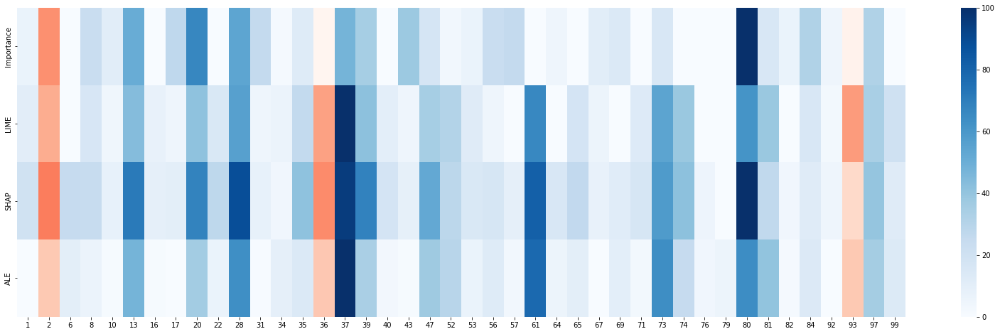

In [459]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

### Comparison of the explanation methods of the third class, in this case the High.

The highest data of each method used is obtained.

In [460]:
## The maximum present value is obtained in each explainability method.
iterable_class += 1
max_importance = df_importance[name_class[iterable_class]].max()
max_shap = df_shap[name_class[iterable_class]].max()
max_lime = df_lime[name_class[iterable_class]].max()
max_ale  = ale_df[name_class[iterable_class]].max()

A new heat map is created containing all the values of each method used.

In [461]:
## The values are calculated to plot the new heat map.
df_general = pd.DataFrame([df_importance[name_class[iterable_class]].multiply(100/max_importance), 
                            df_lime[name_class[iterable_class]].multiply(100/max_lime),  
                            df_shap[name_class[iterable_class]].multiply(100/max_shap),
                            ale_df[name_class[iterable_class]].multiply(100/max_ale)])

## Method names are assigned.
df_general.index = name_methods
df_general

,1,2,6,8,10,13,16,17,20,22,...,76,79,80,81,82,84,92,93,97,99
Importance,6.521739,6.521739,0.000000,0.000000,0.000000,10.869565,0.000000,10.869565,0.000000,0.000000,...,0.000000,0.000000,41.304348,28.260870,0.000000,60.869565,0.000000,15.217391,39.130435,0.000000
LIME,52.502300,32.508968,0.000000,5.874175,2.636449,8.628462,5.798226,38.278027,42.693036,52.756981,...,0.000000,0.000000,29.246054,17.565451,0.000000,54.638111,6.347591,27.607908,100.000000,61.936297
SHAP,55.629985,27.459348,3.771836,11.398621,9.497523,18.514641,3.347451,43.637701,39.442781,59.512246,...,4.096159,0.000000,38.065049,12.740613,6.924774,43.995928,7.724495,6.876222,73.778339,25.831998
ALE,44.683439,18.908312,0.613353,2.873509,2.418929,5.128317,0.475953,23.220182,33.798985,47.835599,...,10.397564,0.672306,37.841243,30.731120,17.135739,63.002732,0.633420,16.928998,100.000000,64.503334


Generation of the heat map.

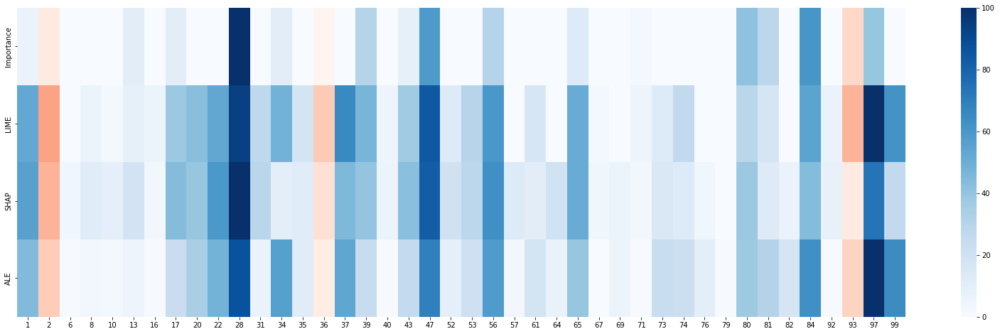

In [462]:
plt.figure(figsize = (28,8))
sns.heatmap(df_general, cmap="Reds", cbar = False)
sns.heatmap(df_general, cmap="Blues", yticklabels = True, xticklabels = True, mask = df_mask_all.to_numpy())
plt.show()

Safeguarding the questions eliminated during this iteration.

In [463]:
## Removal of anomalous questions selected by selection_mode.
for x in question_anomaly:

    ## Status change of the deleted question in the respective auxiliary dataset.
    ds.loc[x - 1,'Status'] = 'Delete'

## Save the changed statuses in the dataset.
ds.to_csv(path_dataset_qs, index = False)

## Generation of final graphs from the results obtained by the improvement process

Different graphs are generated with the aim of clearly illustrating the data obtained from the model improvement process.

In [464]:
## Loading data from the dataset.
df = pd.read_csv(path_dataset)
dd = pd.read_csv(path_dataset_qd)

## Eliminating physical-related questions in dataset.
df = df.drop(df.columns[102:-1], axis=1)

All the data necessary to generate the graphs are obtained.

In [465]:
## Local variables for graph generation.
total_question = []
global_accuracy = []
total_delete = []
recall_low = []
recall_medium = []
recall_high = []
labels_plot = []

## Get the total number of iterations.
iterations = list(map(str, list(range(1, (dd.shape[0] + 1)))))

## Obtaining data from the dataset.
for x in range(dd.shape[0]):
    
    ## The total number of questions used in each iteration is obtained.
    total_question.append((df.shape[1] - 1) - len((dd.loc[x, 'Question']).split(',')))
    
    ## The global acurracy of each iteration is obtained.
    global_accuracy.append((dd.loc[x, 'Acurracy global']) / 100)
    
    ## The total number of questions eliminated in each iteration is obtained.
    if x == 0:
        total_delete.append(len((dd.loc[x, 'Question']).split(',')))
    else:
        total_delete.append(len((dd.loc[x, 'Question']).split(',')) - len((dd.loc[x - 1, 'Question']).split(',')))
    
    ## The recall of the Low, Medium and High classes of each iteration is obtained.
    recall_low.append((dd.loc[x, 'Recall_0']))
    recall_medium.append((dd.loc[x, 'Recall_1']))
    recall_high.append((dd.loc[x, 'Recall_2']))
    
for target in target_names:
    labels_plot.append(target + " Class")

Generation of the graph of questions used in each iteration.

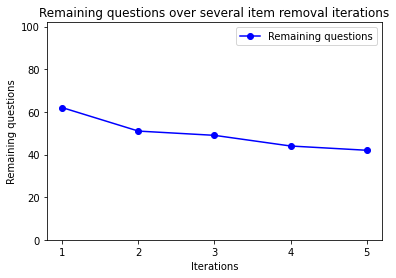

In [466]:
## Generation of the graph according to the data obtained.
plt.figure()
labels = ['Remaining questions']
plt.title('Remaining questions over several item removal iterations')
plt.plot(iterations, total_question, marker= 'o', color = 'blue')
plt.ylabel("Remaining questions")
plt.xlabel("Iterations")
plt.ylim(0, df.shape[1] - 1)
plt.legend(labels)
plt.show()

Generation of the graph of the acurracy obtained in each iteration.

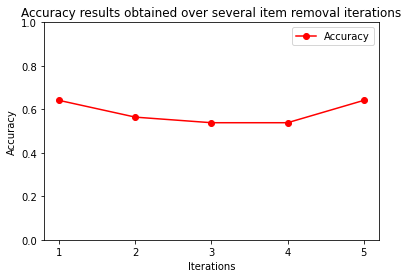

In [467]:
## Generation of the graph according to the data obtained.
plt.figure()
labels=['Accuracy']
plt.title('Accuracy results obtained over several item removal iterations')
plt.plot(iterations, global_accuracy, marker= 'o', color = 'red')
plt.ylabel("Accuracy")
plt.xlabel("Iterations")
plt.ylim(0, 1)
plt.legend(labels)
plt.show()

Generation of the graph of questions eliminated in each iteration.

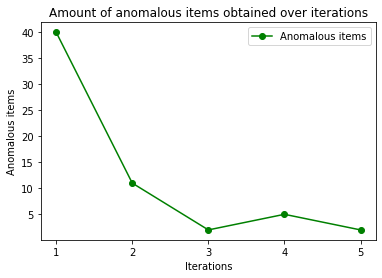

In [468]:
## Generation of the graph according to the data obtained.
plt.figure()
labels=['Anomalous items']
plt.title('Amount of anomalous items obtained over iterations')
plt.plot(iterations, total_delete, marker= 'o', color = 'green')
plt.xlabel("Iterations")
plt.ylabel("Anomalous items")
plt.legend(labels)
plt.show()

The graph is generated with the merger of the acurracy with the anomadic questions eliminated.

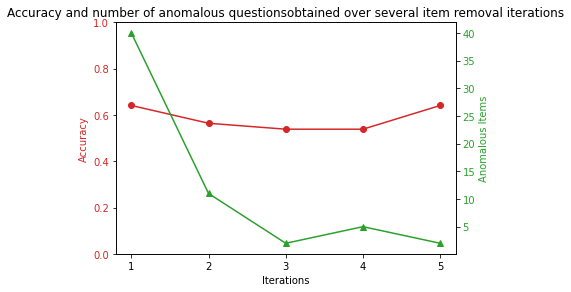

In [469]:
## Generation of the graph according to the data obtained.
fig, ax = plt.subplots()

ax.set_xlabel('Iterations')
ax.set_ylabel('Accuracy', color = 'tab:red')
ax.plot(iterations, global_accuracy, marker= 'o', color= 'tab:red')
ax.tick_params(axis='y', labelcolor= 'tab:red')

plt.ylim(0, 1)
ax = ax.twinx()  

ax.set_ylabel('Anomalous Items', color= 'tab:green')  
ax.plot(iterations, total_delete, marker= '^', color= 'tab:green')
ax.tick_params(axis='y', labelcolor= 'tab:green')

fig.tight_layout()
plt.title('Accuracy and number of anomalous questions' +
          'obtained over several item removal iterations')
plt.xticks(range(0, iteration, 1))
plt.show()

The graph is generated with the fusion of the recall obtained in the improvement process.

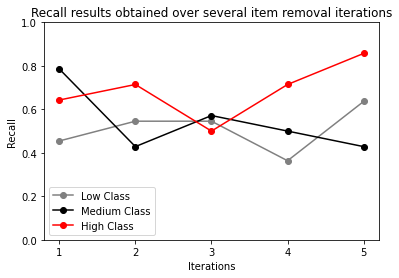

In [470]:
## Generation of the graph according to the data obtained.
plt.figure()
plt.title('Recall results obtained over several item removal iterations')
plt.plot(iterations, recall_low, marker= 'o', color = 'gray')
plt.plot(iterations, recall_medium, marker= 'o', color = 'black')
plt.plot(iterations, recall_high, marker= 'o', color = 'red')
plt.xlabel("Iterations")
plt.ylabel("Recall")
plt.ylim(0, 1)
plt.legend(labels_plot)
plt.show()

The graph is generated with the fusion of the recall and the eliminated questions obtained in the improvement process.

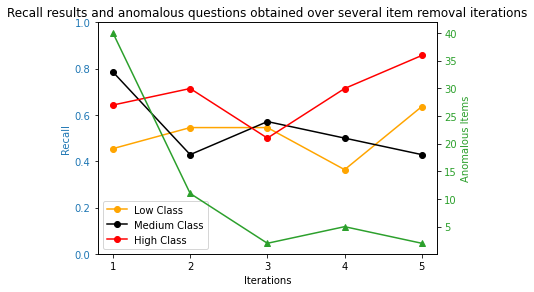

In [471]:
## Generation of the graph according to the data obtained.
fig, ax = plt.subplots()

ax.set_xlabel('Iterations')
ax.set_ylabel('Recall', color= 'tab:blue')
ax.plot(iterations, recall_low, marker= 'o', color = 'orange')
ax.plot(iterations, recall_medium, marker= 'o', color = 'black')
ax.plot(iterations, recall_high, marker= 'o', color = 'red')
ax.tick_params(axis='y', labelcolor= 'tab:blue')

plt.ylim(0, 1)
plt.legend(labels_plot)
ax = ax.twinx()

ax.set_ylabel('Anomalous Items', color = 'tab:green')  
ax.plot(iterations, total_delete, marker= '^', color = 'tab:green')
ax.tick_params(axis='y', labelcolor = 'tab:green')

fig.tight_layout()
plt.title('Recall results and anomalous questions obtained ' +
          'over several item removal iterations')
plt.xticks(range(0, iteration, 1))
plt.show()